<a href="https://colab.research.google.com/github/marciosferreira/variational_auto_encoder/blob/main/rotate_images_dbscan.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Variational autoencoder and its extensions


---

This notebook demonstrates application of different variational autoencoders (VAEs) to rotated images. Specifically, we discuss rotationally invariant version of VAE (rVAE) and class-conditioned VAE and rVAE.

Prepared by Maxim Ziatdinov  (Feb 2021)

E-mail: maxim.ziatdinov@ai4microscopy.com

---



## Installation/Imports/Utility functions

*Make sure to click "Play" button for the next 4 cells ("Installation and Imports", "Load neural networks for VAE", etc.) to load all the necessary modules and functions!*

#@title Installation and Imports


In [745]:
#@title Installation and Imports

!pip install -qq pyro-ppl

from typing import Optional, Tuple, Type, Union

import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pyro
import pyro.distributions as dist
import pyro.infer as infer
import pyro.optim as optim
import torch
import torch.nn as nn
from torch import Tensor as tt
from scipy.stats import norm
from torchvision import datasets, transforms
from torchvision.utils import make_grid

import warnings
warnings.filterwarnings("ignore", module="torchvision.datasets")

from torchvision.transforms import ToPILImage


In [746]:
#@title Load functions for working with image coordinates and labels { form-width: "25%" }

def to_onehot(idx: torch.Tensor, n: int) -> torch.Tensor:


    """
    One-hot encoding of a label
    """
    #print("onehot")
    #print(idx)
    if torch.max(idx).item() >= n:
        raise AssertionError(
            "Labelling must start from 0 and "
            "maximum label value must be less than total number of classes")
    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    if idx.dim() == 1:
        idx = idx.unsqueeze(1).long()
    onehot = torch.zeros(idx.size(0), n, device=device)
    #return onehot.scatter_(1, idx.to(device), 1)
    return onehot.scatter_(1, idx.long().to(device), 1)



def grid2xy(X1: torch.Tensor, X2: torch.Tensor) -> torch.Tensor:
    X = torch.cat((X1[None], X2[None]), 0)
    d0, d1 = X.shape[0], X.shape[1] * X.shape[2]
    X = X.reshape(d0, d1).T
    return X


def imcoordgrid(im_dim: Tuple) -> torch.Tensor:
    xx = torch.linspace(-1, 1, im_dim[0])
    yy = torch.linspace(1, -1, im_dim[1])
    x0, x1 = torch.meshgrid(xx, yy)
    return grid2xy(x0, x1)


def transform_coordinates(coord: torch.Tensor,
                          phi: Union[torch.Tensor, float] = 0,
                          coord_dx: Union[torch.Tensor, float] = 0,
                          ) -> torch.Tensor:

    if torch.sum(phi) == 0:
        phi = coord.new_zeros(coord.shape[0])
    rotmat_r1 = torch.stack([torch.cos(phi), torch.sin(phi)], 1)
    rotmat_r2 = torch.stack([-torch.sin(phi), torch.cos(phi)], 1)
    rotmat = torch.stack([rotmat_r1, rotmat_r2], axis=1)
    coord = torch.bmm(coord, rotmat)




    return coord + coord_dx

In [747]:
#@title Load neural networks for VAE { form-width: "25%" }

def set_deterministic_mode(seed: int) -> None:
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.empty_cache()
        torch.cuda.manual_seed_all(seed)
        torch.backends.cudnn.deterministic = True
        torch.backends.cudnn.benchmark = False


def make_fc_layers(in_dim: int,
                   hidden_dim: int = 128,
                   num_layers: int = 2,
                   activation: str = "lrelu"
                   ) -> Type[nn.Module]:
    """
    Generates a module with stacked fully-connected (aka dense) layers
    """
    in_dim=int(in_dim)


    activations = {
    "tanh": nn.Tanh,
    "lrelu": nn.LeakyReLU,
    "softplus": nn.Softplus,
    "linear": nn.Identity
}


    fc_layers = []

    for i in range(num_layers):
        hidden_dim_ = in_dim if i == 0 else hidden_dim
        fc_layers.extend(
            [nn.Linear(hidden_dim_, hidden_dim),
            activations[activation]()])


    fc_layers = nn.Sequential(*fc_layers)
    return fc_layers


class fcEncoderNet(nn.Module):
    """
    Simple fully-connected inference (encoder) network
    """
    def __init__(self,
                 in_dim: Tuple[int],
                 latent_dim: int = 2,
                 hidden_dim:int = 128,
                 num_layers: int = 2,
                 activation: str = 'tanh',
                 softplus_out: bool = False
                 ) -> None:
        """
        Initializes module parameters
        """

        super(fcEncoderNet, self).__init__()


        if len(in_dim) not in [1, 2, 3]:
            raise ValueError("in_dim must be (h, w), (h, w, c), or (h*w*c,)")
        self.in_dim = torch.prod(tt(in_dim)).item()



        self.fc_layers = make_fc_layers(
        self.in_dim, hidden_dim, num_layers, activation)
        self.fc11 = nn.Linear(hidden_dim, latent_dim)
        self.fc12 = nn.Linear(hidden_dim, latent_dim)
        self.activation_out = nn.Softplus() if softplus_out else lambda x: x

    def forward(self, x: torch.Tensor) -> Tuple[torch.Tensor]:
        """
        Forward pass
        """

        x = x.view(-1, int(self.in_dim))



        x = self.fc_layers(x)
        mu = self.fc11(x)
        log_sigma = self.activation_out(self.fc12(x))
        return mu, log_sigma


class fcDecoderNet(nn.Module):
    """
    Standard decoder for VAE
    """
    def __init__(self,
                 out_dim: Tuple[int],
                 latent_dim: int = 2,   #change here
                 hidden_dim:int = 128,
                 num_layers: int = 2,
                 activation: str = 'lrelu',
                 sigmoid_out: str = True,
                 ) -> None:
        super(fcDecoderNet, self).__init__()
        if len(out_dim) not in [1, 2, 3]:
            raise ValueError("in_dim must be (h, w), (h, w, c), or (h*w*c,)")


        self.reshape = out_dim
        out_dim = torch.prod(tt(out_dim)).item()
        self.fc_layers = make_fc_layers(
            latent_dim, hidden_dim, num_layers, activation)


        out_dim = int(out_dim)


        self.out = nn.Linear(hidden_dim, out_dim)

        self.activation_out = nn.Sigmoid() if sigmoid_out else lambda x: x

    def forward(self, z: torch.Tensor) -> torch.Tensor:
        x = self.fc_layers(z)
        x = self.activation_out(self.out(x))
        return x.view(-1, *self.reshape)


class rDecoderNet(nn.Module):
    """
    Spatial generator (decoder) network with fully-connected layers
    """
    def __init__(self,
                 out_dim: Tuple[int],
                 latent_dim: int,
                 hidden_dim:int = 2,
                 num_layers: int = 2,
                 activation: str = 'lrelu',
                 sigmoid_out: str = True
                 ) -> None:
        """
        Initializes module parameters
        """

        super(rDecoderNet, self).__init__()
        if len(out_dim) not in [1, 2, 3]:
            raise ValueError("in_dim must be (h, w), (h, w, c), or (h*w*c,)")
        self.reshape = out_dim
        out_dim = torch.prod(tt(out_dim)).item()

        self.coord_latent = coord_latent(latent_dim, hidden_dim)
        self.fc_layers = make_fc_layers(
            hidden_dim, hidden_dim, num_layers, activation)

        self.out = nn.Linear(hidden_dim, 1) # need to generalize to multi-channel (c > 1)
        self.activation_out = nn.Sigmoid() if sigmoid_out else lambda x: x

    def forward(self, x_coord: torch.Tensor, z: torch.Tensor) -> torch.Tensor:
        """
        Forward pass
        """
        x = self.coord_latent(x_coord, z)
        x = self.fc_layers(x)
        x = self.activation_out(self.out(x))
        return x.view(-1, *self.reshape)


class coord_latent(nn.Module):
    """
    The "spatial" part of the rVAE's decoder that allows for translational
    and rotational invariance (based on https://arxiv.org/abs/1909.11663)
    """
    def __init__(self,
                 latent_dim: int,
                 out_dim: int,
                 activation_out: bool = True) -> None:
        """
        Iniitalizes modules parameters
        """
        super(coord_latent, self).__init__()
        self.fc_coord = nn.Linear(2, out_dim)
        print("the latent dim")
        print(latent_dim)
        self.fc_latent = nn.Linear(latent_dim, out_dim, bias=False)
        self.activation = nn.Tanh() if activation_out else None

    def forward(self,
                x_coord: torch.Tensor,
                z: torch.Tensor) -> torch.Tensor:
        """
        Forward pass
        """
        batch_dim, n = x_coord.size()[:2]
        x_coord = x_coord.reshape(batch_dim * n, -1)
        h_x = self.fc_coord(x_coord)
        h_x = h_x.reshape(batch_dim, n, -1)
        h_z = self.fc_latent(z)
        h = h_x.add(h_z.unsqueeze(1))
        h = h.reshape(batch_dim * n, -1)
        if self.activation is not None:
            h = self.activation(h)
        return h

In [748]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Get training data

In [749]:

!unzip -n /content/drive/My\ Drive/embryos_for_encoder.zip -d /content/



Archive:  /content/drive/My Drive/embryos_for_encoder.zip


Get rotated MNIST data and pass it to dataloader that will be used for (r)VAE training:

Plot samples from the rotated MNIST dataset:

In [750]:
import os
import re
import torch
from PIL import Image

# 1. Percorrer os arquivos .jpg de uma pasta e adicionar os nomes em uma lista
folder_path = '/content/embryos_for_encoder'  # Substitua pelo caminho da sua pasta
file_list = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.endswith('.jpg')]

# Mapeamento dos valores
#temp_mapping = {"21": 0, "28": 1, "35": 2}

# 2. Percorrer a lista de nomes e extrair a informação desejada
#pattern = re.compile(r'_(\d{2})C_')
#temperature_list = [temp_mapping[pattern.search(filename).group(1)] for filename in file_list if pattern.search(filename)]


# 3. Abrir cada imagem, convertê-la para escala de cinza, redimensioná-la para 56x56 e adicionar a uma lista
image_list = [Image.open(filename).convert('L').resize((28, 28)) for filename in file_list]    #28x28

# 4. Converter as listas resultantes em tensores do PyTorch
tensor_images = torch.stack([torch.tensor(np.array(img)) for img in image_list])
#tensor_temperatures = torch.tensor([int(temp) for temp in temperature_list])

print(tensor_images.shape)  # Deve ser algo como [número_de_imagens, 28, 28]
#print(tensor_temperatures.shape)  # Deve ser algo como [número_de_imagens]


torch.Size([2808, 28, 28])


In [751]:
#import pandas as pd
#/content/embryos_for_encoder/210614110923_OlE_HR_IPF2_BQ_2x_21C_medaka_bpm_out_v1.4_LOOP1_01.jpg

In [752]:
#df_final = pd.read_csv("/content/full_data_autoencoder.csv")

In [753]:
#df_final.loc[df_final["experiment_id"] == "210614110923_OlE_HR_IPF2_BQ_2x_21C"]

In [754]:
import os
import pandas as pd
import torch

# Carrega o DataFrame (assumindo que você já tenha isso)
df = pd.read_csv('/content/drive/My Drive/full_data_autoencoder.csv')

# Local da pasta que contém os arquivos
diretorio = '/content/embryos_for_encoder'

# Lista para armazenar os tensores
lista_tensores = []

for nome_arquivo in os.listdir(diretorio):
    if nome_arquivo.endswith('.jpg'):
        # Extrai as partes do nome do arquivo
        partes = nome_arquivo.split('_')

        experiment_id = '_'.join(partes[:partes.index('medaka')])

        if "LOOP1" in nome_arquivo:
            loop = "LO001"
        elif "LOOP2" in nome_arquivo:
            loop = "LO002"
        else:
            print(f"Arquivo {nome_arquivo} não tem LOOP1 ou LOOP2")
            continue

        well_id = "WE000" + nome_arquivo.split('_')[-1].split('.')[0].zfill(2)

        # Filtre o DataFrame
        filtro = (df['experiment_id'] == experiment_id) & (df['Loop'] == loop) & (df['WellID'] == well_id)

        linha_correspondente = df[filtro]

        # Crie um tensor PyTorch com o valor de "Heart size" e adicione-o à lista
        if not linha_correspondente.empty:
            valor = linha_correspondente['Heart size'].iloc[0]
            tensor = torch.tensor([valor])
            lista_tensores.append(tensor)
        else:
            print(f"Nenhuma linha correspondente encontrada para o arquivo {nome_arquivo}")

# Se você quiser criar um tensor único a partir da lista de tensores:
tensor_final = torch.cat(lista_tensores)
print(tensor_final)



tensor([10184.,  5224.,  7897.,  ...,   967.,  4067.,  2135.],
       dtype=torch.float64)


In [755]:
#import torch



# Defina os limites para as categorias
# Supondo que os valores vão de 0 a 5, e você quer dividi-los em 5 classes
limites = torch.tensor([2500, 5000, 7500, 10000, 15000])

# Use torch.bucketize para categorizar os valores
#categorias = torch.bucketize(tensor_final, limites)
categorias = tensor_final.clamp(max=10000)

categorias[torch.isnan(categorias)] = 0


# Transformar NaNs em 0 e todos os outros valores em 1
#categorias = torch.where(torch.isnan(categorias), torch.tensor(0.0), torch.tensor(1.0))

print(categorias)


tensor([10000.,  5224.,  7897.,  ...,   967.,  4067.,  2135.],
       dtype=torch.float64)


#Above, categoria means  the size of the heart


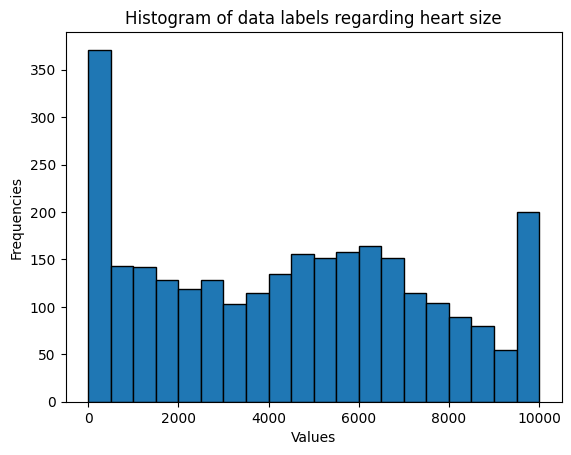

In [756]:
# Converta o tensor para numpy para plotagem
data_numpy = categorias.numpy()

# Plote o histograma
plt.hist(data_numpy, bins=20, edgecolor='black')  # você pode ajustar o número de bins conforme necessário
plt.title('Histogram of data labels regarding heart size')
plt.xlabel('Values')
plt.ylabel('Frequencies')
plt.show()

In [757]:
import torch

images_per_class = 10

def create_image_array(original_images):
    """
    Esta função seleciona as 4 primeiras imagens de um tensor de imagens e cria um novo tensor
    com 250 cópias de cada uma dessas imagens, totalizando 1000 imagens.

    :param original_images: Tensor de imagens (onde cada imagem é representada por um sub-tensor)
    :return: Novo tensor com 1000 imagens, sendo 250 cópias de cada uma das 4 primeiras imagens do tensor original,
             e um tensor de índices indicando a origem de cada imagem.
    """
    # Verifica se o tensor original_images não está vazio e tem pelo menos 4 imagens
    if original_images.size(0) < 10:
        raise ValueError("O tensor de imagens original deve conter pelo menos 4 imagens.")

    first_images = original_images[:100]

    new_images = torch.cat([img.unsqueeze(0).repeat(images_per_class, 1, 1) for img in first_images], dim=0)

    # Cria um tensor de índices que representa as classes
    num_classes = new_images.size(0) // images_per_class
    indices = torch.arange(num_classes).repeat_interleave(images_per_class)

    return new_images, indices

new_images, indices = create_image_array(tensor_images) # commented just for tests

#new_images = tensor_images # just for test

In [758]:
new_images.shape


torch.Size([1000, 28, 28])

In [759]:
indices

tensor([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  1,  1,  1,  1,  1,  1,  1,
         1,  1,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  3,  3,  3,  3,  3,  3,
         3,  3,  3,  3,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  5,  5,  5,  5,
         5,  5,  5,  5,  5,  5,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  7,  7,
         7,  7,  7,  7,  7,  7,  7,  7,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,
         9,  9,  9,  9,  9,  9,  9,  9,  9,  9, 10, 10, 10, 10, 10, 10, 10, 10,
        10, 10, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 12, 12, 12, 12, 12, 12,
        12, 12, 12, 12, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 14, 14, 14, 14,
        14, 14, 14, 14, 14, 14, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 16, 16,
        16, 16, 16, 16, 16, 16, 16, 16, 17, 17, 17, 17, 17, 17, 17, 17, 17, 17,
        18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 19, 19, 19, 19, 19, 19, 19, 19,
        19, 19, 20, 20, 20, 20, 20, 20, 20, 20, 20, 20, 21, 21, 21, 21, 21, 21,
        21, 21, 21, 21, 22, 22, 22, 22, 

In [760]:



# maiores

## Define model and trainer

In [761]:
#plt.imshow(new_images[2], cmap='gray')  # cmap é o mapa de cores, 'gray' é escala de cinza
#plt.show()

/content/embryos_for_encoder/210621172522_OlE_HR_IPF2_BQ_2x_35C_medaka_bpm_out_v1.4_LOOP2_15.jpg


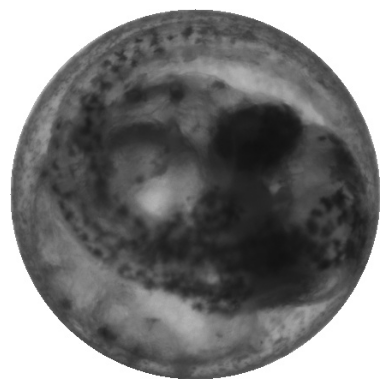

/content/embryos_for_encoder/210621150357_OlE_HR_IPF2_BQ_2x_21C_medaka_bpm_out_v1.4_LOOP2_59.jpg


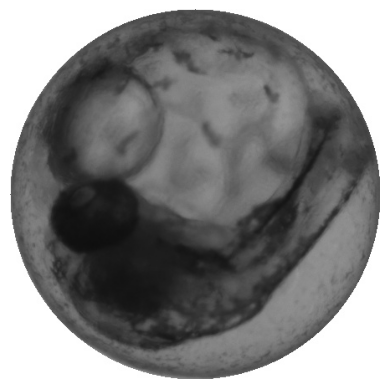

In [762]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Defina o caminho da sua imagem
image_path = file_list[95]
print(file_list[95])

# Carregue a imagem
img = mpimg.imread(image_path)

# Exiba a imagem
plt.imshow(img)
plt.axis('off')  # Para ocultar os eixos
plt.show()


import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Defina o caminho da sua imagem
image_path = file_list[1860]
print(file_list[1860])

# Carregue a imagem
img = mpimg.imread(image_path)

# Exiba a imagem
plt.imshow(img)
plt.axis('off')  # Para ocultar os eixos
plt.show()





In [763]:
#train_data

Next, we define our rVAE as a probabilistic model. To do this, first, we define our generative model (aka decoder) whose goal is to reconstruct observations (images) from the latent "code". Then we write an appropriate *guide* function (aka encoder) whose job is to ‘guess’ good values for the latent random variables. We are also going to add some helper functions to the rVAE class for the encoding of images and visualization of the learned latent manifold so that we do not have to write them over and over again.

In [764]:
new_images

tensor([[[255, 255, 255,  ..., 255, 255, 255],
         [255, 255, 255,  ..., 255, 255, 255],
         [255, 255, 255,  ..., 255, 255, 255],
         ...,
         [255, 255, 255,  ..., 255, 255, 255],
         [255, 255, 255,  ..., 255, 255, 255],
         [255, 255, 255,  ..., 255, 255, 255]],

        [[255, 255, 255,  ..., 255, 255, 255],
         [255, 255, 255,  ..., 255, 255, 255],
         [255, 255, 255,  ..., 255, 255, 255],
         ...,
         [255, 255, 255,  ..., 255, 255, 255],
         [255, 255, 255,  ..., 255, 255, 255],
         [255, 255, 255,  ..., 255, 255, 255]],

        [[255, 255, 255,  ..., 255, 255, 255],
         [255, 255, 255,  ..., 255, 255, 255],
         [255, 255, 255,  ..., 255, 255, 255],
         ...,
         [255, 255, 255,  ..., 255, 255, 255],
         [255, 255, 255,  ..., 255, 255, 255],
         [255, 255, 255,  ..., 255, 255, 255]],

        ...,

        [[255, 255, 255,  ..., 255, 255, 255],
         [255, 255, 255,  ..., 255, 255, 255]

In [765]:
train_data = new_images
train_labels = indices


In [766]:
from PIL import Image, ImageDraw
from torchvision.transforms import ToTensor
import torch
from typing import Tuple, Type
import torch.utils.data
import random

def add_noise_to_image(image: Image.Image, noise_intensity: float) -> Image.Image:
    width, height = image.size
    draw = ImageDraw.Draw(image)

    for x in range(width):
        for y in range(height):
            if random.random() < noise_intensity:
                draw.point((x, y), fill=0)  # Preencha o ponto com preto

    return image

def get_rotated_mnist(rotation_range: Tuple[int], noise_intensity: float = 0.0) -> Tuple[torch.Tensor]:
    imstack_train_r = torch.zeros_like(train_data, dtype=torch.float32)
    labels, angles = [], []

    for i, (im, lbl) in enumerate(zip(train_data, train_labels)):
        im = ToPILImage()(im)

        if noise_intensity > 0.0:
            im = add_noise_to_image(im, noise_intensity)

        # Define theta como 0 se o intervalo de rotação for [0, 0]
        if rotation_range[0] == rotation_range[1]:
            theta = torch.tensor([0.0])
        else:
            theta = torch.randint(*rotation_range, (1,)).float()

        im = im.rotate(theta.item(), resample=Image.BICUBIC, fillcolor="white")

        imstack_train_r[i] = ToTensor()(im)
        labels.append(lbl)
        angles.append(torch.deg2rad(theta))

    imstack_train_r /= imstack_train_r.max()
    return imstack_train_r, tt(labels), tt(angles)


def get_rotated_mnist_sequential_groups(num_images_per_group: int, rotation_range: Tuple[int], noise_intensity: float = 0.0) -> Tuple[torch.Tensor]:
    imstack_train_r = torch.zeros_like(train_data, dtype=torch.float32)
    labels, angles = [], []
    import math


    # Calcular ângulo de rotação para cada imagem no grupo em graus
    rotation_angle_degrees = 360 / num_images_per_group

    for i, (im, lbl) in enumerate(zip(train_data, train_labels)):
        im = ToPILImage()(im)

        if noise_intensity > 0.0:
            im = add_noise_to_image(im, noise_intensity)

        # Calcular o ângulo de rotação para a imagem atual em graus
        current_angle_degrees = (i % num_images_per_group + 1) * rotation_angle_degrees

        # Rotacionar a imagem
        im = im.rotate(current_angle_degrees, resample=Image.BICUBIC, fillcolor="white")
        imstack_train_r[i] = ToTensor()(im)
        labels.append(lbl)

        converted = math.radians(current_angle_degrees)

        # Converter o ângulo de graus para radianos e armazenar
        angles.append((converted - 6) if converted > 3 else converted)
        #angles.append(converted)

    imstack_train_r /= imstack_train_r.max()
    return imstack_train_r, torch.tensor(labels), torch.tensor(angles)



def init_dataloader(*args: torch.Tensor, **kwargs: int
                    ) -> Type[torch.utils.data.DataLoader]:

    batch_size = kwargs.get("batch_size", 100)
    tensor_set = torch.utils.data.dataset.TensorDataset(*args)
    data_loader = torch.utils.data.DataLoader(
        dataset=tensor_set, batch_size=batch_size, shuffle=True)
    return data_loader

In [767]:
train_labels

tensor([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  1,  1,  1,  1,  1,  1,  1,
         1,  1,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  3,  3,  3,  3,  3,  3,
         3,  3,  3,  3,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  5,  5,  5,  5,
         5,  5,  5,  5,  5,  5,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  7,  7,
         7,  7,  7,  7,  7,  7,  7,  7,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,
         9,  9,  9,  9,  9,  9,  9,  9,  9,  9, 10, 10, 10, 10, 10, 10, 10, 10,
        10, 10, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 12, 12, 12, 12, 12, 12,
        12, 12, 12, 12, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 14, 14, 14, 14,
        14, 14, 14, 14, 14, 14, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 16, 16,
        16, 16, 16, 16, 16, 16, 16, 16, 17, 17, 17, 17, 17, 17, 17, 17, 17, 17,
        18, 18, 18, 18, 18, 18, 18, 18, 18, 18, 19, 19, 19, 19, 19, 19, 19, 19,
        19, 19, 20, 20, 20, 20, 20, 20, 20, 20, 20, 20, 21, 21, 21, 21, 21, 21,
        21, 21, 21, 21, 22, 22, 22, 22, 

In [768]:
train_labels
train_labels = train_labels.to(dtype=torch.int64)


In [769]:
#train_data, train_labels, angles = get_rotated_mnist(rotation_range=[-1, 1])   #-60, 61
#train_data, train_labels, angles = get_rotated_mnist(rotation_range=[-60, 61], noise_intensity=0.0)  #a have added option to add noise, just to test
train_data, train_labels, angles = get_rotated_mnist_sequential_groups(10, rotation_range=[-60, 61], noise_intensity=0.0)  #a have added option to add noise, just to test


train_loader = init_dataloader(train_data, batch_size=100)

In [770]:
angles[0:10]

tensor([ 0.6283,  1.2566,  1.8850,  2.5133, -2.8584, -2.2301, -1.6018, -0.9735,
        -0.3451,  0.2832])

In [771]:
#train_data, train_labels, angles = get_rotated_mnist(rotation_range=[-60, 61], noise_intensity=0.0)  #a have added option to add noise, just to test


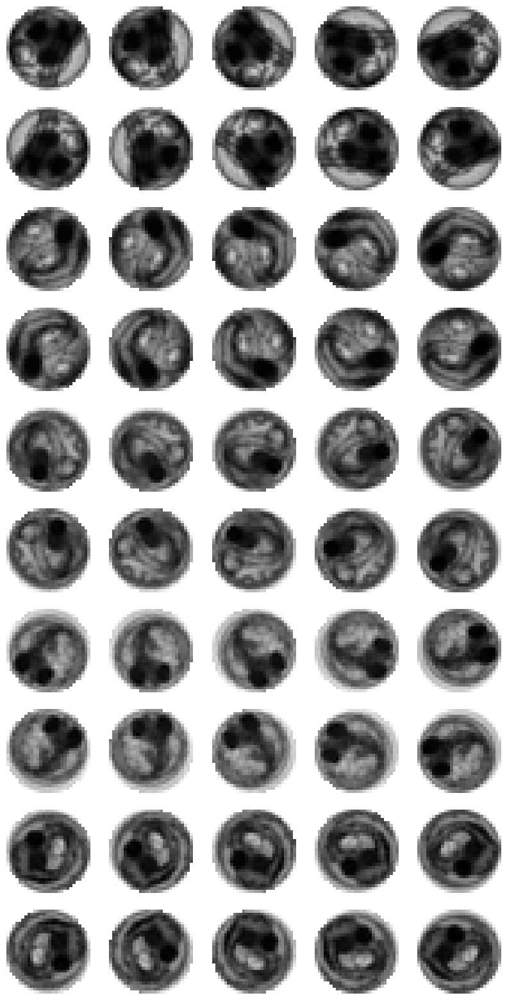

In [772]:
import matplotlib.pyplot as plt

def plot_images(tensor, num_images=50):
    # Define o número de colunas para exibir as imagens
    cols = 5

    # Calcula o número necessário de linhas para exibir num_images imagens
    rows = num_images // cols + int(num_images % cols > 0)

    # Cria uma figura com subplots
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 2, rows * 2))

    for i in range(num_images):
        ax = axes[i // cols, i % cols]
        # tensor[i] acessa a i-ésima imagem; .numpy() converte para um array numpy
        ax.imshow(tensor[i].numpy().squeeze(), cmap='gray')  # Supondo que as imagens são em escala de cinza
        ax.axis('off')

    # Esconde subplots extras se houver
    for j in range(i + 1, rows * cols):
        axes[j // cols, j % cols].axis('off')

    plt.show()

# Chama a função passando o tensor train_data
plot_images(train_data)


In [773]:
train_data[0].shape

torch.Size([28, 28])

In [774]:
import torch
from torch import Tensor as tt

tensor_val = tt(torch.Size([28, 28]))
prod_val = torch.prod(tensor_val)


In [775]:
class rVAE(nn.Module):
    """
    Variational autoencoder with rotational and/or transaltional invariance
    """
    def __init__(self,
                 in_dim: Tuple[int],
                 latent_dim: int = 3, #change here
                 coord: int = 3,
                 num_classes: int = 0,
                 hidden_dim_e: int = 128,
                 hidden_dim_d: int = 128,
                 num_layers_e: int = 2,
                 num_layers_d: int = 2,
                 activation: str = "lrelu",
                 softplus_sd: bool = True,
                 sigmoid_out: bool = True,
                 seed: int = 1,
                 **kwargs
                 ) -> None:
        """
        Initializes rVAE's modules and parameters
        """

        super(rVAE, self).__init__()
        pyro.clear_param_store()
        set_deterministic_mode(seed)
        self.device = 'cuda' if torch.cuda.is_available() else 'cpu'


        self.encoder_net = fcEncoderNet(
            in_dim, latent_dim+coord, hidden_dim_e,
            num_layers_e, activation, softplus_sd)
        if coord not in [0, 1, 2, 3]:
            raise ValueError("'coord' argument must be 0, 1, 2 or 3")
        dnet = rDecoderNet if coord in [1, 2, 3] else fcDecoderNet


        self.decoder_net = dnet(
            in_dim, latent_dim+num_classes, hidden_dim_d,
            num_layers_d, activation, sigmoid_out)
        self.z_dim = latent_dim + coord
        self.coord = coord
        self.num_classes = num_classes
        self.grid = imcoordgrid(in_dim).to(self.device)

        #self.dx_prior = tt(kwargs.get("dx_prior", 0.1)).to(self.device)
        self.dx_prior = tt([kwargs.get("dx_prior", 0.1)]).to(self.device)



        self.to(self.device)


    def model(self,
              x: torch.Tensor,
              y: Optional[torch.Tensor] = None,
              **kwargs: float) -> torch.Tensor:
        """
        Defines the model p(x|z)p(z)
        """
        # register PyTorch module `decoder_net` with Pyro
        pyro.module("decoder_net", self.decoder_net)
        # KLD scale factor (see e.g. https://openreview.net/pdf?id=Sy2fzU9gl)
        beta = kwargs.get("scale_factor", .001)
        #reshape_ = torch.prod(tt(x.shape[1:])).item()
        #reshape_ = torch.prod(tt(torch.Size([56, 56])))
        reshape_ = x.shape[1:][0] * x.shape[1:][1]

        ####################################################

        with pyro.plate("data", x.shape[0]):
            # setup hyperparameters for prior p(z)
            z_loc = x.new_zeros(torch.Size((x.shape[0], self.z_dim)))
            z_scale = x.new_ones(torch.Size((x.shape[0], self.z_dim)))
            # sample from prior (value will be sampled by guide when computing the ELBO)
            with pyro.poutine.scale(scale=beta):
                z = pyro.sample("latent", dist.Normal(z_loc, z_scale).to_event(1))
            if self.coord > 0:  # rotationally- and/or translationaly-invariant mode
                # Split latent variable into parts for rotation
                # and/or translation and image content
                phi, dx, z = self.split_latent(z)
                if torch.sum(dx) != 0:
                    dx = (dx * self.dx_prior).unsqueeze(1)
                # transform coordinate grid
                grid = self.grid.expand(x.shape[0], *self.grid.shape)
                x_coord_prime = transform_coordinates(grid, phi, dx)
            # Add class label (if any)
            if y is not None:
                y = to_onehot(y, self.num_classes)
                z = torch.cat([z, y], dim=-1)
            # decode the latent code z together with the transformed coordiantes (if any)
            dec_args = (x_coord_prime, z) if self.coord else (z,)
            loc_img = self.decoder_net(*dec_args)
            # score against actual images ("binary cross-entropy loss")

            pyro.sample(
                "obs", dist.Bernoulli(loc_img.view(-1, int(reshape_)), validate_args=False).to_event(1),
                obs=x.view(-1, reshape_))

    def guide(self,
              x: torch.Tensor,
              y: Optional[torch.Tensor] = None,
              **kwargs: float) -> torch.Tensor:
        """
        Defines the guide q(z|x)
        """
        # register PyTorch module `encoder_net` with Pyro
        pyro.module("encoder_net", self.encoder_net)
        # KLD scale factor (see e.g. https://openreview.net/pdf?id=Sy2fzU9gl)
        beta = kwargs.get("scale_factor", .001)
        with pyro.plate("data", x.shape[0]):
            # use the encoder to get the parameters used to define q(z|x)
            z_loc, z_scale = self.encoder_net(x)
            # sample the latent code z
            with pyro.poutine.scale(scale=beta):
                pyro.sample("latent", dist.Normal(z_loc, z_scale).to_event(1))

    def split_latent(self, z: torch.Tensor) -> Tuple[torch.Tensor]:
        """
        Split latent variable into parts for rotation
        and/or translation and image content
        """
        phi = torch.tensor(0.0)
        dx = torch.tensor(0.0)


        # rotation + translation
        if self.coord == 3:
            phi = z[:, 0]  # encoded angle
            dx = z[:, 1:3]  # translation
            z = z[:, 3:]  # image content
        # translation only
        elif self.coord == 2:
            dx = z[:, :2]
            z = z[:, 2:]
        # rotation only
        elif self.coord == 1:
            phi = z[:, 0]
            z = z[:, 1:]
        return phi, dx, z

    def _encode(self, x_new: torch.Tensor, **kwargs: int) -> torch.Tensor:
        """
        Encodes data using a trained inference (encoder) network
        in a batch-by-batch fashion
        """
        def inference() -> np.ndarray:
            with torch.no_grad():
                encoded = self.encoder_net(x_i)
            encoded = torch.cat(encoded, -1).cpu()
            return encoded

        x_new = x_new.to(self.device)
        num_batches = kwargs.get("num_batches", 10)
        batch_size = len(x_new) // num_batches
        z_encoded = []
        for i in range(num_batches):
            x_i = x_new[i*batch_size:(i+1)*batch_size]
            z_encoded_i = inference()
            z_encoded.append(z_encoded_i)
        x_i = x_new[(i+1)*batch_size:]
        if len(x_i) > 0:
            z_encoded_i = inference()
            z_encoded.append(z_encoded_i)
        return torch.cat(z_encoded)


    def encode(self, x_new: torch.Tensor, **kwargs: int) -> torch.Tensor:
        """
        Encodes data using a trained inference (encoder) network
        (this is baiscally a wrapper for self._encode)
        """
        if isinstance(x_new, torch.utils.data.DataLoader):
            x_new = train_loader.dataset.tensors[0]
        z = self._encode(x_new)



        z_loc = z[:, :self.z_dim]
        z_scale = z[:, self.z_dim:]
        return z_loc, z_scale

    import torch
    import matplotlib.pyplot as plt
    from torchvision.utils import make_grid

    import torch
    import matplotlib.pyplot as plt
    from torchvision.utils import make_grid

    import torch
    import matplotlib.pyplot as plt
    from torchvision.utils import make_grid

    def bigmanifold2d(self, z_mean, z_sd, d=10, **kwargs):
        """
        Selects and plots images from latent space based on instances with lowest average standard deviation
        """

        # Calcular a média dos desvios padrões para cada instância
        avg_sd = torch.mean(z_sd, dim=1)

        # Selecionar os índices das instâncias com menores médias de desvios padrões
        highest_avg_std_indices = torch.argsort(avg_sd, descending=True)[:d]

        # Usar as médias correspondentes às menores médias de desvios padrões para gerar imagens
        selected_means = z_mean[highest_avg_std_indices]


        images = []
        for z in selected_means:
            z = z.unsqueeze(0).to(self.device)
            img = self.decoder_net(z)
            images.append(img.detach().cpu())

        # Plotting
        grid = make_grid(images, nrow=5, padding=kwargs.get("padding", 2), pad_value=kwargs.get("pad_value", 0))
        plt.figure(figsize=(8, 8))
        plt.imshow(grid.permute(1, 2, 0), cmap=kwargs.get("cmap", "gray"))
        plt.axis('off')
        plt.show()

    def smallmanifold2d(self, z_mean, z_sd, d=10, **kwargs):
            """
            Selects and plots images from latent space based on instances with lowest average standard deviation
            """

            # Calcular a média dos desvios padrões para cada instância
            avg_sd = torch.mean(z_sd, dim=1)

            # Selecionar os índices das instâncias com menores médias de desvios padrões
            lowest_avg_std_indices = torch.argsort(avg_sd)[:d]

            # Usar as médias correspondentes às menores médias de desvios padrões para gerar imagens
            selected_means = z_mean[lowest_avg_std_indices]


            images = []
            for z in selected_means:
                z = z.unsqueeze(0).to(self.device)
                img = self.decoder_net(z)
                images.append(img.detach().cpu())

            # Plotting
            grid = make_grid(images, nrow=5, padding=kwargs.get("padding", 2), pad_value=kwargs.get("pad_value", 0))
            plt.figure(figsize=(8, 8))
            plt.imshow(grid.permute(1, 2, 0), cmap=kwargs.get("cmap", "gray"))
            plt.axis('off')
            plt.show()




    def random_samples_from_latent(self, z_mean, z_sd, d, labels, target_label=None, **kwargs):


        if self.coord > 0:
          z_mean = z_mean[:, 1:]
          z_inv = z_mean[:, -1]
          print(z_inv)


        """
        Selects and plots images from latent space based on random samples
        corresponding to a specific target label or from any label if none is specified.
        """
        print(f"numero de classes: {self.num_classes}")
        if self.num_classes > 0:
            print(f"classes: {self.num_classes}")
            cls = torch.tensor(kwargs.get("label", 0))
            cls = to_onehot(cls.unsqueeze(0), self.num_classes)

        # Filtrar índices baseados no label alvo
        if target_label is not None:
            target_indices = torch.where(labels == target_label)[0]
        elif self.num_classes > 0:
            target_indices = torch.where(labels == kwargs.get("label", 0))[0]
        else:
           target_indices = torch.arange(labels.shape[0])


        # Selecionar d índices de forma aleatória dos índices filtrados
        random.seed(1)
        selected_indices = torch.tensor(random.sample(list(target_indices), d))
        # Usar os índices selecionados para escolher amostras de z_mean
        selected_means = z_mean[selected_indices]
        z_inv_selected = z_inv[selected_indices]

        #print(selected_means)



        if self.num_classes > 0:
            new_z_mean = []
            for z in selected_means:
              cls = cls.to('cuda:0')  # Garantir que cls está no mesmo dispositivo que z_mean
              z = z.view(1, -1)
              z=z.to('cuda:0')
              z = torch.cat([z, cls], dim=-1)
              new_z_mean.append(z)
            selected_means = new_z_mean

        images = []
        for i, z in enumerate(selected_means):

            z = z.unsqueeze(0).to(self.device)
            d_args = (self.grid.unsqueeze(0), z) if self.coord > 0 else (z,)
            img = self.decoder_net(*d_args)
            detached = img.detach().cpu()
            if z_inv_selected[i] < 0:
              detached = torch.flip(detached, [1, 2])

            images.append(detached)

        # Plotting
        grid = make_grid(images, nrow=5, padding=kwargs.get("padding", 2), pad_value=kwargs.get("pad_value", 0))
        plt.figure(figsize=(8, 8))
        plt.imshow(grid.permute(1, 2, 0), cmap=kwargs.get("cmap", "gray"))
        plt.axis('off')
        plt.show()
        #print(the_angles)


    def manifold2d(self, d: int, **kwargs: Union[str, int]) -> torch.Tensor:
        """
        Plots a learned latent manifold in the image space
        """


        print("manifold2d")
        print(print(kwargs))
        print("n classes")
        print(self.num_classes)
        if self.num_classes > 0:
            #cls = tt(kwargs.get("label", 0))
            cls = torch.tensor(kwargs.get("label", 0))



            print("the cls")
            print(cls)
            cls = to_onehot(cls.unsqueeze(0), self.num_classes)
            print(cls)
            print(cls.shape)
        grid_x = norm.ppf(torch.linspace(0.95, 0.05, d))
        grid_y = norm.ppf(torch.linspace(0.05, 0.95, d))
        loc_img_all = []
        for i, xi in enumerate(grid_x):
            for j, yi in enumerate(grid_y):
                z_sample = tt([xi, yi]).float().to(self.device).unsqueeze(0)
                if self.num_classes > 0:
                    print("z_sample")
                    print(z_sample)
                    print(z_sample.shape)

                    z_sample = torch.cat([z_sample, cls], dim=-1)

                d_args = (self.grid.unsqueeze(0), z_sample) if self.coord > 0 else (z_sample,)
                print("d_args")
                print(d_args)
                print(*d_args)
                print(d_args[0].shape)
                print(d_args[1].shape)
                print(d_args[1])
                loc_img = self.decoder_net(*d_args)
                loc_img_all.append(loc_img.detach().cpu())
        loc_img_all = torch.cat(loc_img_all)

        grid = make_grid(loc_img_all[:, None], nrow=d,
                         padding=kwargs.get("padding", 2),
                         pad_value=kwargs.get("pad_value", 0))
        plt.figure(figsize=(8, 8))
        plt.imshow(grid[0], cmap=kwargs.get("cmap", "gnuplot"),
                   origin=kwargs.get("origin", "upper"),
                   extent=[grid_x.min(), grid_x.max(), grid_y.min(), grid_y.max()])
        plt.xticks(fontsize=14)
        plt.yticks(fontsize=14)
        plt.xlabel("x", fontsize=18)
        plt.ylabel("y", fontsize=18)
        plt.show()





We also define a stochastic variational inference (SVI) trainer for model training and evaluation:

In [776]:
class SVItrainer:
    """
    Stochastic variational inference (SVI) trainer for
    unsupervised and class-conditioned variational models
    """
    def __init__(self,
                 model: Type[nn.Module],
                 optimizer: Type[optim.PyroOptim] = None,
                 loss: Type[infer.ELBO] = None,
                 seed: int = 1
                 ) -> None:
        """
        Initializes the trainer's parameters
        """

        print("the model")
        print(model)
        print(type(model))
        pyro.clear_param_store()
        set_deterministic_mode(seed)
        self.device = 'cuda' if torch.cuda.is_available() else 'cpu'
        if optimizer is None:
            optimizer = optim.Adam({"lr": 1.0e-3})
        if loss is None:
            loss = infer.Trace_ELBO()
        self.svi = infer.SVI(model.model, model.guide, optimizer, loss=loss)
        self.loss_history = {"training_loss": [], "test_loss": []}
        self.current_epoch = 0

    def set_current_epoch(self, epoch):
        self.current_epoch = epoch

    def train(self,
              train_loader: Type[torch.utils.data.DataLoader],
              **kwargs: float) -> float:
        """
        Trains a single epoch
        """
        # initialize loss accumulator
        epoch_loss = 0.
        # do a training epoch over each mini-batch returned by the data loader
        for data in train_loader:
            if len(data) == 1:  # VAE mode
                x = data[0]
                loss = self.svi.step(x.to(self.device), **kwargs)
            else:  # VED or cVAE mode
                x, y = data
                loss = self.svi.step(
                    x.to(self.device), y.to(self.device), **kwargs)
            # do ELBO gradient and accumulate loss
            epoch_loss += loss

        return epoch_loss / len(train_loader.dataset)

    def evaluate(self,
                 test_loader: Type[torch.utils.data.DataLoader],
                 **kwargs: float) -> float:
        """
        Evaluates current models state on a single epoch
        """
        # initialize loss accumulator
        test_loss = 0.
        # compute the loss over the entire test set
        with torch.no_grad():
            for data in test_loader:
                if len(data) == 1:  # VAE mode
                    x = data[0]
                    loss = self.svi.step(x.to(self.device), **kwargs)
                else:  # VED or cVAE mode
                    x, y = data
                    loss = self.svi.step(
                        x.to(self.device), y.to(self.device), **kwargs)
                test_loss += loss

        return test_loss / len(test_loader.dataset)

    def step(self,
             train_loader: Type[torch.utils.data.DataLoader],
             test_loader: Optional[Type[torch.utils.data.DataLoader]] = None,
             **kwargs: float) -> None:
        """
        Single training and (optionally) evaluation step
        """
        self.loss_history["training_loss"].append(self.train(train_loader,**kwargs))
        if test_loader is not None:
            self.loss_history["test_loss"].append(self.evaluate(test_loader,**kwargs))
        self.current_epoch += 1

    def print_statistics(self) -> None:
        """
        Prints training and test (if any) losses for current epoch
        """
        e = self.current_epoch
        if len(self.loss_history["test_loss"]) > 0:
            template = 'Epoch: {} Training loss: {:.4f}, Test loss: {:.4f}'
            print(template.format(e, self.loss_history["training_loss"][-1],
                                  self.loss_history["test_loss"][-1]))
        else:
            template = 'Epoch: {} Training loss: {:.4f}'
            print(template.format(e, self.loss_history["training_loss"][-1]))



## **Verify original images**

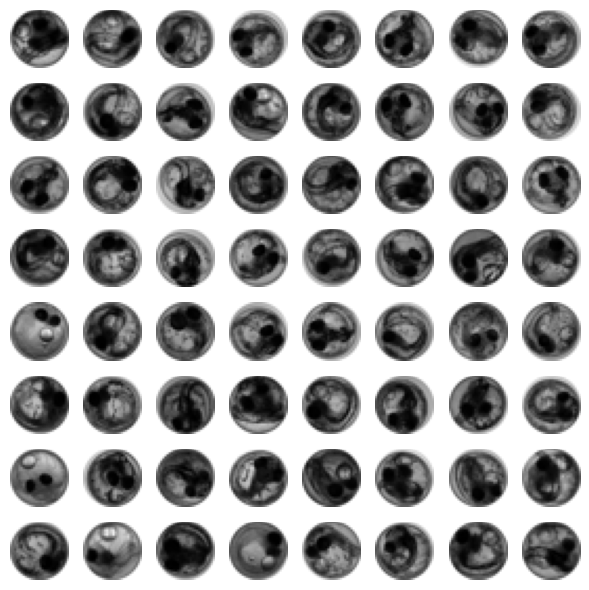

In [777]:
import torch
import matplotlib.pyplot as plt
import numpy as np

def plot_tensor_images(tensor_images, num_images=64):
    """
    Função para plotar imagens a partir de um tensor do PyTorch.

    Argumentos:
    - tensor_images (torch.Tensor): Tensor de imagens no formato [N, H, W].
    - num_images (int): Número de imagens para plotar.

    """
    # Verifica se o tensor_images está no formato adequado
    if len(tensor_images.shape) != 3:
        raise ValueError("O tensor deve ter o formato [N, H, W].")

    N, H, W = tensor_images.shape

    # Cria um grid para exibir as imagens
    grid_size = int(np.sqrt(num_images))
    fig, axs = plt.subplots(grid_size, grid_size, figsize=(6, 6))

    for i in range(grid_size * grid_size):
        ax = axs[i // grid_size, i % grid_size]
        # Transforma o tensor em numpy
        img_np = tensor_images[i].cpu().numpy()
        ax.imshow(img_np, cmap='gray')
        ax.axis('off')

    plt.tight_layout()
    plt.show()

# Exemplo de uso:
# Cria um tensor fictício de 2808 imagens grayscale 28x28
sample_tensor = torch.randn(2808, 28, 28)

# Plotando as primeiras 64 imagens
plot_tensor_images(tensor_images)

## Train different VAE models

### Train vanilla VAE

In [778]:
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter('runs/vae')



Train VAE model:

In [779]:
%load_ext tensorboard
%tensorboard --logdir runs/vae



The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [780]:

dddd

NameError: name 'dddd' is not defined

### **Bellow if for Vae**







In [ ]:
train_loader = init_dataloader(train_data, batch_size=100)


In [ ]:
n = 10 # frequency to save weights
in_dim = (28, 28)
# Inicializar a variável que mantém a última época
last_epoch = 0

# Initialize probabilistic VAE model ->
# (coord=0: vanilla VAE
#  coord=1: rotations only
#  coord=2: translations only
#  coord=3: rotations+translations)
vae = rVAE(in_dim, latent_dim=3, coord=0, seed=0)

# Initialize SVI trainer
trainer = SVItrainer(vae)

In [ ]:
import os
import torch

# Caminho para o arquivo de modelo salvo
model_path = '/content/drive/My Drive/model_vae.pth'



# Verificar se o arquivo de modelo salvo existe
if os.path.exists(model_path):
    print("arquivo de treino exists")
    # Carregar o estado salvo
    checkpoint = torch.load(model_path)
    vae.load_state_dict(checkpoint['model_state_dict'])
    trainer.svi.optim.set_state(checkpoint['optimizer_state_dict'])
    last_epoch = checkpoint['epoch']
    trainer.set_current_epoch(last_epoch)
    print(f"Retomando do treinamento na época {last_epoch}")
else:
    last_epoch = 0
    print("Começando da época 0")

In [ ]:
if os.path.exists(model_path):
  checkpoint = torch.load(model_path)
  last_epoch = checkpoint['epoch']
  print(f"last epoch in file is {last_epoch}")
else:
  last_epoch = 0
  print("starting from epoch 0")
# Train for n epochs:
for e in range(last_epoch + 1, 6000):
    trainer.step(train_loader)
    trainer.print_statistics()
    # Acessar a última perda de treinamento registrada
    current_training_loss = trainer.loss_history["training_loss"][-1]
    writer.add_scalar('Loss/train', current_training_loss, e)
    if (e % n == 0) and (e > 1):  # n é a frequência com que você quer salvar
      print("saving model")
      torch.save({
          'epoch': e,
          'model_state_dict': vae.state_dict(),
          'optimizer_state_dict': trainer.svi.optim.get_state(),
          'loss': current_training_loss,
          # Salve qualquer outra coisa que você precise
      }, '/content/drive/My Drive/model_vae.pth')

writer.close()


In [ ]:
z_mean, z_sd = vae.encode(train_data)
vae.random_samples_from_latent(z_mean, z_sd, 20, train_labels, target_label=6, cmap='gray')

In [ ]:
z_mean, z_sd = vae.encode(train_data)

fig = plt.figure(figsize=(15, 6))
ax = fig.add_subplot(111, projection='3d')

# Suponha que z_mean tenha 3 dimensões: z_mean[:, 0], z_mean[:, 1], z_mean[:, 2]
# Vamos usar as dimensões 0, 1 e 2 para o gráfico de dispersão 3D

scatter = ax.scatter(z_mean[:, 0], z_mean[:, 1], z_mean[:, 2], c=train_labels, cmap='jet', s=1)
ax.set_xlabel("$z_1$", fontsize=14)
ax.set_ylabel("$z_2$", fontsize=14)
ax.set_zlabel("$z_3$", fontsize=14)

cbar = fig.colorbar(scatter, ax=ax, shrink=0.8)
cbar.set_label("Train labels", fontsize=14)
cbar.ax.tick_params(labelsize=10)

# Ajuste automaticamente os limites dos eixos para se adequarem aos pontos
ax.auto_scale_xyz(z_mean[:, 0], z_mean[:, 1], z_mean[:, 2])

plt.show()


In [ ]:
import plotly.express as px

z_mean, z_sd = vae.encode(train_data)

# Suponha que z_mean tenha 3 dimensões: z_mean[:, 0], z_mean[:, 1], z_mean[:, 2]
# Vamos usar as dimensões 0, 1 e 2 para o gráfico 3D

fig = px.scatter_3d(x=z_mean[:, 0], y=z_mean[:, 1], z=z_mean[:, 2], color=train_labels, opacity=0.7, size_max=5)
fig.update_layout(scene=dict(aspectmode="cube"))
fig.update_layout(scene=dict(xaxis_title="$z_1$", yaxis_title="$z_2$", zaxis_title="$z_3$"))
fig.show()


### **Bellow is for CVAE**

In [ ]:
train_loader = init_dataloader(train_data, train_labels, batch_size=100)


In [ ]:
n = 10 # frequency to save weights
in_dim = (28, 28)
# Inicializar a variável que mantém a última época
last_epoch = 0

# Initialize probabilistic VAE model ->
# (coord=0: vanilla VAE
#  coord=1: rotations only
#  coord=2: translations only
#  coord=3: rotations+translations)

cvae = rVAE(in_dim, latent_dim=3, num_classes=10, coord=0, seed=0)
# Initialize SVI trainer
trainer = SVItrainer(cvae)




In [ ]:
import os
import torch

# Caminho para o arquivo de modelo salvo
model_path = '/content/drive/My Drive/model_vae.pth'



# Verificar se o arquivo de modelo salvo existe
if os.path.exists(model_path):
    print("arquivo de treino exists")
    # Carregar o estado salvo
    checkpoint = torch.load(model_path)
    cvae.load_state_dict(checkpoint['model_state_dict'])
    trainer.svi.optim.set_state(checkpoint['optimizer_state_dict'])
    last_epoch = checkpoint['epoch']
    trainer.set_current_epoch(last_epoch)
    print(f"Retomando do treinamento na época {last_epoch}")
else:
    last_epoch = 0
    print("Começando da época 0")


In [ ]:
if os.path.exists(model_path):
  checkpoint = torch.load(model_path)
  last_epoch = checkpoint['epoch']
  print(f"last epoch in file is {last_epoch}")
else:
  last_epoch = 0
  print("starting from epoch 0")
# Train for n epochs:
for e in range(last_epoch + 1, 6000):
    trainer.step(train_loader)
    trainer.print_statistics()
    # Acessar a última perda de treinamento registrada
    current_training_loss = trainer.loss_history["training_loss"][-1]
    writer.add_scalar('Loss/train', current_training_loss, e)
    if (e % n == 0) and (e > 1):  # n é a frequência com que você quer salvar
      print("saving model")
      torch.save({
          'epoch': e,
          'model_state_dict': cvae.state_dict(),
          'optimizer_state_dict': trainer.svi.optim.get_state(),
          'loss': current_training_loss,
          # Salve qualquer outra coisa que você precise
      }, '/content/drive/My Drive/model_vae.pth')

writer.close()


In [ ]:
z_mean, z_sd = cvae.encode(train_data)
for i in range(0, 9):
  print(i)
  cvae.random_samples_from_latent(z_mean, z_sd, 10, train_labels, target_label=None, cmap='gray', label=i)
  print("_______________________________________________________________________")


In [ ]:
z_mean, z_sd = cvae.encode(train_data)

fig = plt.figure(figsize=(15, 6))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(z_mean[:, 0], z_mean[:, 1], z_mean[:, 2], c=train_labels, cmap='jet', s=1)
ax.set_xlabel("$z_1$", fontsize=14)
ax.set_ylabel("$z_2$", fontsize=14)
ax.set_zlabel("$z_3$", fontsize=14)

cbar = fig.colorbar(scatter, ax=ax, shrink=0.8)
cbar.set_label("Train labels", fontsize=14)
cbar.ax.tick_params(labelsize=10)

# Ajuste automaticamente os limites dos eixos para se adequarem aos pontos
ax.auto_scale_xyz(z_mean[:, 0], z_mean[:, 1], z_mean[:, 2])

plt.show()

In [ ]:
import plotly.express as px

z_mean, z_sd = cvae.encode(train_data)

# Suponha que z_mean tenha 3 dimensões: z_mean[:, 0], z_mean[:, 1], z_mean[:, 2]
# Vamos usar as dimensões 0, 1 e 2 para o gráfico 3D

fig = px.scatter_3d(x=z_mean[:, 0], y=z_mean[:, 1], z=z_mean[:, 2], color=train_labels, opacity=0.7, size_max=5)
fig.update_layout(scene=dict(aspectmode="cube"))
fig.update_layout(scene=dict(xaxis_title="$z_1$", yaxis_title="$z_2$", zaxis_title="$z_3$"))
fig.show()


### **Train rotationally-invariant VAE (rVAE)**

In [781]:
train_loader = init_dataloader(train_data, batch_size=100)

In [782]:
n = 10 # frequency to save weights
in_dim = (28, 28)
# Inicializar a variável que mantém a última época
last_epoch = 0

# Initialize probabilistic VAE model ->
# (coord=0: vanilla VAE
#  coord=1: rotations only
#  coord=2: translations only
#  coord=3: rotations+translations)
rvae = rVAE(in_dim, latent_dim=3, coord=1, seed=0)

# Initialize SVI trainer
trainer = SVItrainer(rvae)

the latent dim
3
the model
rVAE(
  (encoder_net): fcEncoderNet(
    (fc_layers): Sequential(
      (0): Linear(in_features=784, out_features=128, bias=True)
      (1): LeakyReLU(negative_slope=0.01)
      (2): Linear(in_features=128, out_features=128, bias=True)
      (3): LeakyReLU(negative_slope=0.01)
    )
    (fc11): Linear(in_features=128, out_features=4, bias=True)
    (fc12): Linear(in_features=128, out_features=4, bias=True)
    (activation_out): Softplus(beta=1, threshold=20)
  )
  (decoder_net): rDecoderNet(
    (coord_latent): coord_latent(
      (fc_coord): Linear(in_features=2, out_features=128, bias=True)
      (fc_latent): Linear(in_features=3, out_features=128, bias=False)
      (activation): Tanh()
    )
    (fc_layers): Sequential(
      (0): Linear(in_features=128, out_features=128, bias=True)
      (1): LeakyReLU(negative_slope=0.01)
      (2): Linear(in_features=128, out_features=128, bias=True)
      (3): LeakyReLU(negative_slope=0.01)
    )
    (out): Linear(in_f

In [783]:
import os
import torch

# Caminho para o arquivo de modelo salvo
model_path = '/content/drive/My Drive/model_vae.pth'



# Verificar se o arquivo de modelo salvo existe
if os.path.exists(model_path):
    print("arquivo de treino exists")
    # Carregar o estado salvo
    checkpoint = torch.load(model_path)
    rvae.load_state_dict(checkpoint['model_state_dict'])
    trainer.svi.optim.set_state(checkpoint['optimizer_state_dict'])
    last_epoch = checkpoint['epoch']
    trainer.set_current_epoch(last_epoch)
    print(f"Retomando do treinamento na época {last_epoch}")
else:
    last_epoch = 0
    print("Começando da época 0")

arquivo de treino exists
Retomando do treinamento na época 7790


In [784]:
if os.path.exists(model_path):
  checkpoint = torch.load(model_path)
  last_epoch = checkpoint['epoch']
  print(f"last epoch in file is {last_epoch}")
else:
  last_epoch = 0
  print("starting from epoch 0")
# Train for n epochs:
for e in range(last_epoch + 1, 22000):
    trainer.step(train_loader)
    trainer.print_statistics()
    # Acessar a última perda de treinamento registrada
    current_training_loss = trainer.loss_history["training_loss"][-1]
    writer.add_scalar('Loss/train', current_training_loss, e)
    if (e % n == 0) and (e > 1):  # n é a frequência com que você quer salvar
      print("saving model")
      torch.save({
          'epoch': e,
          'model_state_dict': rvae.state_dict(),
          'optimizer_state_dict': trainer.svi.optim.get_state(),
          'loss': current_training_loss,
          # Salve qualquer outra coisa que você precise
      }, '/content/drive/My Drive/model_vae.pth')

writer.close()

last epoch in file is 7790
Epoch: 7791 Training loss: 379.2517
Epoch: 7792 Training loss: 378.2806
Epoch: 7793 Training loss: 378.2308
Epoch: 7794 Training loss: 378.0627
Epoch: 7795 Training loss: 378.0205
Epoch: 7796 Training loss: 378.0464
Epoch: 7797 Training loss: 377.9936
Epoch: 7798 Training loss: 377.9208
Epoch: 7799 Training loss: 377.9222
Epoch: 7800 Training loss: 377.8245
saving model
Epoch: 7801 Training loss: 377.7764
Epoch: 7802 Training loss: 377.7937
Epoch: 7803 Training loss: 377.8066
Epoch: 7804 Training loss: 377.8393
Epoch: 7805 Training loss: 377.8003
Epoch: 7806 Training loss: 377.8273
Epoch: 7807 Training loss: 377.8442
Epoch: 7808 Training loss: 377.8204
Epoch: 7809 Training loss: 378.1907
Epoch: 7810 Training loss: 378.5330
saving model
Epoch: 7811 Training loss: 378.1891
Epoch: 7812 Training loss: 378.7685
Epoch: 7813 Training loss: 379.8632
Epoch: 7814 Training loss: 380.0600
Epoch: 7815 Training loss: 379.4073
Epoch: 7816 Training loss: 379.0890
Epoch: 7817

KeyboardInterrupt: 

In [831]:
import plotly.express as px

z_mean, z_sd = rvae.encode(train_data)

# Suponha que z_mean tenha 3 dimensões: z_mean[:, 0], z_mean[:, 1], z_mean[:, 2]
# Vamos usar as dimensões 0, 1 e 2 para o gráfico 3D

fig = px.scatter_3d(x=z_mean[:, 0], y=z_mean[:, 1], z=z_mean[:, 2], color=train_labels, opacity=0.7, size_max=1)
fig.update_traces(marker=dict(size=3))

fig.update_layout(scene=dict(aspectmode="cube"))
fig.update_layout(scene=dict(xaxis_title="$z_1$", yaxis_title="$z_2$", zaxis_title="$z_3$"))
fig.show()

In [832]:
#train_labels = torch.tensor([0])


In [833]:
#imagem_modificada = train_data[0].unsqueeze(0)
#imagem_normalizada = (tensor_images[1000:3000].float() / 255.0) #.unsqueeze(0)

#train_data = imagem_normalizada


In [834]:
#imagem_normalizada.shape

In [835]:
#plt.imshow(imagem_normalizada[1], cmap='gray')  # Use cmap='gray' para imagens em escala de cinza
#plt.show()

In [836]:
#train_data = imagem_normalizada
#train_data = torch.flip(train_data, [2])


In [837]:
#plt.imshow(train_data[1], cmap='gray')  # Use cmap='gray' para imagens em escala de cinza
#plt.show()

In [838]:
#train_data.shape

In [839]:
z_mean, z_sd = rvae.encode(train_data)
corrected = z_mean[:, 0]


In [840]:
#z_mean

In [841]:
#train_labels = torch.zeros(1808)


In [842]:
#train_labels.shape

In [843]:
#rvae.random_samples_from_latent(z_mean, z_sd, 20, train_labels, target_label=None, cmap='gray')

In [844]:
#rvae.random_samples_from_latent(z_mean, z_sd, 20, train_labels, target_label=None, cmap='gray')

In [845]:
#z_mean

In [846]:
#corrected = z_mean[:, 0]

In [847]:
#corrected

In [848]:
#angles[0:10]

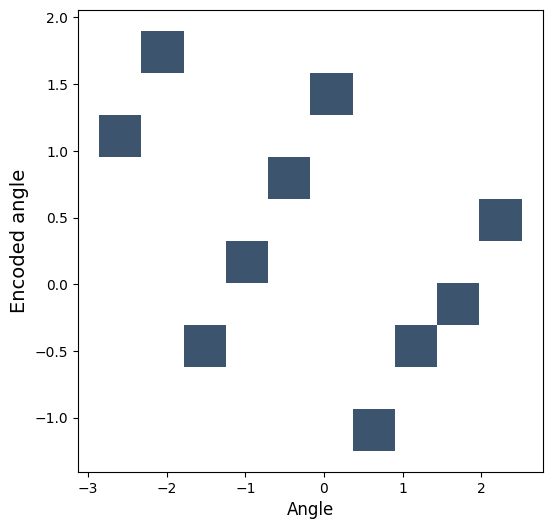

In [849]:
plt.figure(figsize=(6, 6))
plt.xlabel("Angle", fontsize=12)
plt.ylabel("Encoded angle", fontsize=14)
ax = sns.histplot(x=angles[0:10], y=corrected[0:10], bins=10 )  # pthresh=.1

# Adiciona uma linha perfeita entre x e y
# Supondo uma relação linear, você pode usar np.polyfit para isso
#coefficients = np.polyfit(angles, z_mean[:, 0], 1) # Ajusta uma linha (polinômio de grau 1)
#polynomial = np.poly1d(coefficients)
#ys = polynomial(angles)

# Plota a linha no gráfico
#plt.plot(angles, ys, color='red')


# Adiciona a segunda linha que conecta pontos onde x é igual a y
# Determina o menor e o maior valor entre os dados de x e y para o intervalo da linha
min_val = min(min(angles), min(z_mean[:, 0]))
max_val = max(max(angles), max(z_mean[:, 0]))

# Cria uma sequência de pontos para a linha
line_points = np.linspace(min_val, max_val, 100)

# Plota a linha no gráfico
#plt.plot(line_points, line_points, color='blue', linestyle='--')

In [850]:
#train_data[0].unsqueeze(0)


tensor([ 1.0347,  1.0147,  0.9882,  0.9698,  1.0245,  0.9751, -0.7207, -0.7328,
        -0.7387, -0.7536, -4.1525, -4.1829,  4.7759,  4.8411,  4.8310,  4.7671,
         4.8034, -4.1233, -4.1482, -4.1573,  4.1457, -3.2002, -3.2142, -3.1971,
        -3.2117, -3.1763,  4.0735,  4.1175,  4.1017,  4.1209,  3.9314,  3.9004,
        -3.1888, -3.1769, -3.1527, -3.1882,  3.8961,  3.9410,  3.8748,  3.8705,
         2.2483,  2.2141, -2.2849, -2.3010, -2.2582, -2.3247, -2.2781,  2.2613,
         2.2287,  2.2509, -0.4305, -0.4840, -0.4962, -0.4563,  0.1091,  0.2033,
         0.1209,  0.1629,  0.1574,  0.1646,  1.4552,  1.5001, -1.2409, -1.2650,
        -1.2967, -1.2814, -1.2685,  1.4761,  1.5021,  1.4992,  3.3559,  3.3108,
        -3.1379, -3.0932, -3.0648, -3.0963,  3.3111,  3.3405,  3.3140,  3.2952,
         2.7946,  2.8196,  2.7716,  2.7988, -1.8271, -1.8473, -1.8390, -1.8513,
        -1.8440,  2.7982, -3.2381, -3.2992, -3.2577, -3.2457, -3.2559,  3.4727,
         3.4358,  3.4654,  3.4909,  3.51

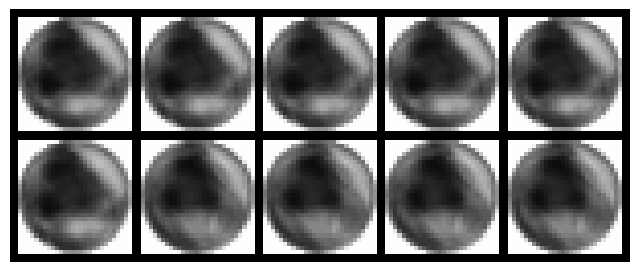

tensor([ 1.0347,  1.0147,  0.9882,  0.9698,  1.0245,  0.9751, -0.7207, -0.7328,
        -0.7387, -0.7536, -4.1525, -4.1829,  4.7759,  4.8411,  4.8310,  4.7671,
         4.8034, -4.1233, -4.1482, -4.1573,  4.1457, -3.2002, -3.2142, -3.1971,
        -3.2117, -3.1763,  4.0735,  4.1175,  4.1017,  4.1209,  3.9314,  3.9004,
        -3.1888, -3.1769, -3.1527, -3.1882,  3.8961,  3.9410,  3.8748,  3.8705,
         2.2483,  2.2141, -2.2849, -2.3010, -2.2582, -2.3247, -2.2781,  2.2613,
         2.2287,  2.2509, -0.4305, -0.4840, -0.4962, -0.4563,  0.1091,  0.2033,
         0.1209,  0.1629,  0.1574,  0.1646,  1.4552,  1.5001, -1.2409, -1.2650,
        -1.2967, -1.2814, -1.2685,  1.4761,  1.5021,  1.4992,  3.3559,  3.3108,
        -3.1379, -3.0932, -3.0648, -3.0963,  3.3111,  3.3405,  3.3140,  3.2952,
         2.7946,  2.8196,  2.7716,  2.7988, -1.8271, -1.8473, -1.8390, -1.8513,
        -1.8440,  2.7982, -3.2381, -3.2992, -3.2577, -3.2457, -3.2559,  3.4727,
         3.4358,  3.4654,  3.4909,  3.51

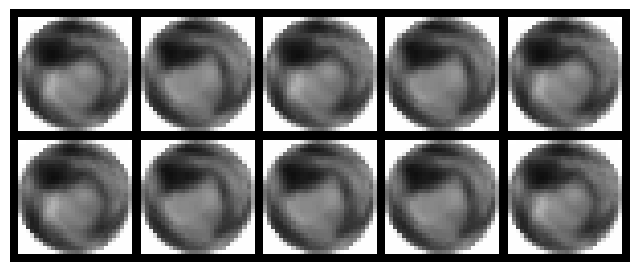

tensor([ 1.0347,  1.0147,  0.9882,  0.9698,  1.0245,  0.9751, -0.7207, -0.7328,
        -0.7387, -0.7536, -4.1525, -4.1829,  4.7759,  4.8411,  4.8310,  4.7671,
         4.8034, -4.1233, -4.1482, -4.1573,  4.1457, -3.2002, -3.2142, -3.1971,
        -3.2117, -3.1763,  4.0735,  4.1175,  4.1017,  4.1209,  3.9314,  3.9004,
        -3.1888, -3.1769, -3.1527, -3.1882,  3.8961,  3.9410,  3.8748,  3.8705,
         2.2483,  2.2141, -2.2849, -2.3010, -2.2582, -2.3247, -2.2781,  2.2613,
         2.2287,  2.2509, -0.4305, -0.4840, -0.4962, -0.4563,  0.1091,  0.2033,
         0.1209,  0.1629,  0.1574,  0.1646,  1.4552,  1.5001, -1.2409, -1.2650,
        -1.2967, -1.2814, -1.2685,  1.4761,  1.5021,  1.4992,  3.3559,  3.3108,
        -3.1379, -3.0932, -3.0648, -3.0963,  3.3111,  3.3405,  3.3140,  3.2952,
         2.7946,  2.8196,  2.7716,  2.7988, -1.8271, -1.8473, -1.8390, -1.8513,
        -1.8440,  2.7982, -3.2381, -3.2992, -3.2577, -3.2457, -3.2559,  3.4727,
         3.4358,  3.4654,  3.4909,  3.51

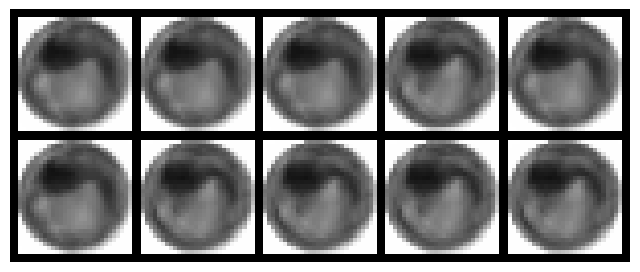

tensor([ 1.0347,  1.0147,  0.9882,  0.9698,  1.0245,  0.9751, -0.7207, -0.7328,
        -0.7387, -0.7536, -4.1525, -4.1829,  4.7759,  4.8411,  4.8310,  4.7671,
         4.8034, -4.1233, -4.1482, -4.1573,  4.1457, -3.2002, -3.2142, -3.1971,
        -3.2117, -3.1763,  4.0735,  4.1175,  4.1017,  4.1209,  3.9314,  3.9004,
        -3.1888, -3.1769, -3.1527, -3.1882,  3.8961,  3.9410,  3.8748,  3.8705,
         2.2483,  2.2141, -2.2849, -2.3010, -2.2582, -2.3247, -2.2781,  2.2613,
         2.2287,  2.2509, -0.4305, -0.4840, -0.4962, -0.4563,  0.1091,  0.2033,
         0.1209,  0.1629,  0.1574,  0.1646,  1.4552,  1.5001, -1.2409, -1.2650,
        -1.2967, -1.2814, -1.2685,  1.4761,  1.5021,  1.4992,  3.3559,  3.3108,
        -3.1379, -3.0932, -3.0648, -3.0963,  3.3111,  3.3405,  3.3140,  3.2952,
         2.7946,  2.8196,  2.7716,  2.7988, -1.8271, -1.8473, -1.8390, -1.8513,
        -1.8440,  2.7982, -3.2381, -3.2992, -3.2577, -3.2457, -3.2559,  3.4727,
         3.4358,  3.4654,  3.4909,  3.51

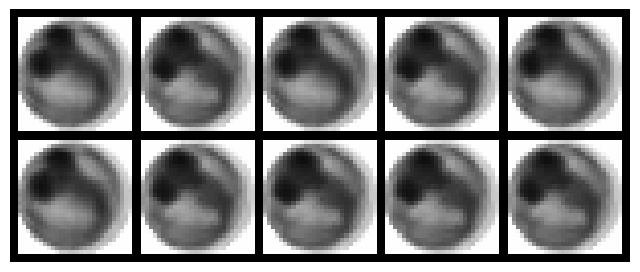

tensor([ 1.0347,  1.0147,  0.9882,  0.9698,  1.0245,  0.9751, -0.7207, -0.7328,
        -0.7387, -0.7536, -4.1525, -4.1829,  4.7759,  4.8411,  4.8310,  4.7671,
         4.8034, -4.1233, -4.1482, -4.1573,  4.1457, -3.2002, -3.2142, -3.1971,
        -3.2117, -3.1763,  4.0735,  4.1175,  4.1017,  4.1209,  3.9314,  3.9004,
        -3.1888, -3.1769, -3.1527, -3.1882,  3.8961,  3.9410,  3.8748,  3.8705,
         2.2483,  2.2141, -2.2849, -2.3010, -2.2582, -2.3247, -2.2781,  2.2613,
         2.2287,  2.2509, -0.4305, -0.4840, -0.4962, -0.4563,  0.1091,  0.2033,
         0.1209,  0.1629,  0.1574,  0.1646,  1.4552,  1.5001, -1.2409, -1.2650,
        -1.2967, -1.2814, -1.2685,  1.4761,  1.5021,  1.4992,  3.3559,  3.3108,
        -3.1379, -3.0932, -3.0648, -3.0963,  3.3111,  3.3405,  3.3140,  3.2952,
         2.7946,  2.8196,  2.7716,  2.7988, -1.8271, -1.8473, -1.8390, -1.8513,
        -1.8440,  2.7982, -3.2381, -3.2992, -3.2577, -3.2457, -3.2559,  3.4727,
         3.4358,  3.4654,  3.4909,  3.51

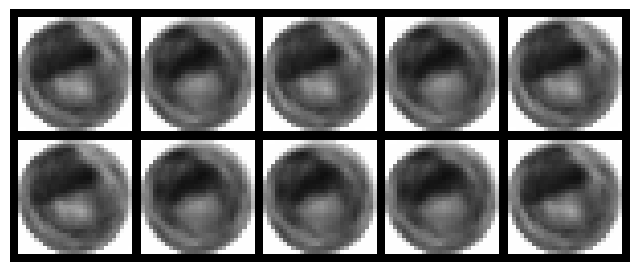

tensor([ 1.0347,  1.0147,  0.9882,  0.9698,  1.0245,  0.9751, -0.7207, -0.7328,
        -0.7387, -0.7536, -4.1525, -4.1829,  4.7759,  4.8411,  4.8310,  4.7671,
         4.8034, -4.1233, -4.1482, -4.1573,  4.1457, -3.2002, -3.2142, -3.1971,
        -3.2117, -3.1763,  4.0735,  4.1175,  4.1017,  4.1209,  3.9314,  3.9004,
        -3.1888, -3.1769, -3.1527, -3.1882,  3.8961,  3.9410,  3.8748,  3.8705,
         2.2483,  2.2141, -2.2849, -2.3010, -2.2582, -2.3247, -2.2781,  2.2613,
         2.2287,  2.2509, -0.4305, -0.4840, -0.4962, -0.4563,  0.1091,  0.2033,
         0.1209,  0.1629,  0.1574,  0.1646,  1.4552,  1.5001, -1.2409, -1.2650,
        -1.2967, -1.2814, -1.2685,  1.4761,  1.5021,  1.4992,  3.3559,  3.3108,
        -3.1379, -3.0932, -3.0648, -3.0963,  3.3111,  3.3405,  3.3140,  3.2952,
         2.7946,  2.8196,  2.7716,  2.7988, -1.8271, -1.8473, -1.8390, -1.8513,
        -1.8440,  2.7982, -3.2381, -3.2992, -3.2577, -3.2457, -3.2559,  3.4727,
         3.4358,  3.4654,  3.4909,  3.51

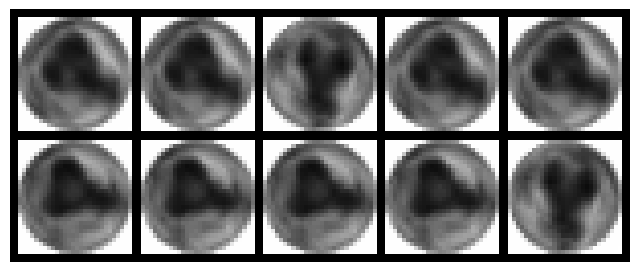

tensor([ 1.0347,  1.0147,  0.9882,  0.9698,  1.0245,  0.9751, -0.7207, -0.7328,
        -0.7387, -0.7536, -4.1525, -4.1829,  4.7759,  4.8411,  4.8310,  4.7671,
         4.8034, -4.1233, -4.1482, -4.1573,  4.1457, -3.2002, -3.2142, -3.1971,
        -3.2117, -3.1763,  4.0735,  4.1175,  4.1017,  4.1209,  3.9314,  3.9004,
        -3.1888, -3.1769, -3.1527, -3.1882,  3.8961,  3.9410,  3.8748,  3.8705,
         2.2483,  2.2141, -2.2849, -2.3010, -2.2582, -2.3247, -2.2781,  2.2613,
         2.2287,  2.2509, -0.4305, -0.4840, -0.4962, -0.4563,  0.1091,  0.2033,
         0.1209,  0.1629,  0.1574,  0.1646,  1.4552,  1.5001, -1.2409, -1.2650,
        -1.2967, -1.2814, -1.2685,  1.4761,  1.5021,  1.4992,  3.3559,  3.3108,
        -3.1379, -3.0932, -3.0648, -3.0963,  3.3111,  3.3405,  3.3140,  3.2952,
         2.7946,  2.8196,  2.7716,  2.7988, -1.8271, -1.8473, -1.8390, -1.8513,
        -1.8440,  2.7982, -3.2381, -3.2992, -3.2577, -3.2457, -3.2559,  3.4727,
         3.4358,  3.4654,  3.4909,  3.51

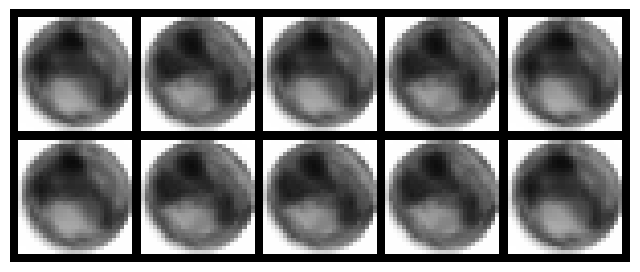

tensor([ 1.0347,  1.0147,  0.9882,  0.9698,  1.0245,  0.9751, -0.7207, -0.7328,
        -0.7387, -0.7536, -4.1525, -4.1829,  4.7759,  4.8411,  4.8310,  4.7671,
         4.8034, -4.1233, -4.1482, -4.1573,  4.1457, -3.2002, -3.2142, -3.1971,
        -3.2117, -3.1763,  4.0735,  4.1175,  4.1017,  4.1209,  3.9314,  3.9004,
        -3.1888, -3.1769, -3.1527, -3.1882,  3.8961,  3.9410,  3.8748,  3.8705,
         2.2483,  2.2141, -2.2849, -2.3010, -2.2582, -2.3247, -2.2781,  2.2613,
         2.2287,  2.2509, -0.4305, -0.4840, -0.4962, -0.4563,  0.1091,  0.2033,
         0.1209,  0.1629,  0.1574,  0.1646,  1.4552,  1.5001, -1.2409, -1.2650,
        -1.2967, -1.2814, -1.2685,  1.4761,  1.5021,  1.4992,  3.3559,  3.3108,
        -3.1379, -3.0932, -3.0648, -3.0963,  3.3111,  3.3405,  3.3140,  3.2952,
         2.7946,  2.8196,  2.7716,  2.7988, -1.8271, -1.8473, -1.8390, -1.8513,
        -1.8440,  2.7982, -3.2381, -3.2992, -3.2577, -3.2457, -3.2559,  3.4727,
         3.4358,  3.4654,  3.4909,  3.51

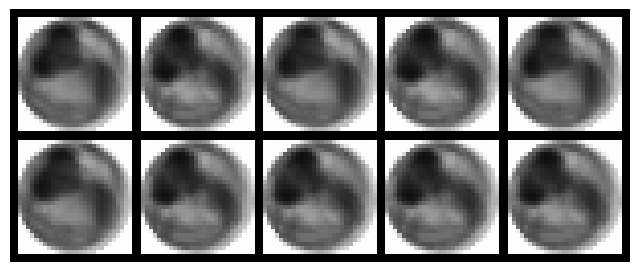

tensor([ 1.0347,  1.0147,  0.9882,  0.9698,  1.0245,  0.9751, -0.7207, -0.7328,
        -0.7387, -0.7536, -4.1525, -4.1829,  4.7759,  4.8411,  4.8310,  4.7671,
         4.8034, -4.1233, -4.1482, -4.1573,  4.1457, -3.2002, -3.2142, -3.1971,
        -3.2117, -3.1763,  4.0735,  4.1175,  4.1017,  4.1209,  3.9314,  3.9004,
        -3.1888, -3.1769, -3.1527, -3.1882,  3.8961,  3.9410,  3.8748,  3.8705,
         2.2483,  2.2141, -2.2849, -2.3010, -2.2582, -2.3247, -2.2781,  2.2613,
         2.2287,  2.2509, -0.4305, -0.4840, -0.4962, -0.4563,  0.1091,  0.2033,
         0.1209,  0.1629,  0.1574,  0.1646,  1.4552,  1.5001, -1.2409, -1.2650,
        -1.2967, -1.2814, -1.2685,  1.4761,  1.5021,  1.4992,  3.3559,  3.3108,
        -3.1379, -3.0932, -3.0648, -3.0963,  3.3111,  3.3405,  3.3140,  3.2952,
         2.7946,  2.8196,  2.7716,  2.7988, -1.8271, -1.8473, -1.8390, -1.8513,
        -1.8440,  2.7982, -3.2381, -3.2992, -3.2577, -3.2457, -3.2559,  3.4727,
         3.4358,  3.4654,  3.4909,  3.51

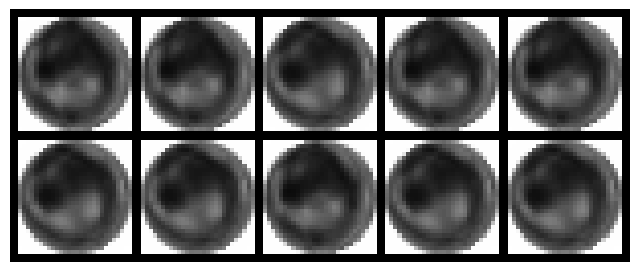

tensor([ 1.0347,  1.0147,  0.9882,  0.9698,  1.0245,  0.9751, -0.7207, -0.7328,
        -0.7387, -0.7536, -4.1525, -4.1829,  4.7759,  4.8411,  4.8310,  4.7671,
         4.8034, -4.1233, -4.1482, -4.1573,  4.1457, -3.2002, -3.2142, -3.1971,
        -3.2117, -3.1763,  4.0735,  4.1175,  4.1017,  4.1209,  3.9314,  3.9004,
        -3.1888, -3.1769, -3.1527, -3.1882,  3.8961,  3.9410,  3.8748,  3.8705,
         2.2483,  2.2141, -2.2849, -2.3010, -2.2582, -2.3247, -2.2781,  2.2613,
         2.2287,  2.2509, -0.4305, -0.4840, -0.4962, -0.4563,  0.1091,  0.2033,
         0.1209,  0.1629,  0.1574,  0.1646,  1.4552,  1.5001, -1.2409, -1.2650,
        -1.2967, -1.2814, -1.2685,  1.4761,  1.5021,  1.4992,  3.3559,  3.3108,
        -3.1379, -3.0932, -3.0648, -3.0963,  3.3111,  3.3405,  3.3140,  3.2952,
         2.7946,  2.8196,  2.7716,  2.7988, -1.8271, -1.8473, -1.8390, -1.8513,
        -1.8440,  2.7982, -3.2381, -3.2992, -3.2577, -3.2457, -3.2559,  3.4727,
         3.4358,  3.4654,  3.4909,  3.51

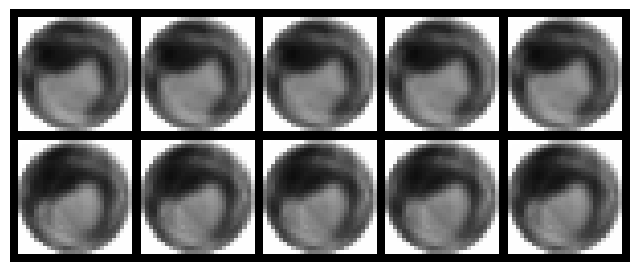

In [851]:
for i in range(0, 10):
  z_mean, z_sd = rvae.encode(train_data)
  rvae.random_samples_from_latent(z_mean, z_sd, 10, train_labels, target_label=i, cmap='gray')


In [852]:
#originals_angle = (z_mean[train_labels == 0])
#originals_images = (train_data[train_labels == 1])



In [853]:
#originals_images.shape

In [854]:
#originals_angle = originals_angle[:, 0]


In [855]:
#z_inv.shape

tensor([ 1.0347,  1.0147,  0.9882,  0.9698,  1.0245,  0.9751, -0.7207, -0.7328,
        -0.7387, -0.7536])
inv
inv
inv
inv


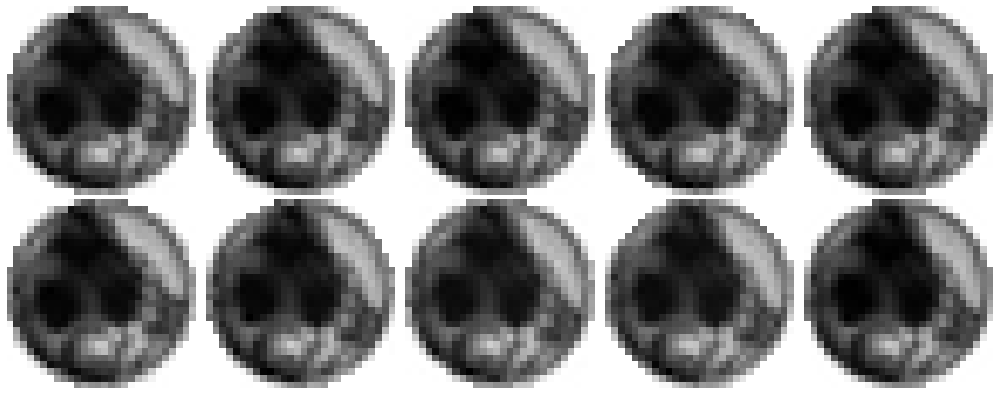

In [856]:
the_label = 0
import matplotlib.pyplot as plt
import torch
from PIL import Image
import numpy as np
# Suponha que 'originals' é o seu tensor de imagens e 'primeiros_valores' é o tensor de ângulos em radianos
n_imagens, altura, largura = train_data.shape[:3]
indices = np.where(train_labels == the_label)[0]
filtered_images = train_data[indices]
z_mean, z_sd = rvae.encode(filtered_images)
z_inv = z_mean[:, -1]
print(z_inv)

# Criar uma figura com subplots (2 linhas, 5 colunas)
fig, axes = plt.subplots(2, 5, figsize=(15, 6))
axes = axes.flatten()
# Plotar as primeiras 10 imagens com rotação
for index, the_mean in enumerate(filtered_images):
    ax = axes[index]
    imagem = filtered_images[index]
    # Converter a imagem normalizada para a escala de 0 a 255
    imagem = (imagem * 255).byte().numpy()

    # Converter de numpy array para imagem PIL
    pil_imagem = Image.fromarray(imagem)

    # Converter ângulo de radianos para graus e rotacionar
    angulo_graus = np.degrees(corrected[index].item())
    #z_inv
    pil_imagem_rotacionada = pil_imagem.rotate(angulo_graus*-1, fillcolor="white", resample=Image.BICUBIC)
    if z_inv[index] < 0:
      print("inv")
      pil_imagem_rotacionada = pil_imagem_rotacionada.rotate(180, fillcolor="white")
    # Plotar a imagem rotacionada
    ax.imshow(pil_imagem_rotacionada, cmap='gray')
    ax.axis('off')

plt.tight_layout()
plt.show()


torch.Size([1000, 28, 28])
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1000 samples in 0.001s...
[t-SNE] Computed neighbors for 1000 samples in 0.077s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1000
[t-SNE] Mean sigma: 1.430704
[t-SNE] KL divergence after 50 iterations with early exaggeration: 66.582344
[t-SNE] KL divergence after 600 iterations: 1.558577


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



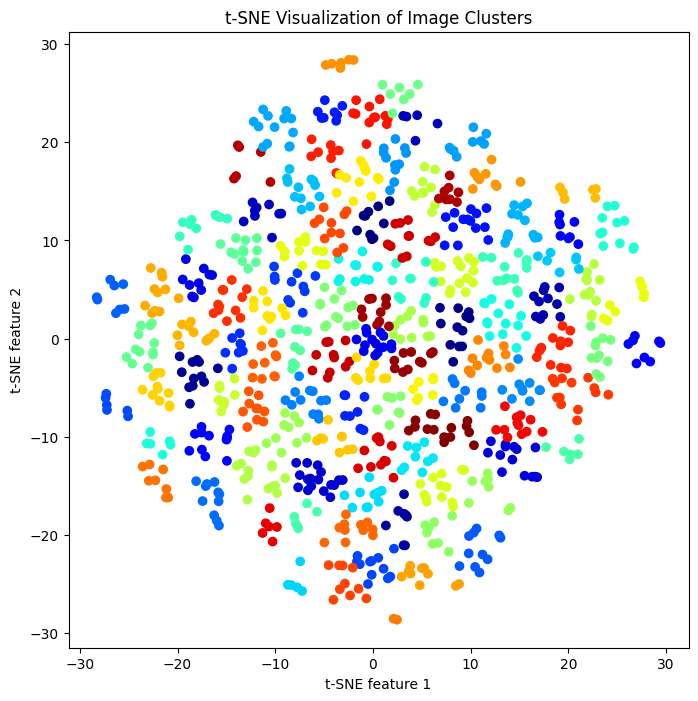

In [857]:
import torch
import numpy as np
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
tensor_images_few = train_data[0:1000]
print(tensor_images_few.shape)
# Supondo que 'tensor_images' seja o seu tensor de imagens em escala de cinza [N, H, W]
# Primeiro, você precisará remodelar o tensor para [N, H*W] para obter um conjunto de dados 2D
N, H, W = tensor_images_few.shape
images_reshaped = tensor_images_few.reshape(N, H*W)

# Normalizar os dados
images_reshaped = images_reshaped - images_reshaped.min()
images_reshaped = images_reshaped / images_reshaped.max()

# Reduzir a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=600)
tsne_results = tsne.fit_transform(images_reshaped)

# Aplicar K-means clustering
kmeans = KMeans(n_clusters=100)  # Escolha o número de clusters que você espera encontrar
cluster_labels = kmeans.fit_predict(tsne_results)

# Visualizar os resultados
plt.figure(figsize=(8, 8))
scatter = plt.scatter(tsne_results[:, 0], tsne_results[:, 1], c=cluster_labels, cmap='jet')
plt.title('t-SNE Visualization of Image Clusters')
plt.xlabel('t-SNE feature 1')
plt.ylabel('t-SNE feature 2')

# Definir o colormap
cmap = plt.get_cmap('jet')



plt.show()

[t-SNE] Computing 22 nearest neighbors...
[t-SNE] Indexed 1000 samples in 0.001s...
[t-SNE] Computed neighbors for 1000 samples in 0.073s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1000
[t-SNE] Mean sigma: 1.044039
[t-SNE] KL divergence after 250 iterations with early exaggeration: 85.431389
[t-SNE] KL divergence after 1300 iterations: 1.682922


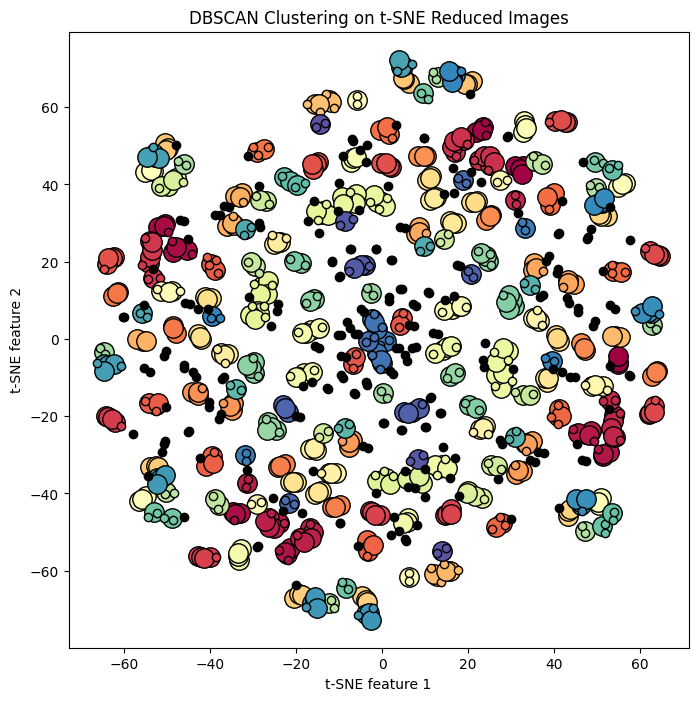

Número estimado de clusters: 189


In [858]:
import torch
import numpy as np
from sklearn.manifold import TSNE
from sklearn.cluster import DBSCAN
import matplotlib.pyplot as plt

# Supondo que 'tensor_de_tensores' seja o seu tensor de imagens em escala de cinza [N, H, W]
tensor_images_few = train_data[0:1000]

# Primeiro, você precisará remodelar o tensor para [N, H*W] para obter um conjunto de dados 2D
N, H, W = tensor_images_few.shape
images_reshaped = tensor_images_few.reshape(N, H*W)

# Normalizar os dados
images_reshaped = images_reshaped - images_reshaped.min()
images_reshaped = images_reshaped / images_reshaped.max()

# Reduzir a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, verbose=1, perplexity=7, n_iter=1300)
tsne_results = tsne.fit_transform(images_reshaped)

# Aplicar DBSCAN clustering
dbscan = DBSCAN(eps=2, min_samples=3)  # Ajuste os parâmetros conforme necessário
dbscan.fit(tsne_results)

# Visualizar os resultados
plt.figure(figsize=(8, 8))

# Cores para os clusters e ruídos
core_samples_mask = np.zeros_like(dbscan.labels_, dtype=bool)
core_samples_mask[dbscan.core_sample_indices_] = True
labels = dbscan.labels_

# Plot
unique_labels = set(labels)
colors = [plt.cm.Spectral(each) for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Pontos de ruído são marcados com preto
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)

    # Plot dos pontos do núcleo
    xy = tsne_results[class_member_mask & core_samples_mask]
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col), markeredgecolor='k', markersize=14)

    # Plot dos pontos de borda
    xy = tsne_results[class_member_mask & ~core_samples_mask]
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col), markeredgecolor='k', markersize=6)

plt.title('DBSCAN Clustering on t-SNE Reduced Images')
plt.xlabel('t-SNE feature 1')
plt.ylabel('t-SNE feature 2')
plt.show()

labels = dbscan.labels_
# Número de clusters é o número de rótulos únicos excluindo o ruído (-1)
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
print(f'Número estimado de clusters: {n_clusters_}')

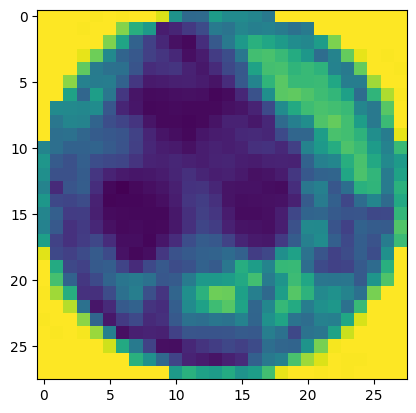

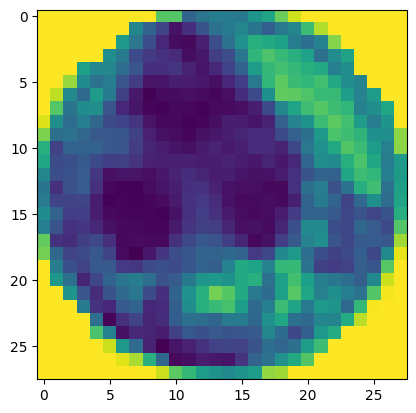

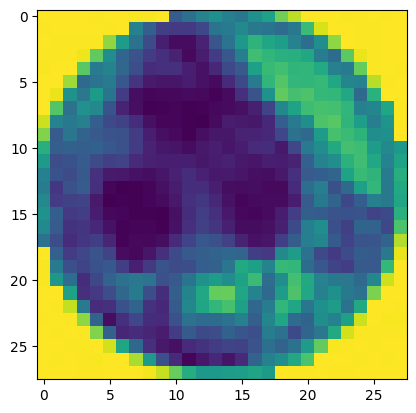

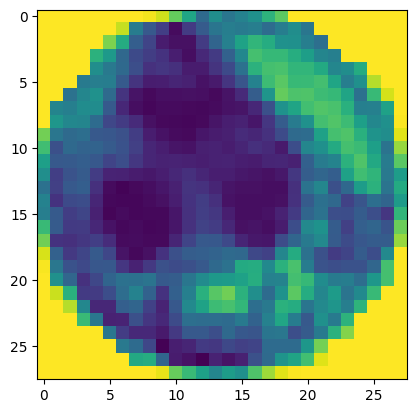

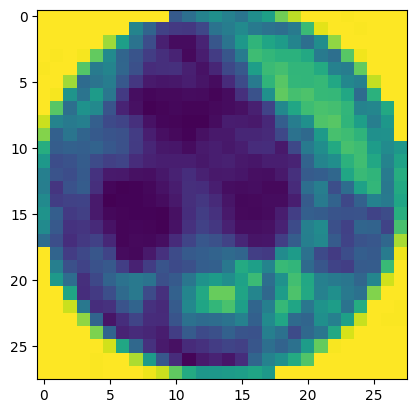

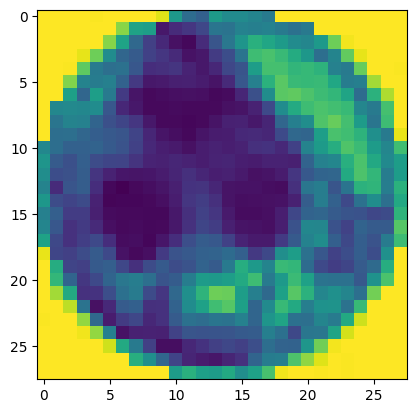

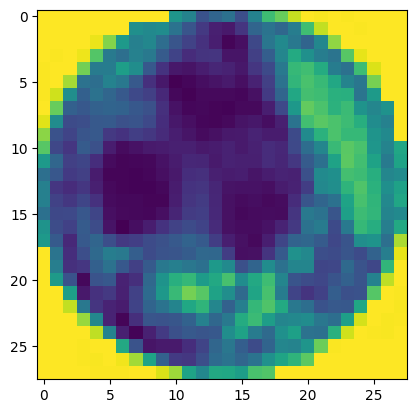

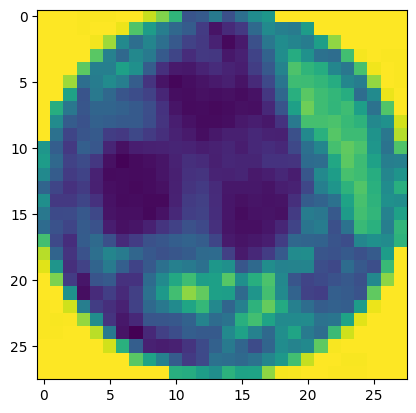

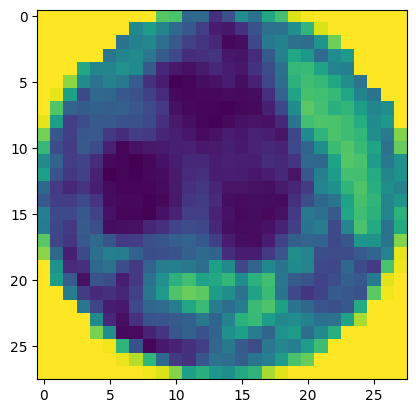

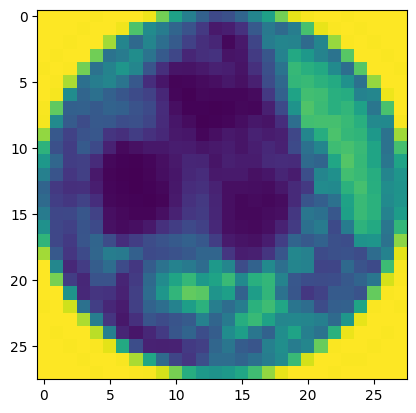

<Figure size 640x480 with 0 Axes>

In [859]:

import matplotlib.pyplot as plt
import torch
from PIL import Image
import numpy as np
# Suponha que 'originals' é o seu tensor de imagens e 'primeiros_valores' é o tensor de ângulos em radianos
n_imagens, altura, largura = train_data.shape[:3]

transform = transforms.Compose([
    transforms.ToTensor(),  # Converte a imagem em um tensor
])


z_mean, z_sd = rvae.encode(train_data)
z_inv = z_mean[:, -1]
z_angle = z_mean[:, 0]

corrected_images = []
for index, the_angle in enumerate(z_angle):
    #print(the_angle)
    rot = z_angle[index].item()*-1 if z_inv[index].item() > 0 else (z_angle[index].item()*-1)+3
    #rot = z_angle[index].item()*-1

    # Converter a imagem normalizada para a escala de 0 a 255
    imagem = (train_data[index] * 255).byte().numpy()

    # Converter de numpy array para imagem PIL
    pil_imagem = Image.fromarray(imagem)

    # Converter ângulo de radianos para graus e rotacionar
    angulo_graus = np.degrees(rot)

    pil_imagem_rotacionada = pil_imagem.rotate(angulo_graus, fillcolor="white", resample=Image.BICUBIC)

    tensor_imagem = transform(pil_imagem_rotacionada)


    corrected_images.append(tensor_imagem[0])

    if index < 10:
        # Plotar a imagem usando o Matplotlib
        plt.imshow(pil_imagem_rotacionada)

        # Exibir a imagem
        plt.show()


tensor_de_tensores = torch.stack(corrected_images)


plt.tight_layout()
plt.show()


torch.Size([1000, 28, 28])
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1000 samples in 0.001s...
[t-SNE] Computed neighbors for 1000 samples in 0.071s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1000
[t-SNE] Mean sigma: 2.103085
[t-SNE] KL divergence after 250 iterations with early exaggeration: 66.572067
[t-SNE] KL divergence after 600 iterations: 0.447955


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



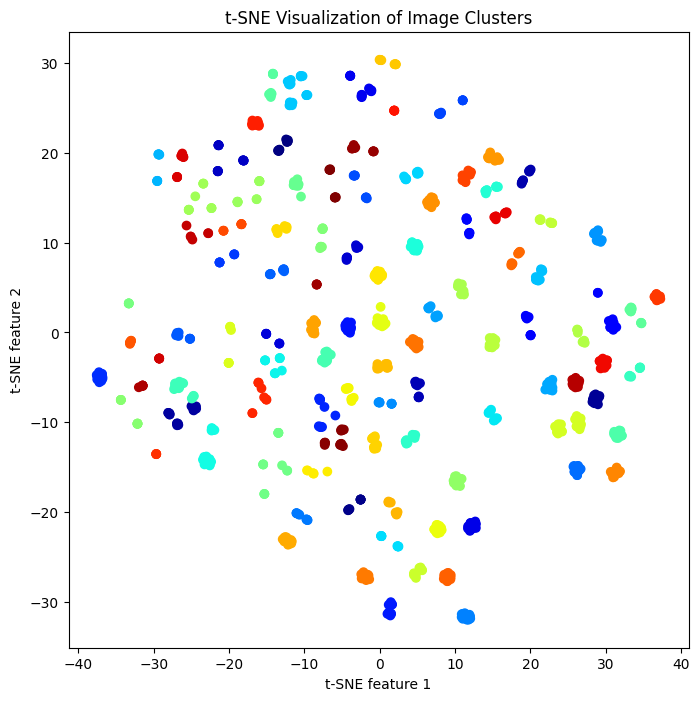

In [860]:
import torch
import numpy as np
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

print(tensor_de_tensores.shape)


tensor_images_few = tensor_de_tensores[0:1000]

# Supondo que 'tensor_images' seja o seu tensor de imagens em escala de cinza [N, H, W]
# Primeiro, você precisará remodelar o tensor para [N, H*W] para obter um conjunto de dados 2D
N, H, W = tensor_images_few.shape
images_reshaped = tensor_images_few.reshape(N, H*W)

# Normalizar os dados
images_reshaped = images_reshaped - images_reshaped.min()
images_reshaped = images_reshaped / images_reshaped.max()

# Reduzir a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=600)
tsne_results = tsne.fit_transform(images_reshaped)

# Aplicar K-means clustering
kmeans = KMeans(n_clusters=100)  # Escolha o número de clusters que você espera encontrar
cluster_labels = kmeans.fit_predict(tsne_results)

# Visualizar os resultados
plt.figure(figsize=(8, 8))
scatter = plt.scatter(tsne_results[:, 0], tsne_results[:, 1], c=cluster_labels, cmap='jet')
plt.title('t-SNE Visualization of Image Clusters')
plt.xlabel('t-SNE feature 1')
plt.ylabel('t-SNE feature 2')

# Definir o colormap
cmap = plt.get_cmap('jet')

Try dbscan

[t-SNE] Computing 22 nearest neighbors...
[t-SNE] Indexed 1000 samples in 0.001s...
[t-SNE] Computed neighbors for 1000 samples in 0.052s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1000
[t-SNE] Mean sigma: 1.259287
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.055580
[t-SNE] KL divergence after 1300 iterations: 0.145136


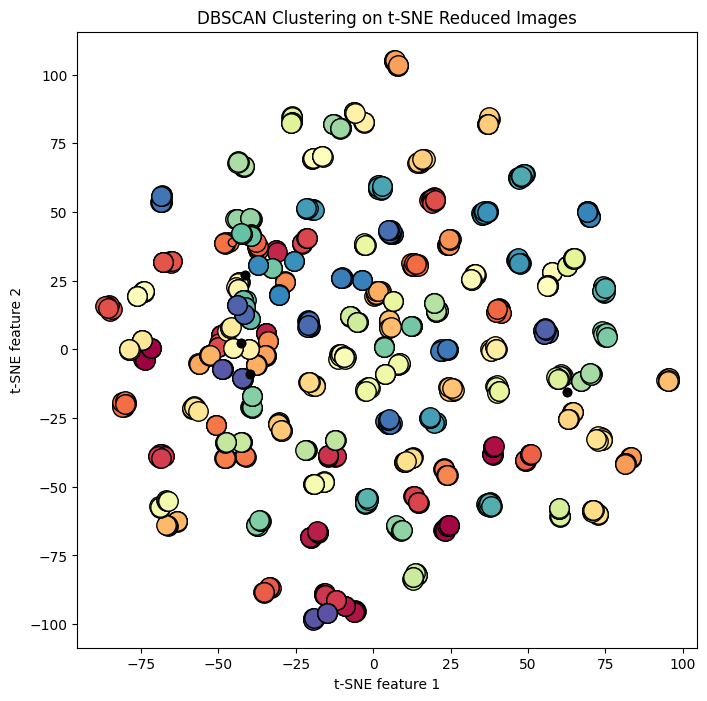

Número estimado de clusters: 158


In [861]:
import torch
import numpy as np
from sklearn.manifold import TSNE
from sklearn.cluster import DBSCAN
import matplotlib.pyplot as plt

# Supondo que 'tensor_de_tensores' seja o seu tensor de imagens em escala de cinza [N, H, W]
tensor_images_few = tensor_de_tensores[0:1000]

# Primeiro, você precisará remodelar o tensor para [N, H*W] para obter um conjunto de dados 2D
N, H, W = tensor_images_few.shape
images_reshaped = tensor_images_few.reshape(N, H*W)

# Normalizar os dados
images_reshaped = images_reshaped - images_reshaped.min()
images_reshaped = images_reshaped / images_reshaped.max()

# Reduzir a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, verbose=1, perplexity=7, n_iter=1300)
tsne_results = tsne.fit_transform(images_reshaped)

# Aplicar DBSCAN clustering
dbscan = DBSCAN(eps=2, min_samples=3)  # Ajuste os parâmetros conforme necessário
dbscan.fit(tsne_results)

# Visualizar os resultados
plt.figure(figsize=(8, 8))

# Cores para os clusters e ruídos
core_samples_mask = np.zeros_like(dbscan.labels_, dtype=bool)
core_samples_mask[dbscan.core_sample_indices_] = True
labels = dbscan.labels_

# Plot
unique_labels = set(labels)
colors = [plt.cm.Spectral(each) for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Pontos de ruído são marcados com preto
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)

    # Plot dos pontos do núcleo
    xy = tsne_results[class_member_mask & core_samples_mask]
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col), markeredgecolor='k', markersize=14)

    # Plot dos pontos de borda
    xy = tsne_results[class_member_mask & ~core_samples_mask]
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col), markeredgecolor='k', markersize=6)

plt.title('DBSCAN Clustering on t-SNE Reduced Images')
plt.xlabel('t-SNE feature 1')
plt.ylabel('t-SNE feature 2')
plt.show()

labels = dbscan.labels_
# Número de clusters é o número de rótulos únicos excluindo o ruído (-1)
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
print(f'Número estimado de clusters: {n_clusters_}')

In [862]:
import torch
from torchvision.transforms import Resize, Compose, ToPILImage, ToTensor

# Supondo que tensor_images é o seu tensor original
# Exemplo: tensor_images = torch.randn(2808, 28, 28)

# Cria uma função de transformação que primeiro converte para PIL Image, redimensiona e depois volta para tensor
transform = Compose([
    ToPILImage(),
    Resize((28, 28)),
    ToTensor()
])

# Aplica a transformação a cada imagem no tensor e remove o canal extra
tensor_images_resized = torch.stack([transform(img).squeeze(0) for img in tensor_images])

# Agora tensor_images_resized terá dimensões [2808, 23, 23]





# **Now, we are going to verigy if it is possible to aplly our trained model to new images and have some benefit in improving classification methods**

**Fisrtly, we aplly the model to new images and rotate them**

In [863]:
import matplotlib.pyplot as plt
import torch
from PIL import Image
import numpy as np
# Suponha que 'originals' é o seu tensor de imagens e 'primeiros_valores' é o tensor de ângulos em radianos
few_images = tensor_images_resized[1000:2000]
n_imagens, altura, largura = few_images.shape[:3]

transform = transforms.Compose([
    transforms.ToTensor(),  # Converte a imagem em um tensor
])


z_mean, z_sd = rvae.encode(few_images)
z_inv = z_mean[:, -1]
z_angle = z_mean[:, 0]

corrected_images_new = []
for index, the_angle in enumerate(z_angle):
    #print(the_angle)
    rot = z_angle[index].item()*-1 if z_inv[index].item() > 0 else (z_angle[index].item()*-1)+3
    #rot = z_angle[index].item()*-1

    # Converter a imagem normalizada para a escala de 0 a 255
    imagem = (few_images[index] * 255).byte().numpy()

    # Converter de numpy array para imagem PIL
    pil_imagem = Image.fromarray(imagem)

    # Converter ângulo de radianos para graus e rotacionar
    angulo_graus = np.degrees(rot)

    pil_imagem_rotacionada = pil_imagem.rotate(angulo_graus, fillcolor="white", resample=Image.BICUBIC)

    tensor_imagem = transform(pil_imagem_rotacionada)


    corrected_images_new.append(tensor_imagem[0])


tensor_de_tensores_new = torch.stack(corrected_images_new)


plt.tight_layout()
plt.show()


<Figure size 640x480 with 0 Axes>

**Now, we apply a clustering technique and plot the clusters**

torch.Size([1000, 28, 28])
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1000 samples in 0.001s...
[t-SNE] Computed neighbors for 1000 samples in 0.079s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1000
[t-SNE] Mean sigma: 1.331457
[t-SNE] KL divergence after 50 iterations with early exaggeration: 65.791328
[t-SNE] KL divergence after 600 iterations: 1.448221


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



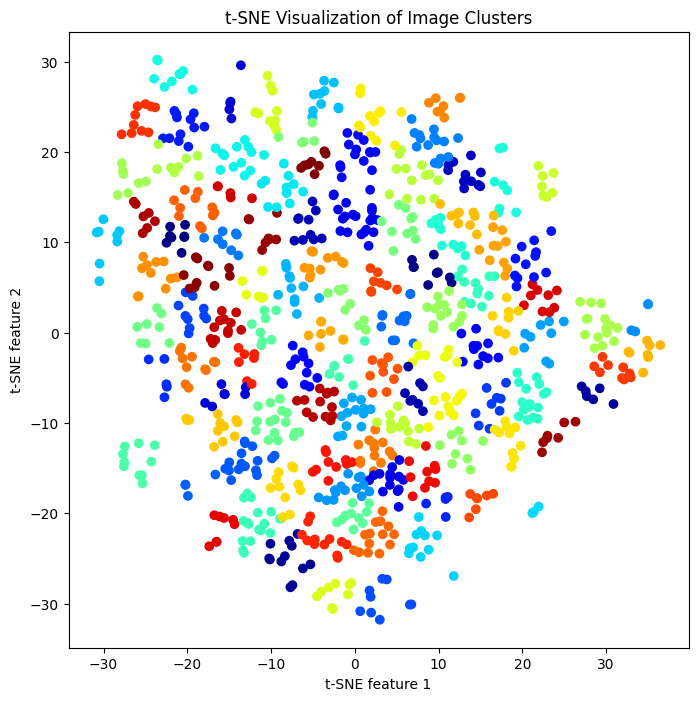

In [864]:
import torch
import numpy as np
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

print(tensor_de_tensores_new.shape)


#tensor_images_few = tensor_de_tensores[0:1000]

# Supondo que 'tensor_images' seja o seu tensor de imagens em escala de cinza [N, H, W]
# Primeiro, você precisará remodelar o tensor para [N, H*W] para obter um conjunto de dados 2D
N, H, W = tensor_de_tensores_new.shape
images_reshaped = tensor_de_tensores_new.reshape(N, H*W)

# Normalizar os dados
images_reshaped = images_reshaped - images_reshaped.min()
images_reshaped = images_reshaped / images_reshaped.max()

# Reduzir a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=600)
tsne_results = tsne.fit_transform(images_reshaped)

# Aplicar K-means clustering
kmeans = KMeans(n_clusters=100)  # Escolha o número de clusters que você espera encontrar
cluster_labels = kmeans.fit_predict(tsne_results)

# Visualizar os resultados
plt.figure(figsize=(8, 8))
scatter = plt.scatter(tsne_results[:, 0], tsne_results[:, 1], c=cluster_labels, cmap='jet')
plt.title('t-SNE Visualization of Image Clusters')
plt.xlabel('t-SNE feature 1')
plt.ylabel('t-SNE feature 2')

# Definir o colormap
cmap = plt.get_cmap('jet')

**Now, we plot the rotated images filtered by its clusters (only 100 aleatory images)**





[t-SNE] Computing 22 nearest neighbors...
[t-SNE] Indexed 1000 samples in 0.001s...
[t-SNE] Computed neighbors for 1000 samples in 0.075s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1000
[t-SNE] Mean sigma: 0.990690
[t-SNE] KL divergence after 250 iterations with early exaggeration: 84.990570
[t-SNE] KL divergence after 1300 iterations: 1.519158


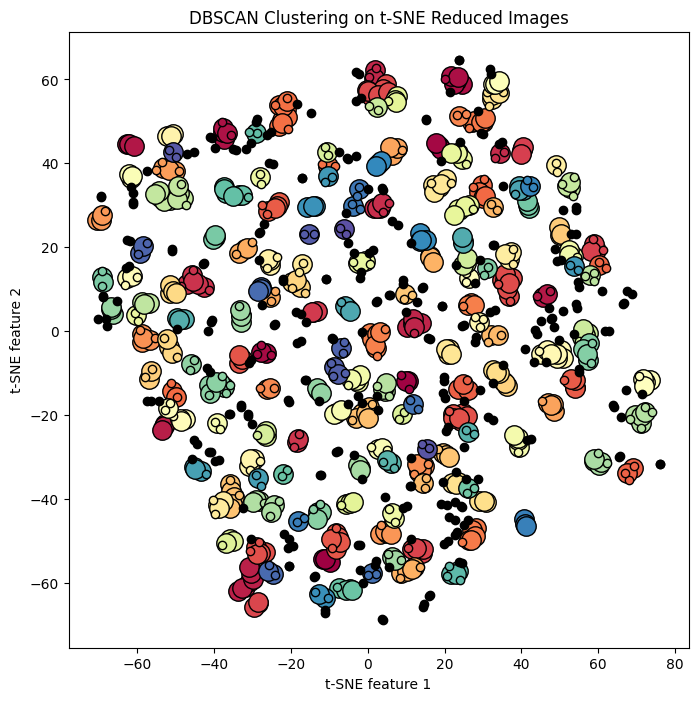

Número estimado de clusters: 167


In [865]:
import torch
import numpy as np
from sklearn.manifold import TSNE
from sklearn.cluster import DBSCAN
import matplotlib.pyplot as plt

# Supondo que 'tensor_de_tensores' seja o seu tensor de imagens em escala de cinza [N, H, W]
tensor_images_few = tensor_de_tensores_new

# Primeiro, você precisará remodelar o tensor para [N, H*W] para obter um conjunto de dados 2D
N, H, W = tensor_images_few.shape
images_reshaped = tensor_images_few.reshape(N, H*W)

# Normalizar os dados
images_reshaped = images_reshaped - images_reshaped.min()
images_reshaped = images_reshaped / images_reshaped.max()

# Reduzir a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, verbose=1, perplexity=7, n_iter=1300)
tsne_results = tsne.fit_transform(images_reshaped)

# Aplicar DBSCAN clustering
dbscan = DBSCAN(eps=2, min_samples=3)  # Ajuste os parâmetros conforme necessário
dbscan.fit(tsne_results)

# Visualizar os resultados
plt.figure(figsize=(8, 8))

# Cores para os clusters e ruídos
core_samples_mask = np.zeros_like(dbscan.labels_, dtype=bool)
core_samples_mask[dbscan.core_sample_indices_] = True
labels = dbscan.labels_

# Plot
unique_labels = set(labels)
colors = [plt.cm.Spectral(each) for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Pontos de ruído são marcados com preto
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)

    # Plot dos pontos do núcleo
    xy = tsne_results[class_member_mask & core_samples_mask]
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col), markeredgecolor='k', markersize=14)

    # Plot dos pontos de borda
    xy = tsne_results[class_member_mask & ~core_samples_mask]
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col), markeredgecolor='k', markersize=6)

plt.title('DBSCAN Clustering on t-SNE Reduced Images')
plt.xlabel('t-SNE feature 1')
plt.ylabel('t-SNE feature 2')
plt.show()

labels = dbscan.labels_
# Número de clusters é o número de rótulos únicos excluindo o ruído (-1)
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
print(f'Número estimado de clusters: {n_clusters_}')

In [866]:
import plotly.express as px

fig = px.scatter(x=tsne_results[:, 0], y=tsne_results[:, 1], color=labels.astype(str),
                 labels={'color': 'Cluster label'})

# Atualizar o layout do gráfico com os intervalos definidos
fig.update_layout(
    xaxis=dict(range=[-50, 50], autorange=False),
    yaxis=dict(range=[-50, 50], autorange=False, scaleanchor="x", scaleratio=1),
)

fig.show()




In [867]:
import numpy as np

# 'labels' contém os rótulos dos clusters atribuídos pelo DBSCAN, incluindo -1 para ruído
num_noise_points = np.sum(labels == -1)

# Contar o número único de rótulos, excluindo -1
unique_labels = set(labels) - {-1}
num_clusters = len(unique_labels)

# Calcular a proporção de pontos de ruído em relação ao número total de clusters
if num_clusters > 0:  # Evitar divisão por zero
    noise_to_cluster_ratio = num_noise_points / num_clusters
    print(f"Proporção de pontos de ruído por cluster: {noise_to_cluster_ratio:.2f}")
else:
    print("Não há clusters, apenas ruído.")


# 'labels' contém os rótulos dos clusters atribuídos pelo DBSCAN, incluindo -1 para ruído
num_noise_points = np.sum(labels == -1)

# Contar o número total de pontos que não são ruído
num_non_noise_points = np.sum(labels != -1)

# Contar o número único de rótulos, excluindo -1
unique_labels = set(labels) - {-1}
num_clusters = len(unique_labels)

# Calcular o número médio de imagens por cluster, excluindo o cluster de ruído
if num_clusters > 0:  # Evitar divisão por zero
    average_images_per_cluster = num_non_noise_points / num_clusters
    print(f"Número médio de imagens por cluster: {average_images_per_cluster:.2f}")
else:
    print("Não há clusters, apenas ruído.")



Proporção de pontos de ruído por cluster: 1.62
Número médio de imagens por cluster: 4.37


0


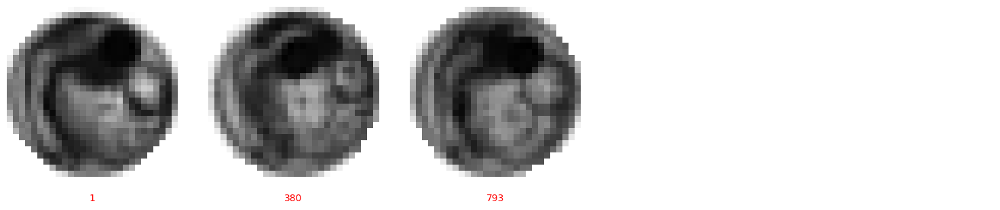

1


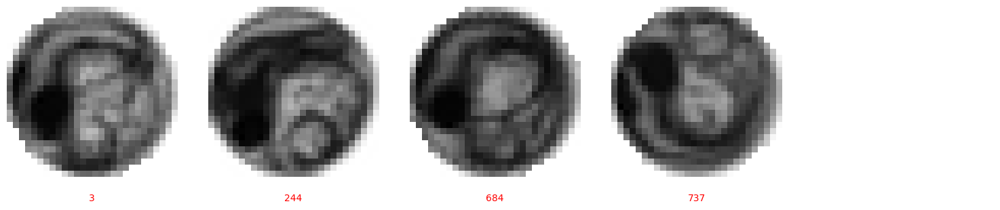

2


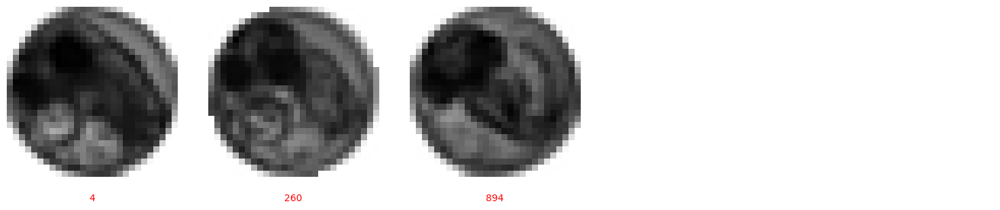

3


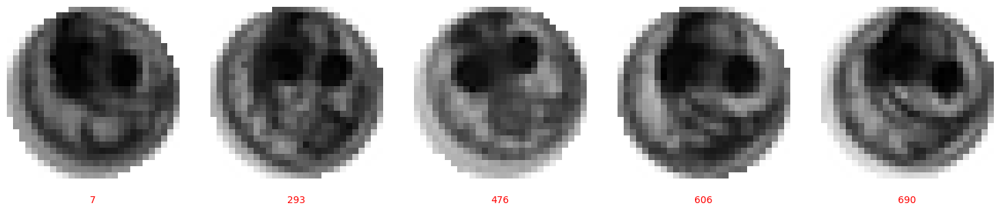

4


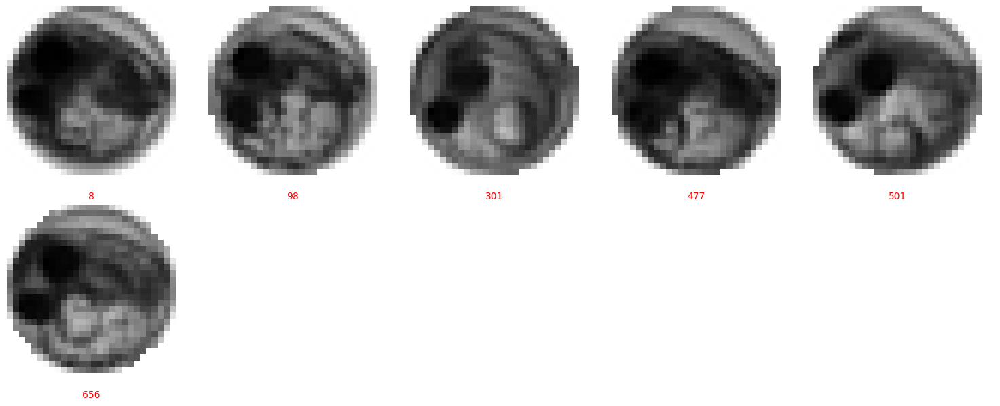

5


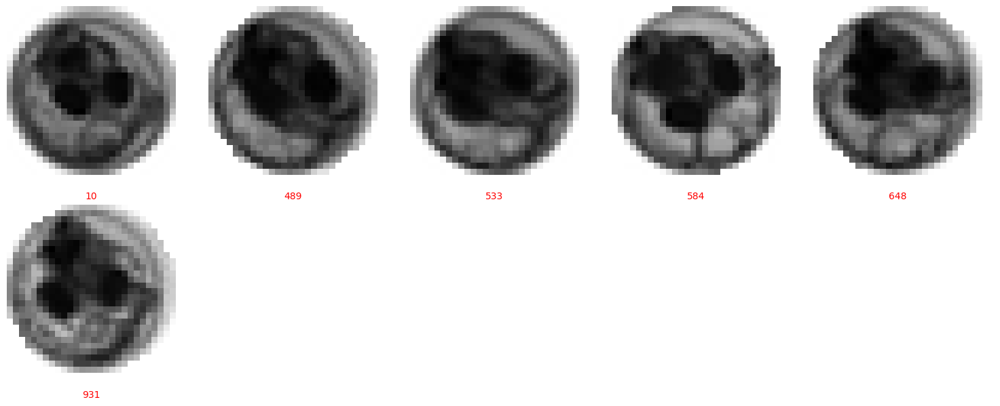

6


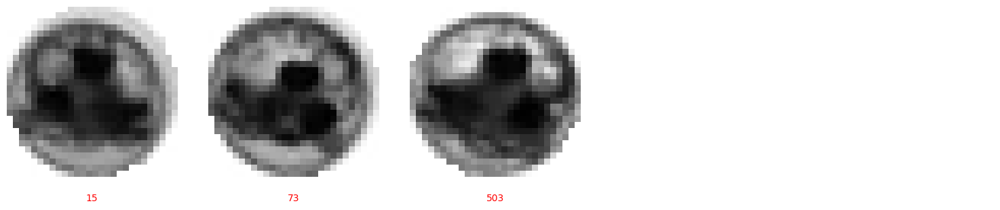

7


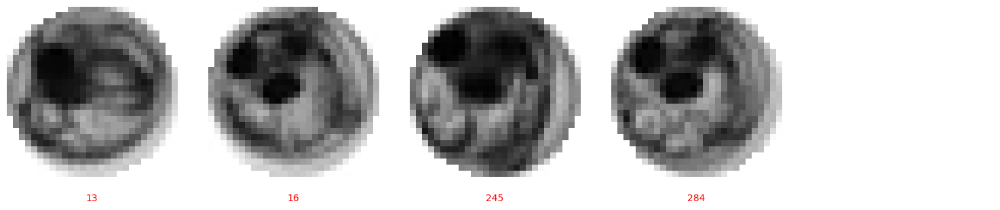

8


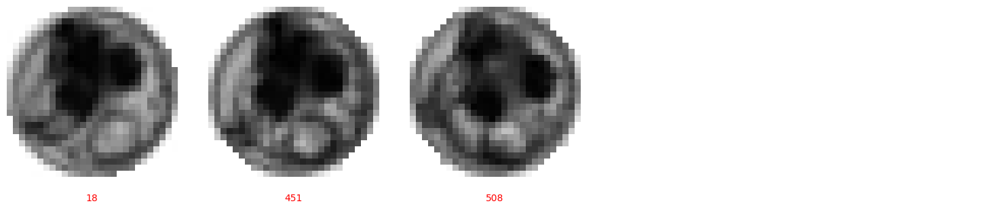

9


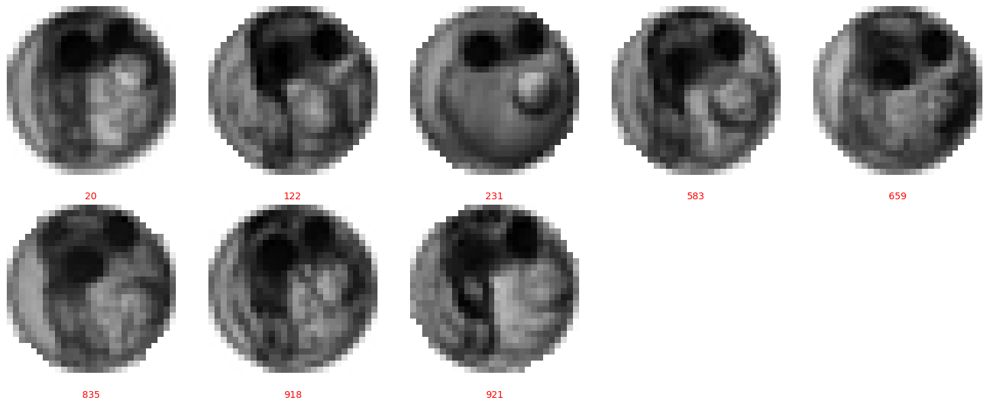

10


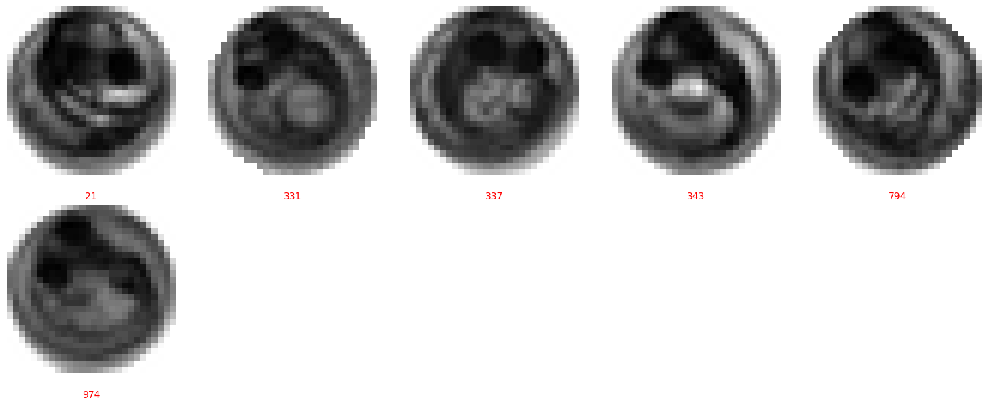

11


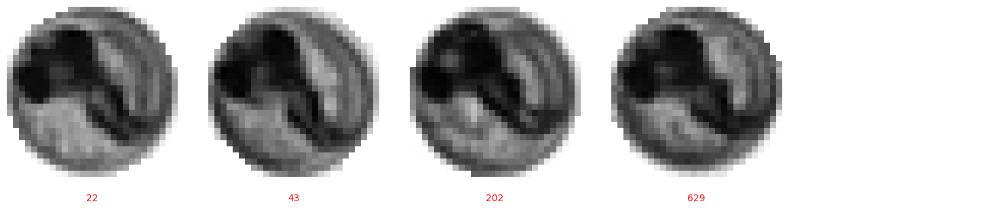

12


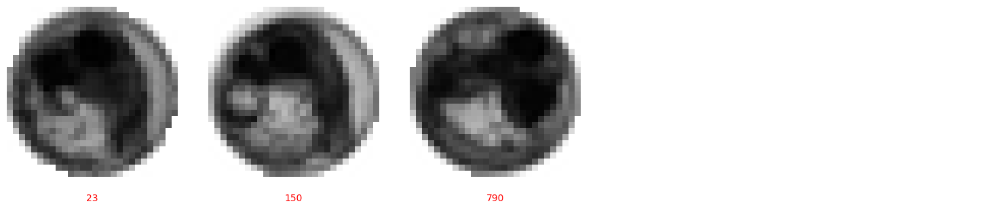

13


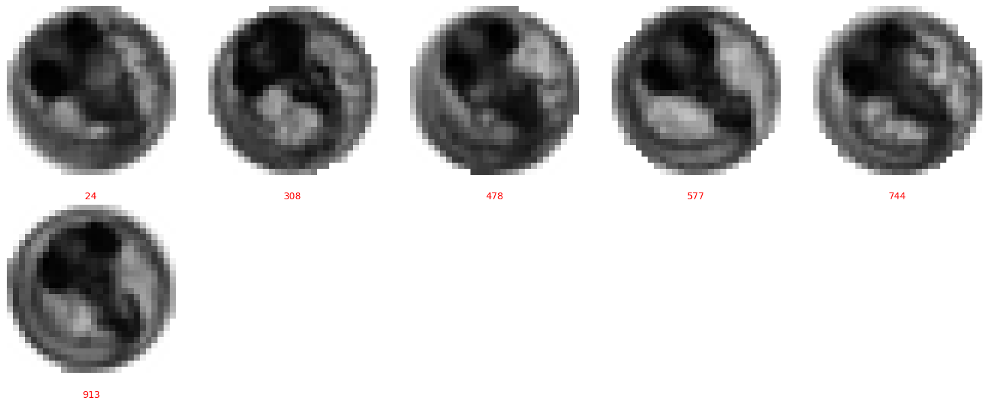

14


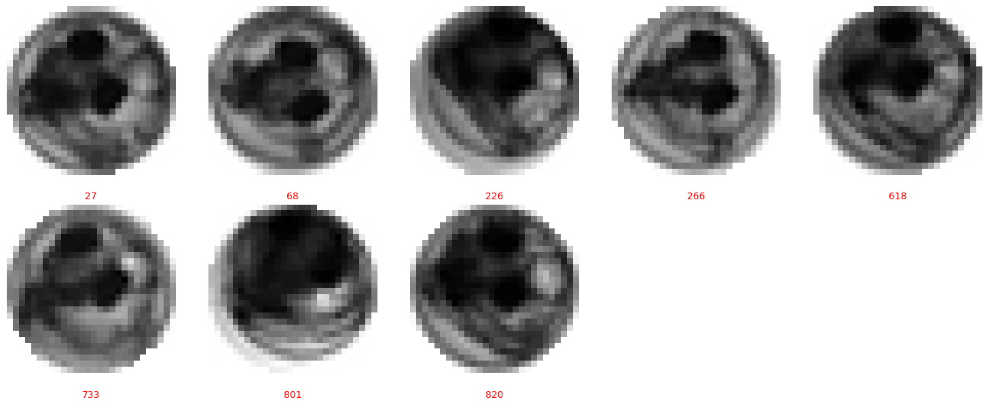

15


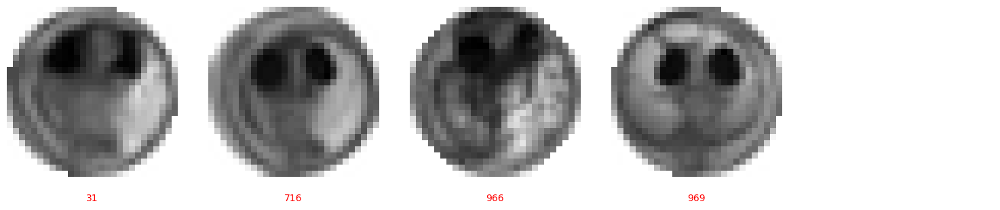

16


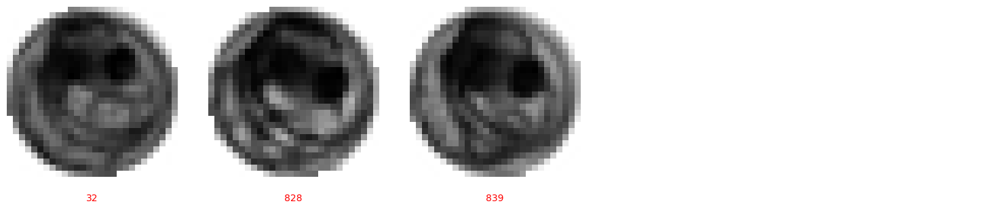

17


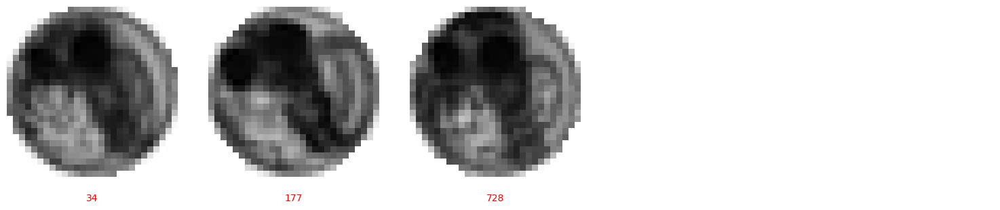

18


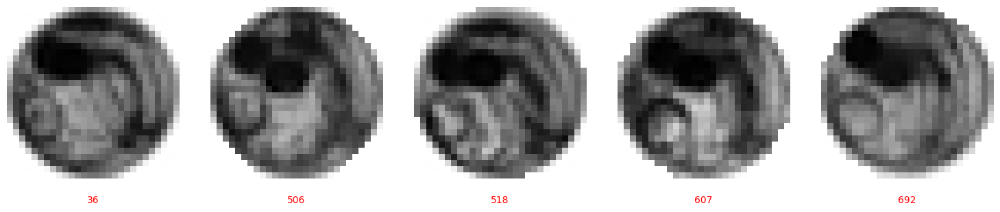

19


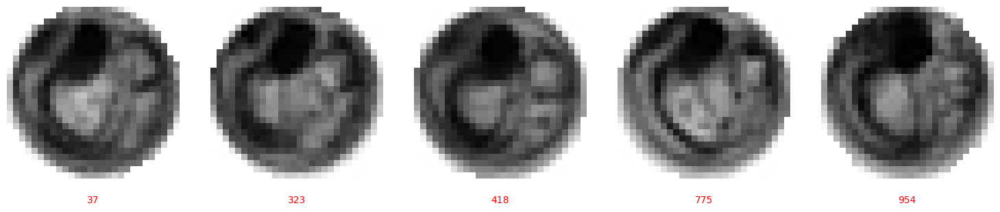

20


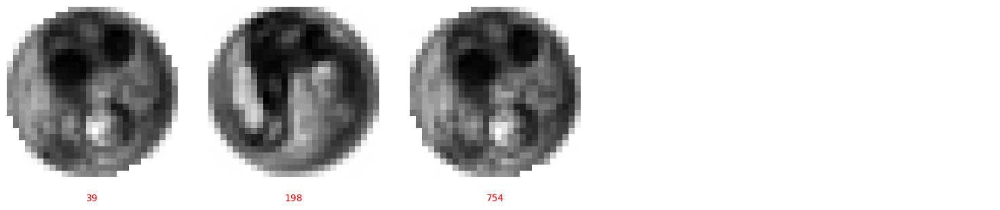

21


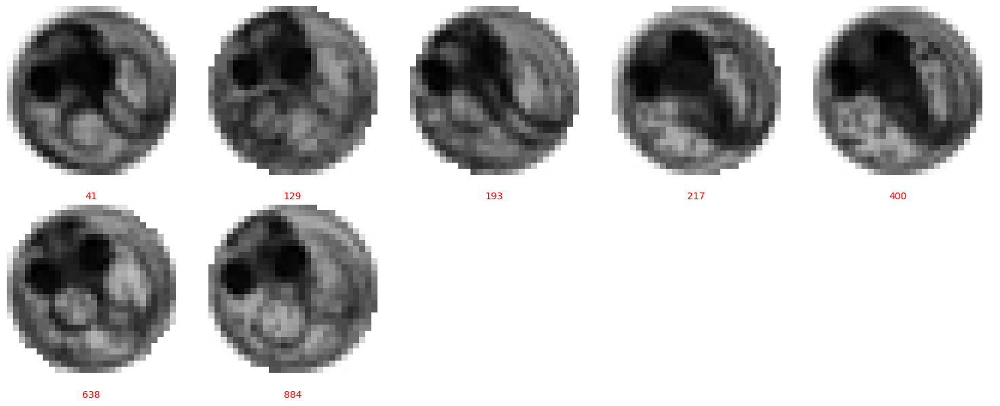

22


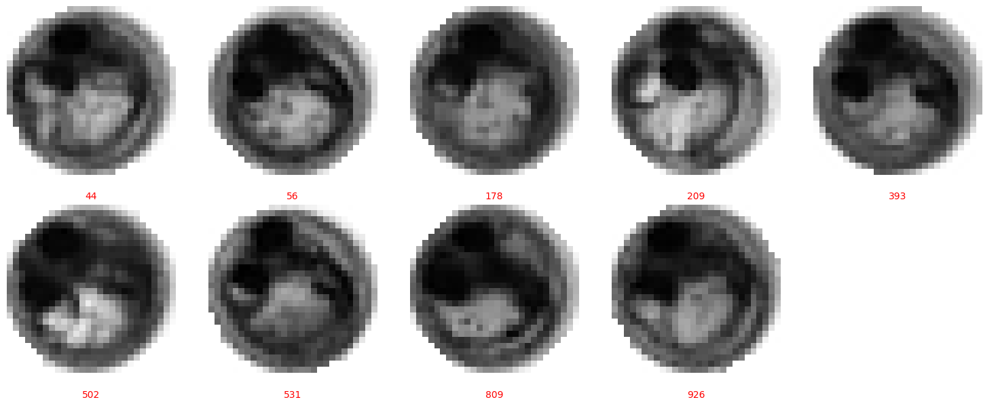

23


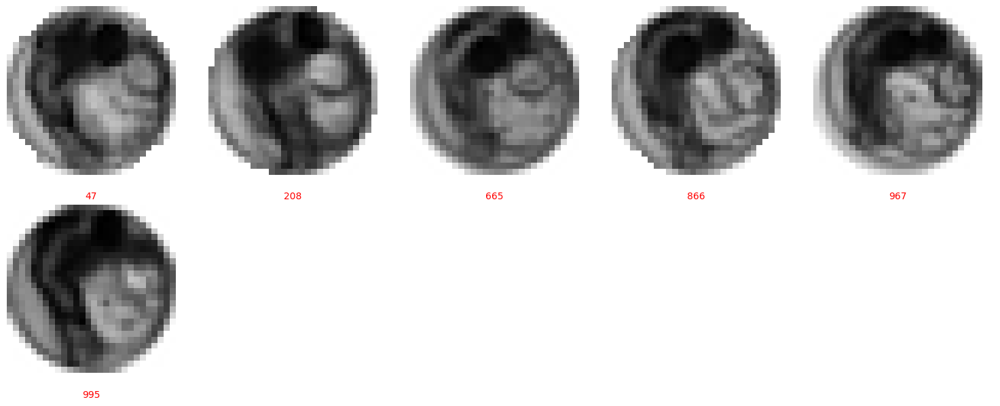

24


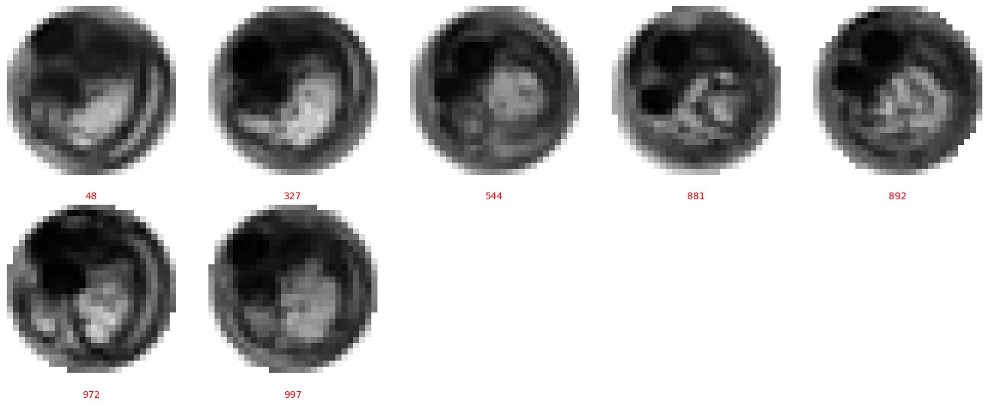

25


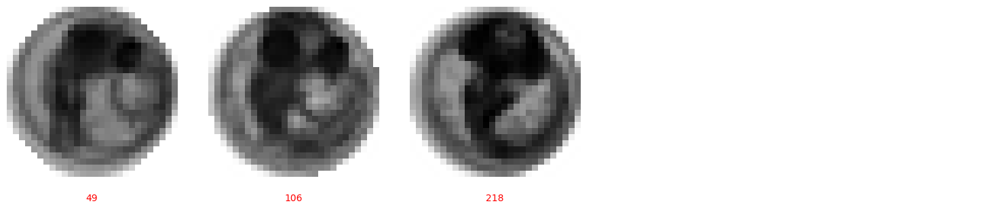

26


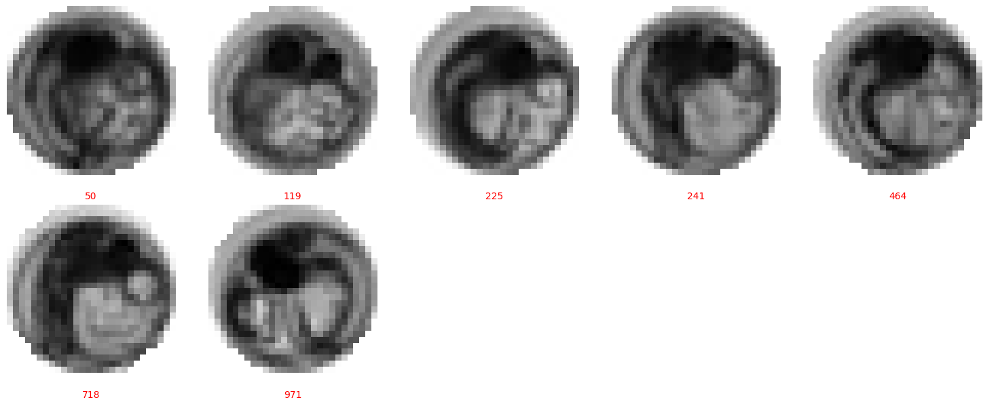

27


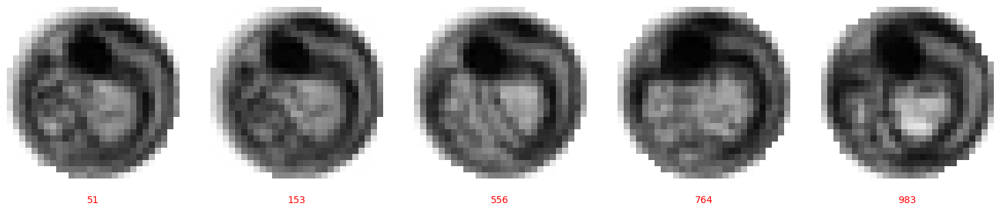

28


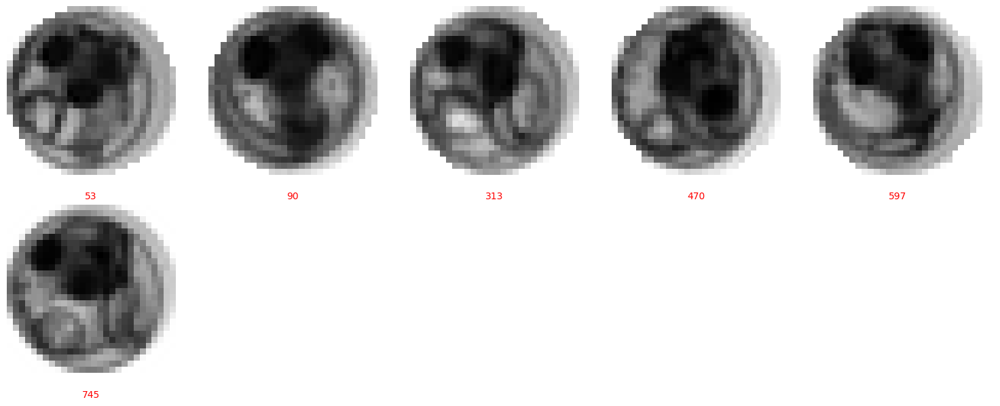

29


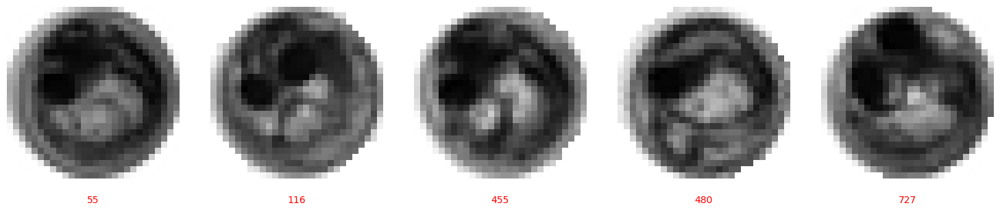

30


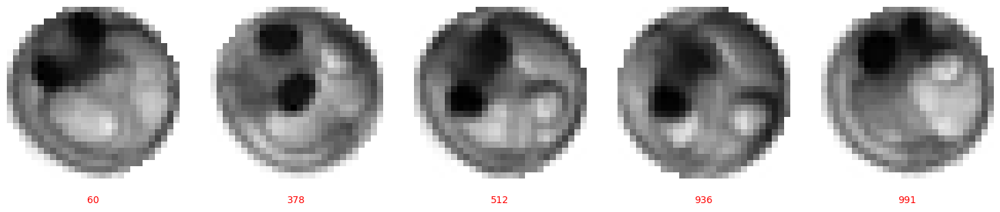

31


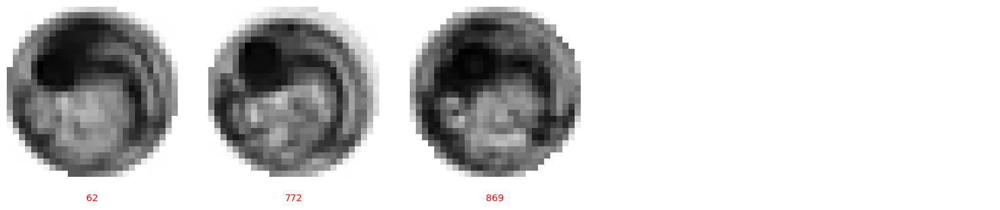

32


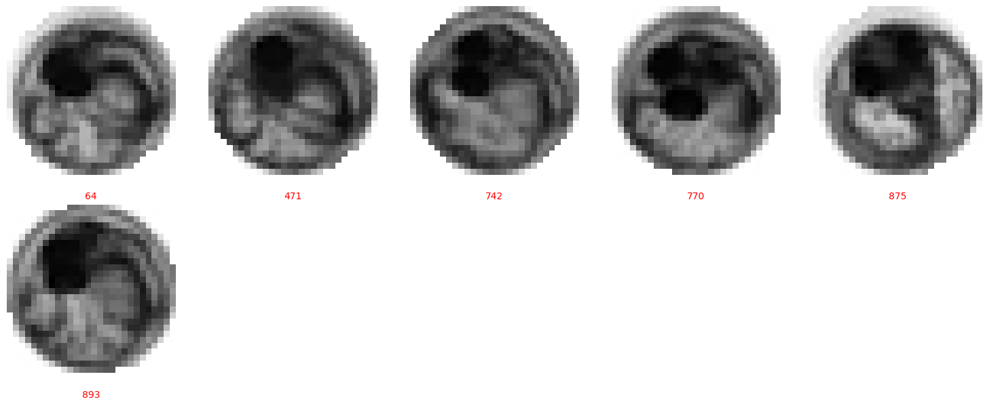

33


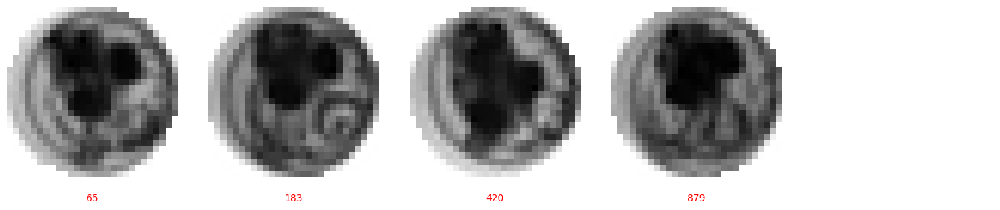

34


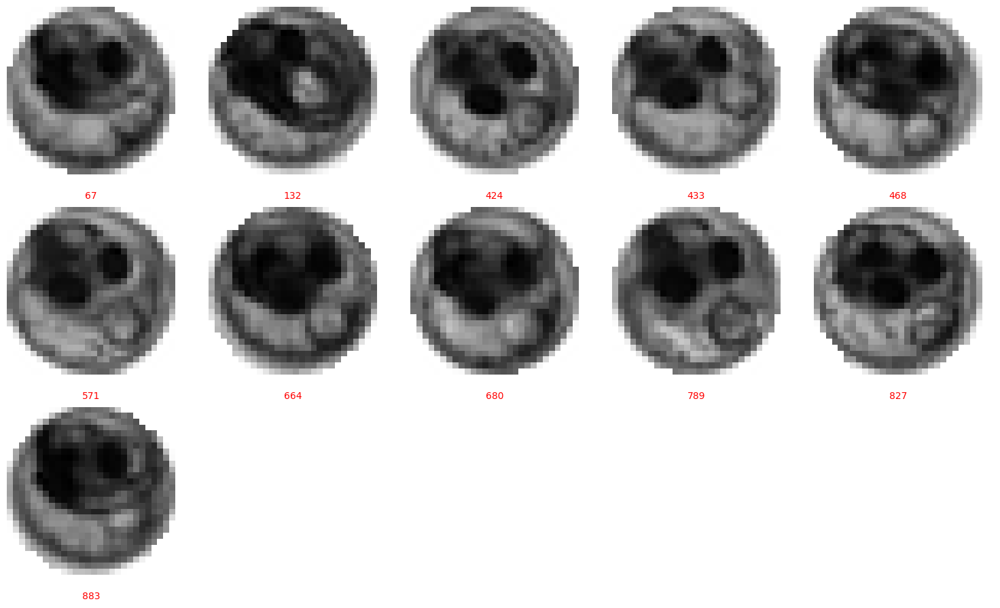

35


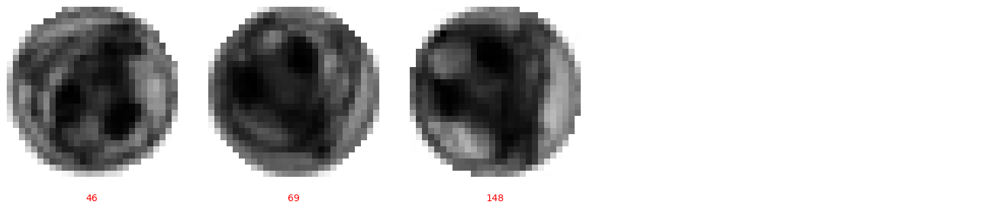

36


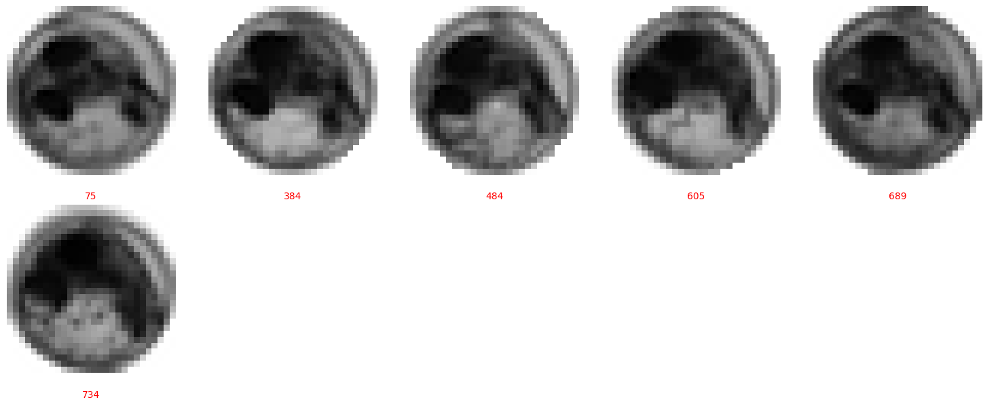

37


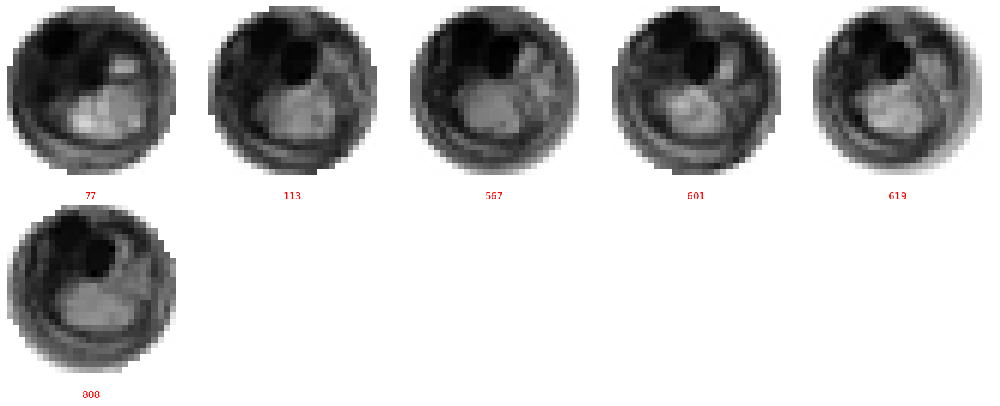

38


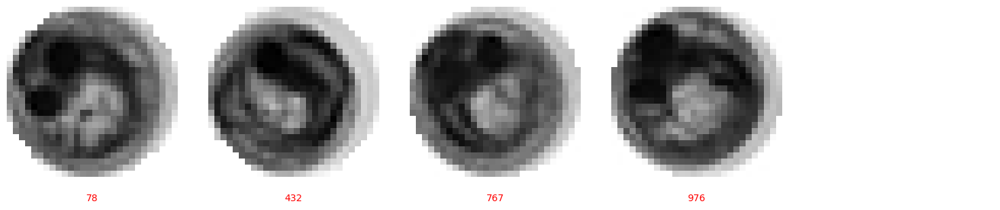

39


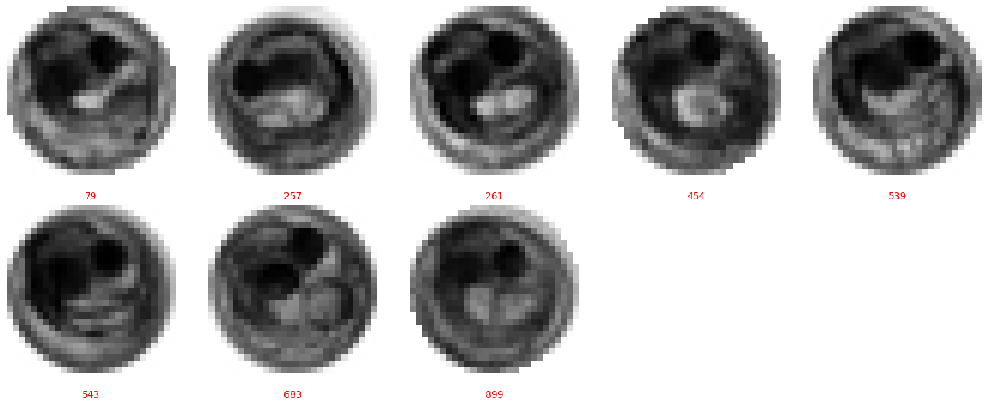

40


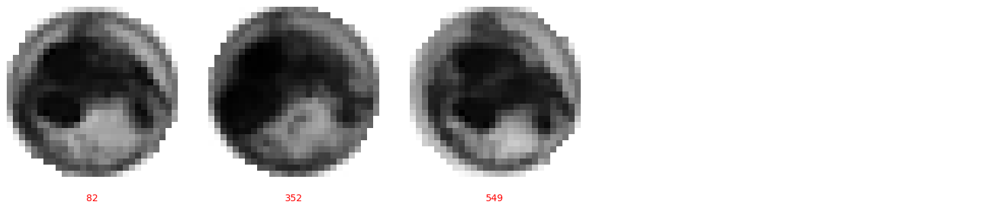

41


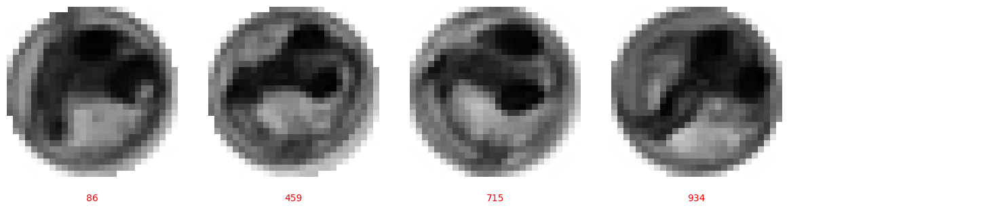

42


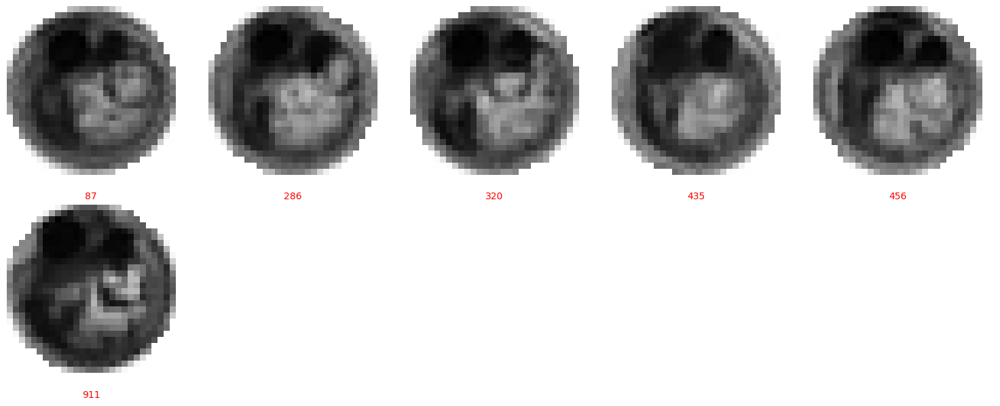

43


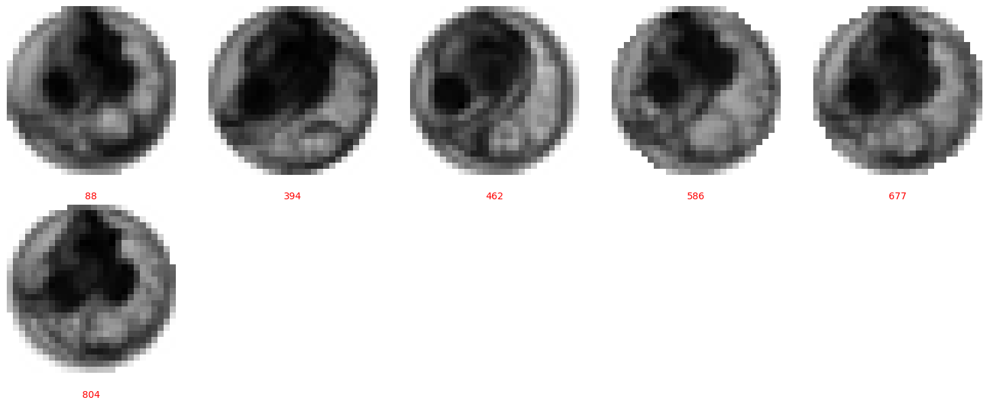

44


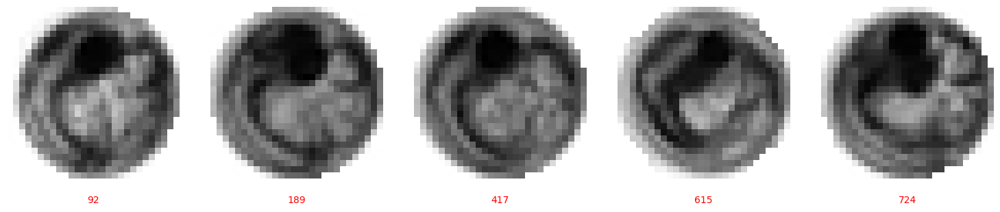

45


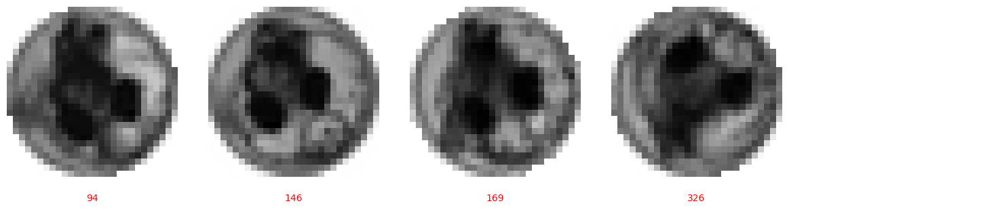

46


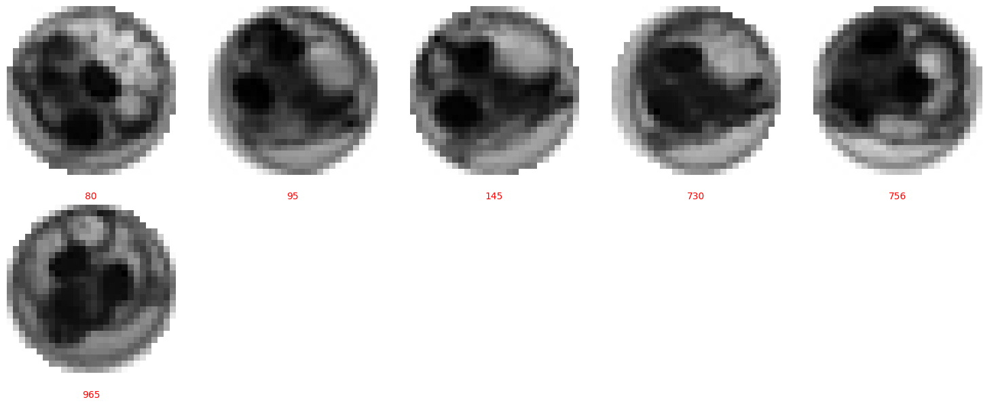

47


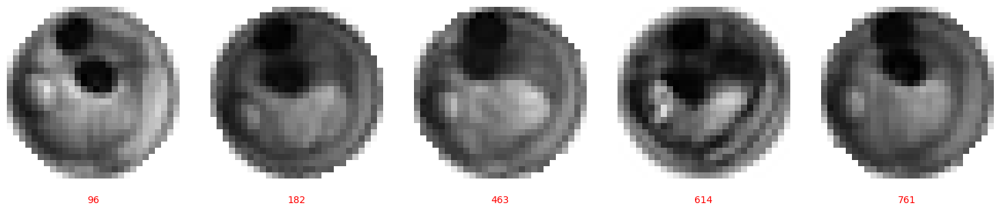

48


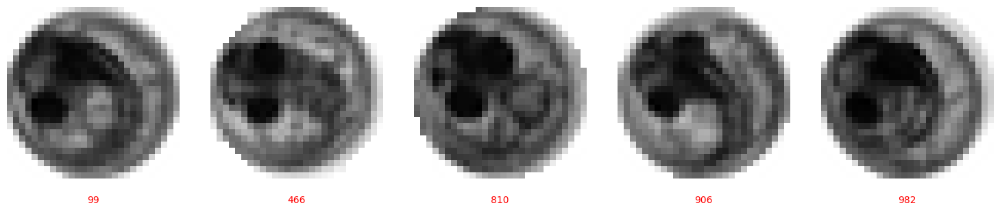

49


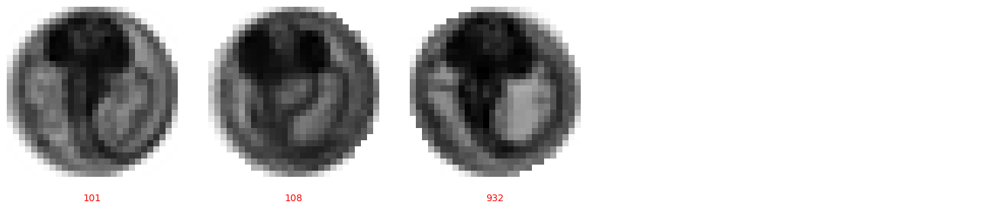

50


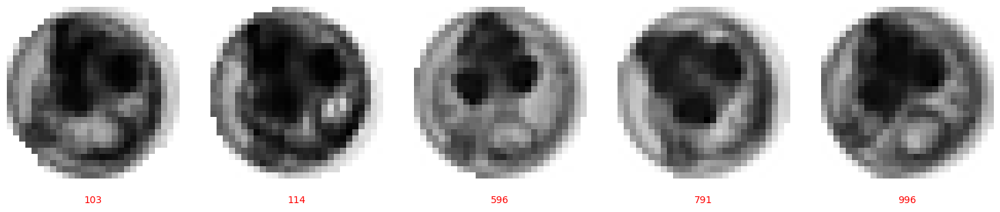

51


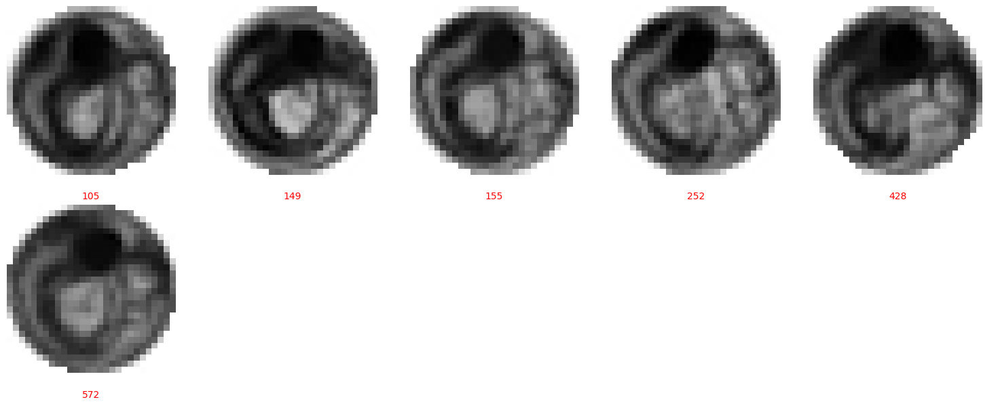

52


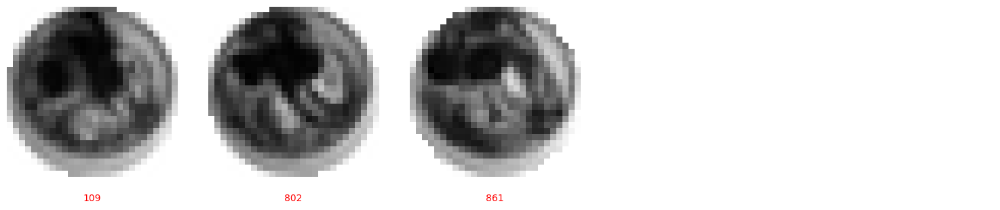

53


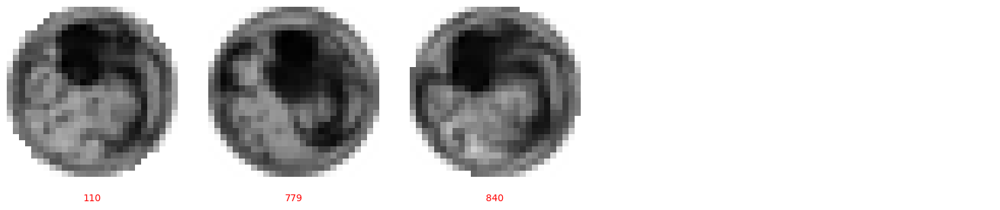

54


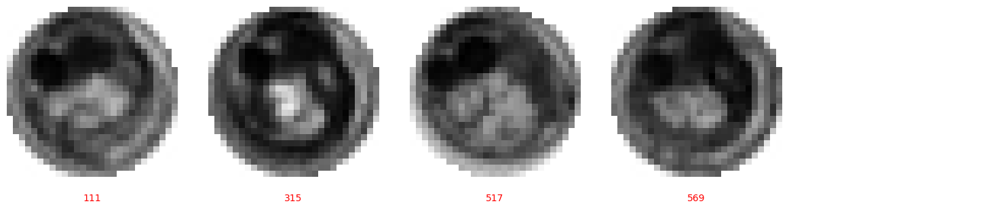

55


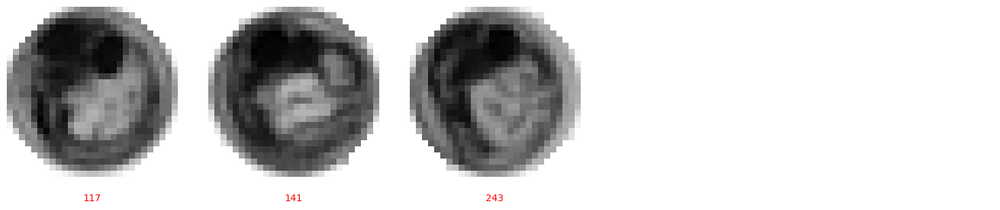

56


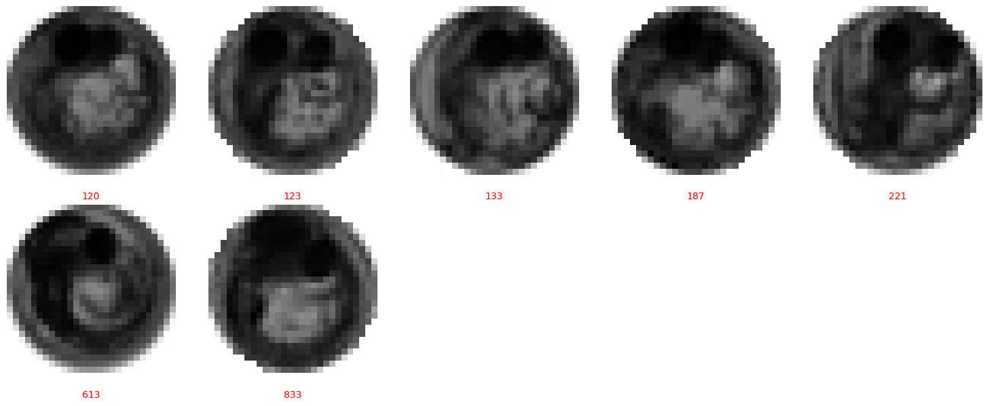

57


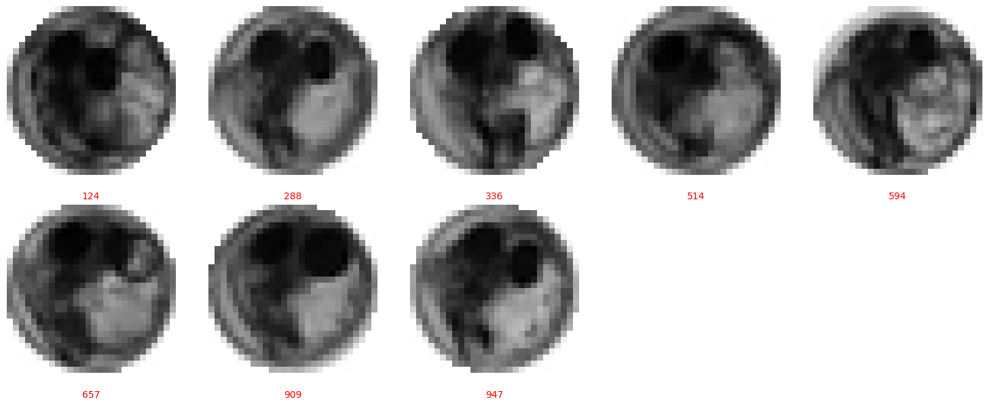

58


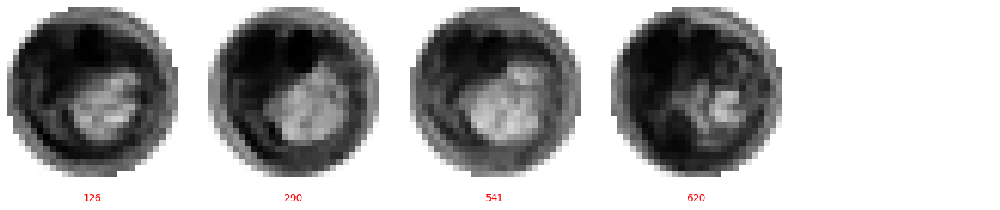

59


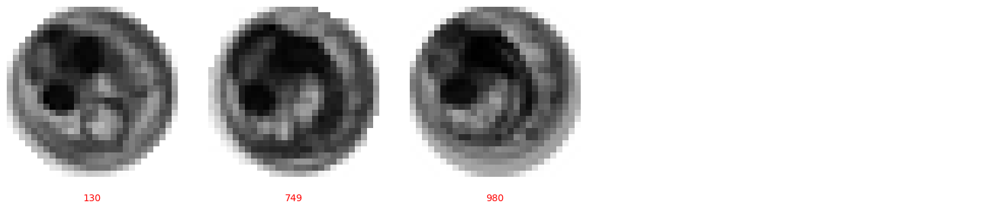

60


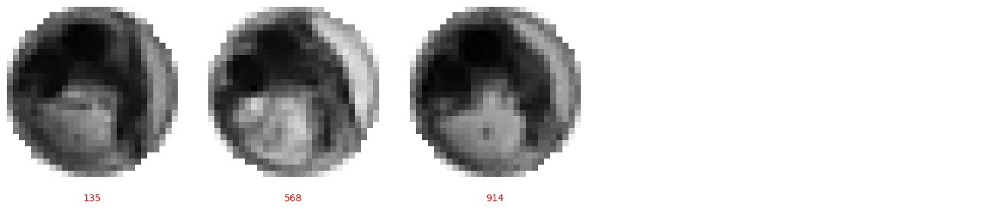

61


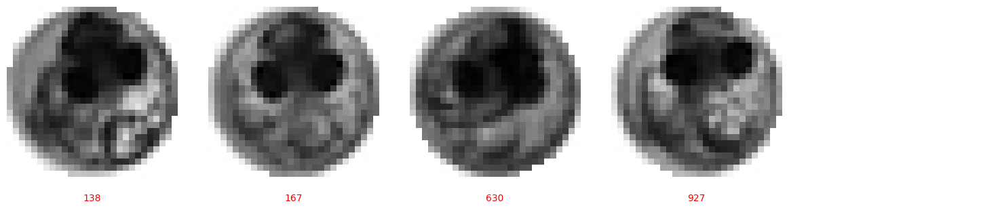

62


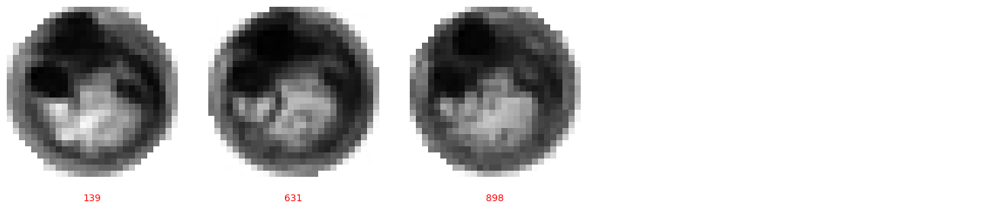

63


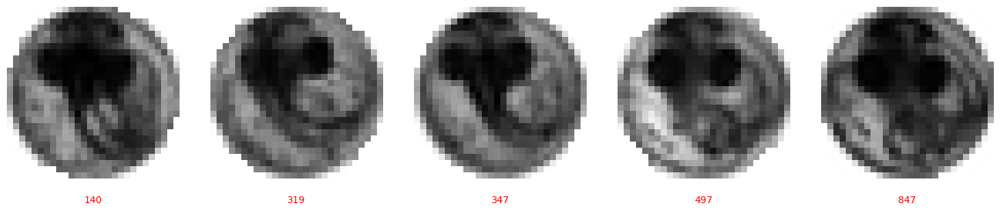

64


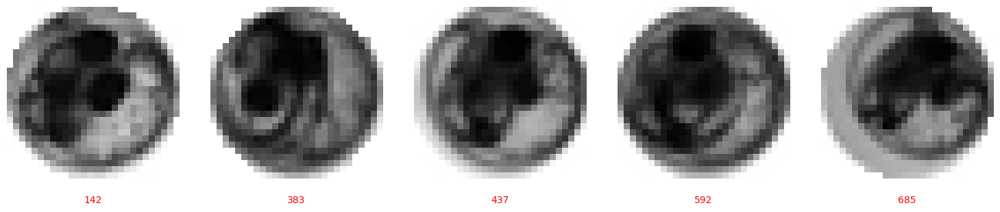

65


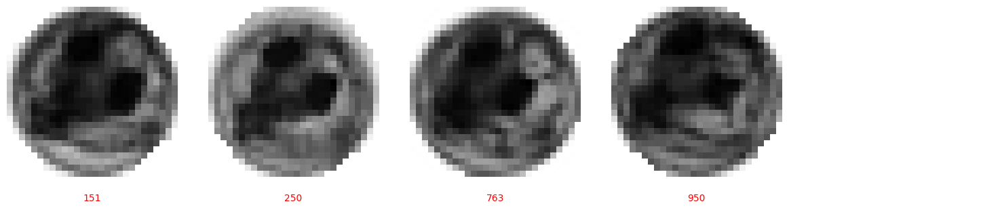

66


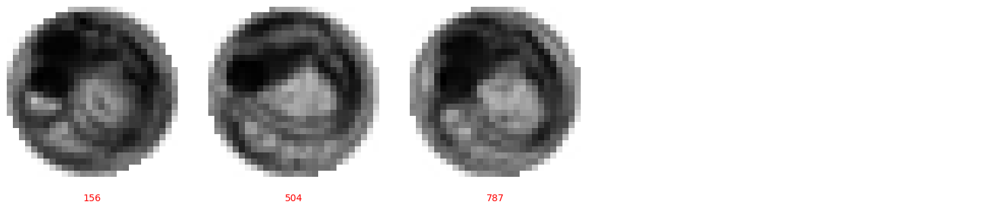

67


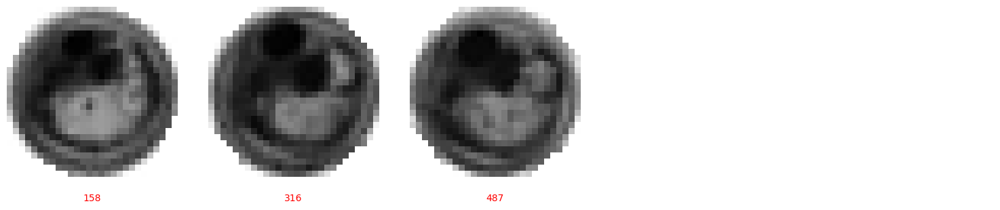

68


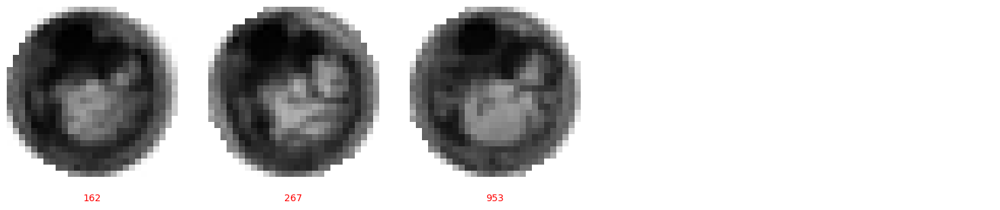

69


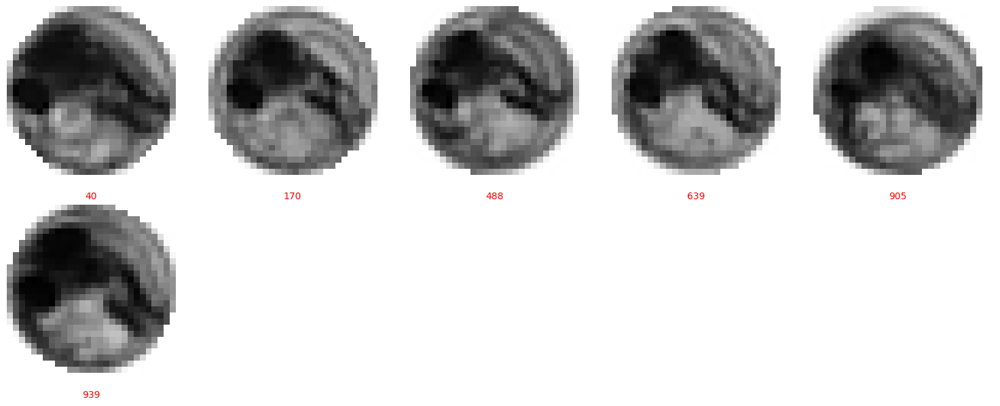

70


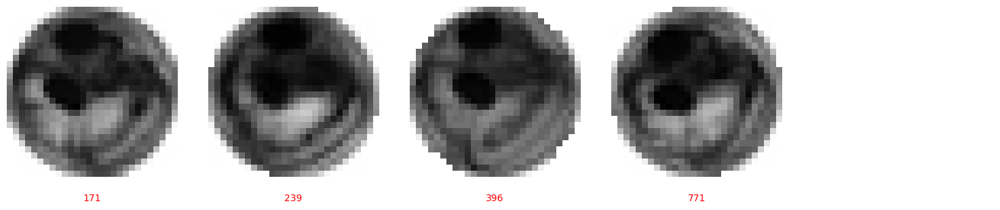

71


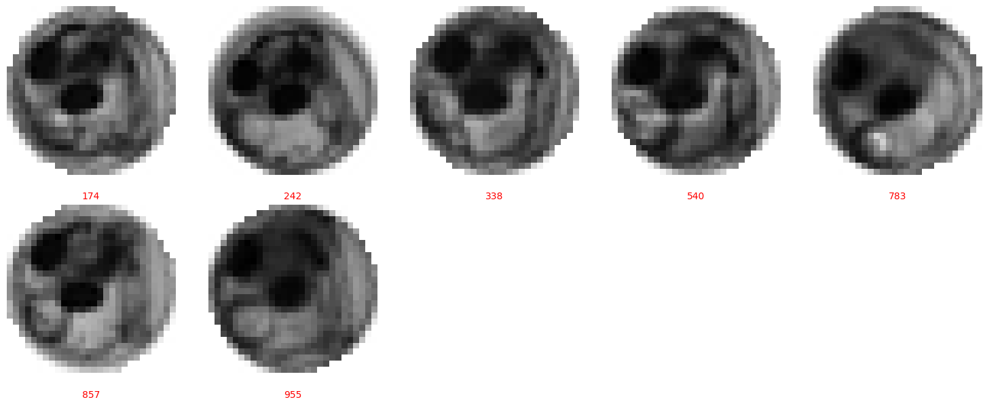

72


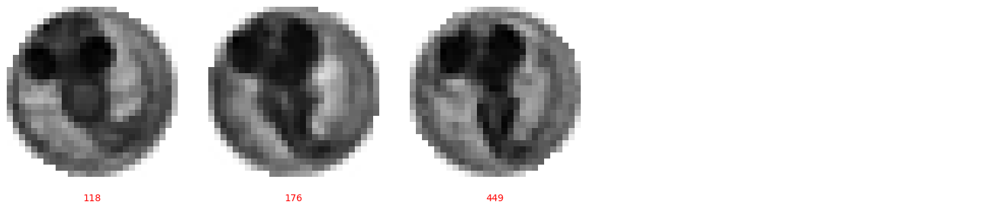

73


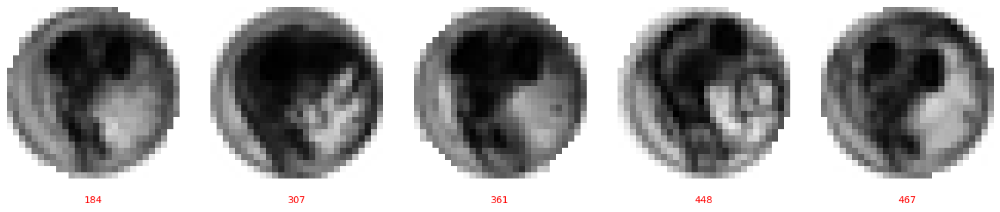

74


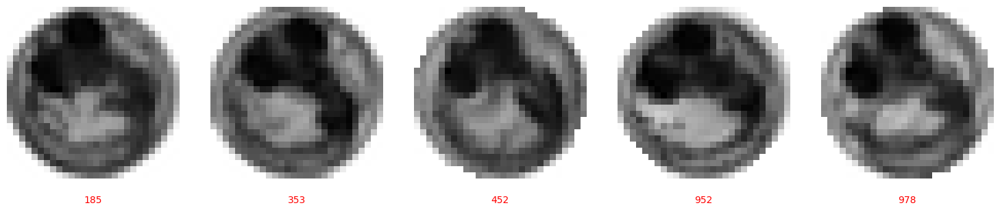

75


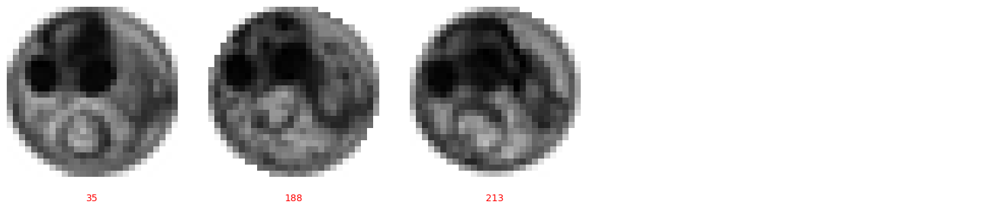

76


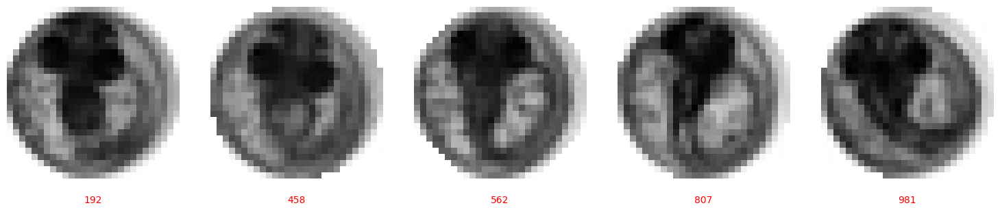

77


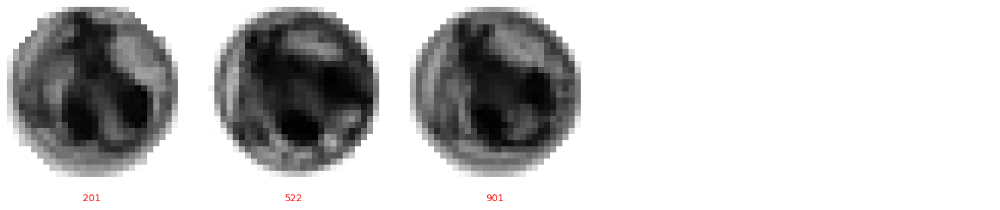

78


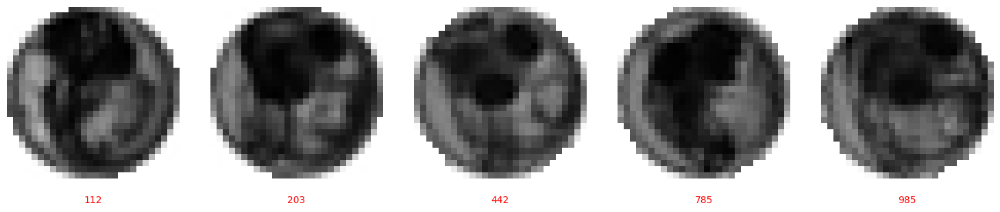

79


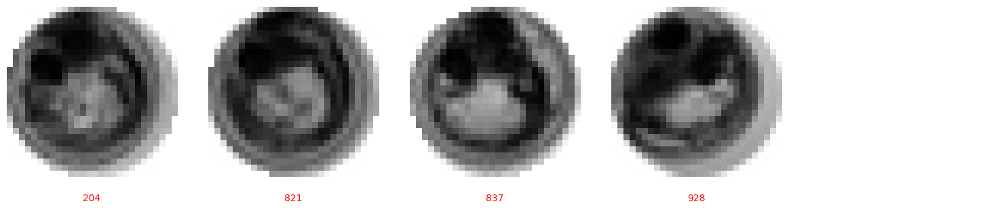

80


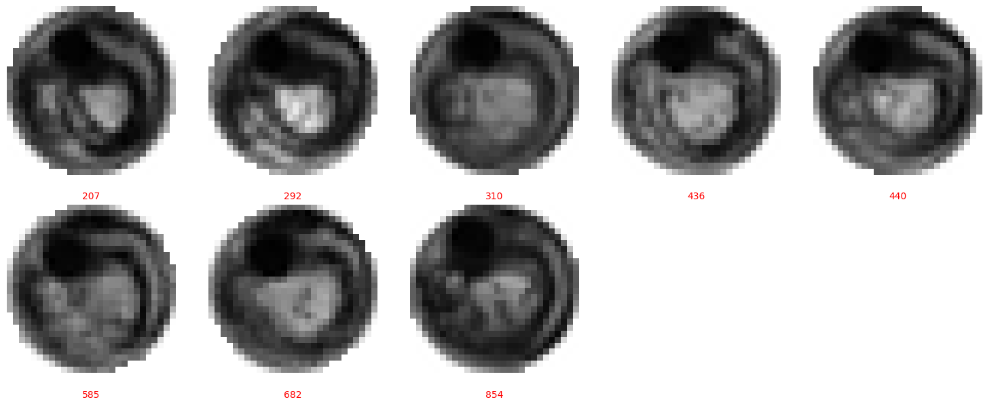

81


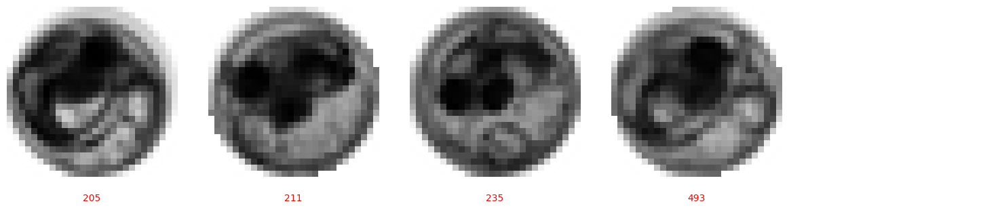

82


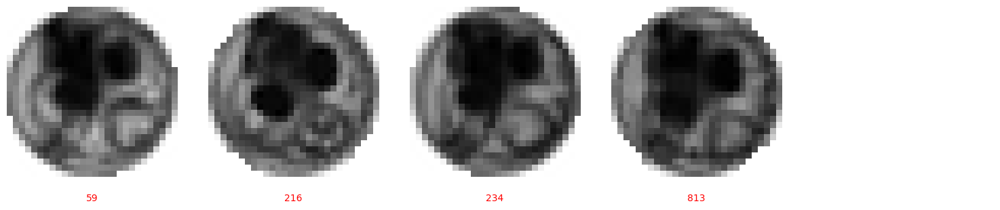

83


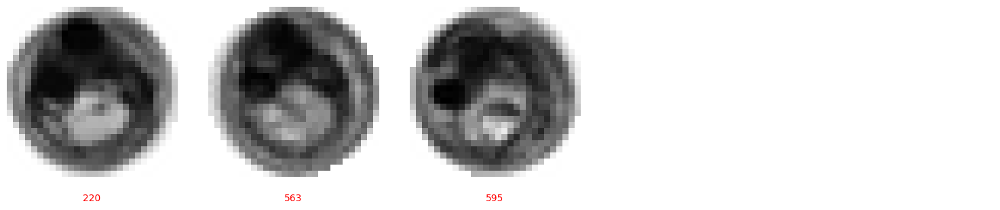

84


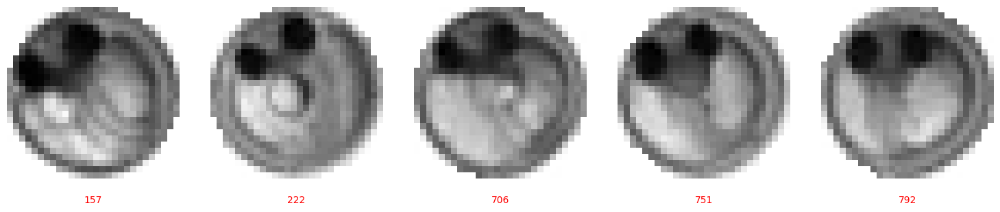

85


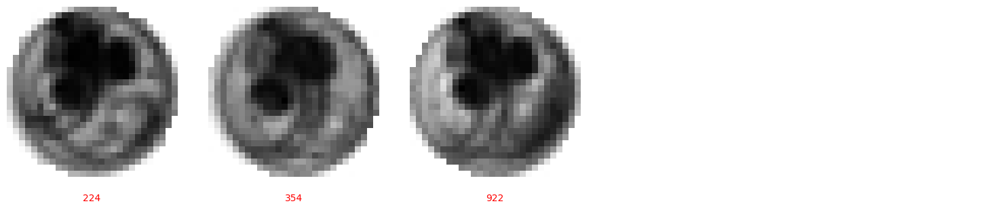

86


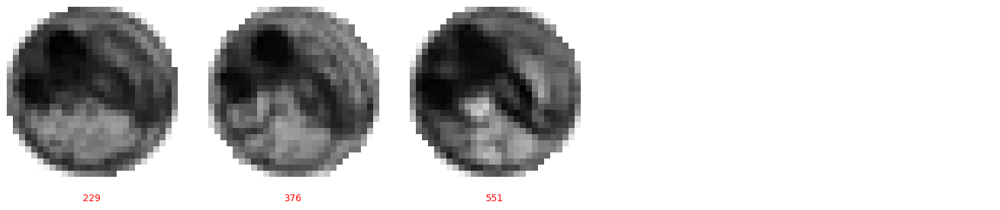

87


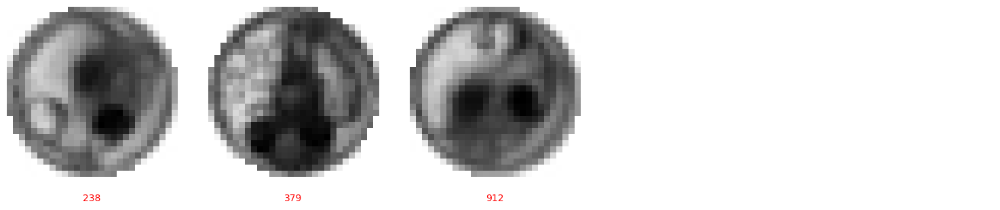

88


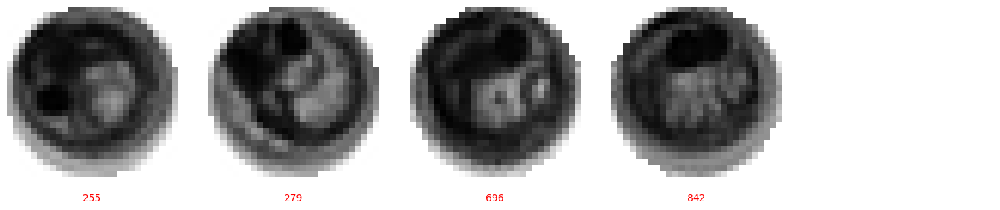

89


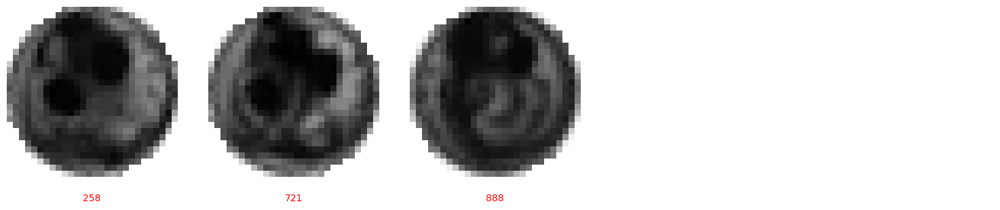

90


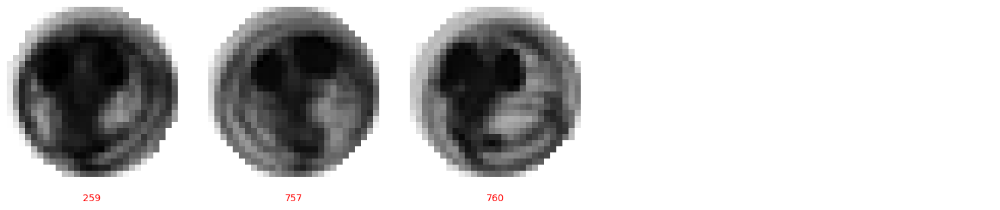

91


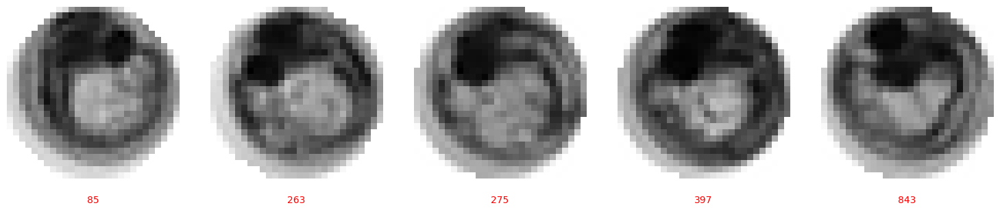

92


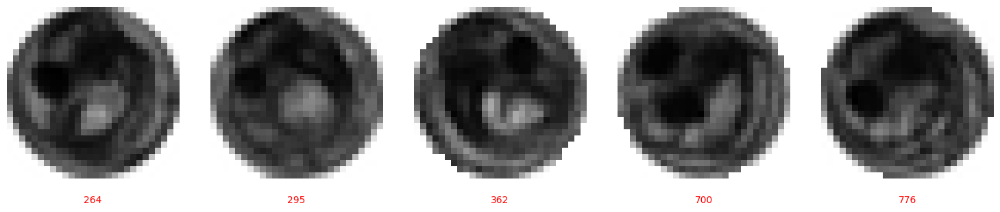

93


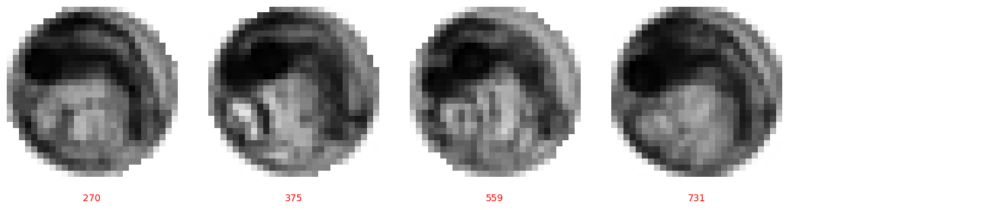

94


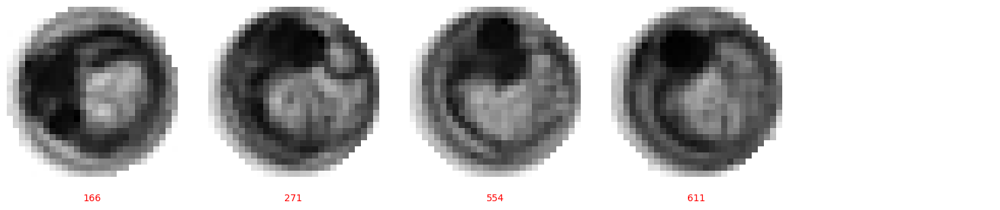

95


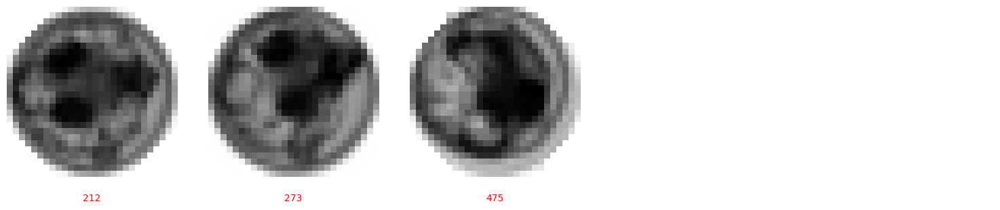

96


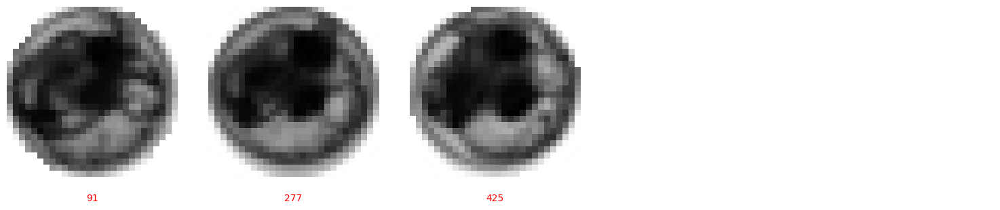

97


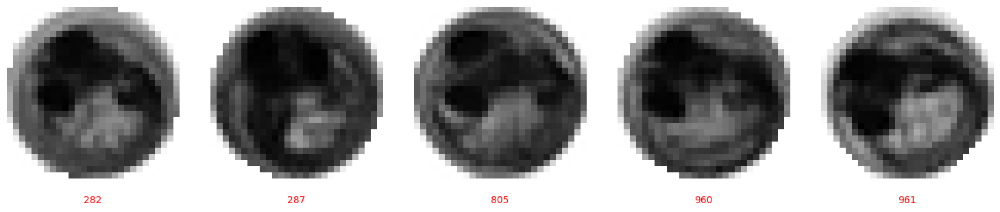

98


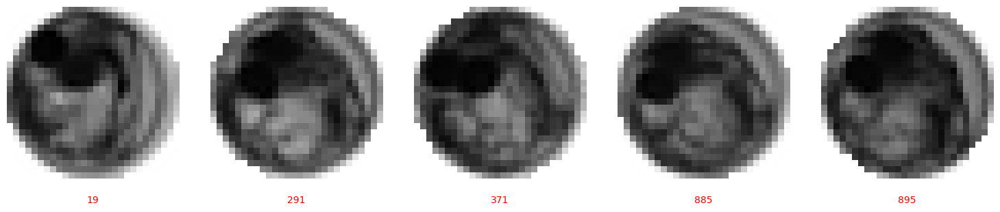

99


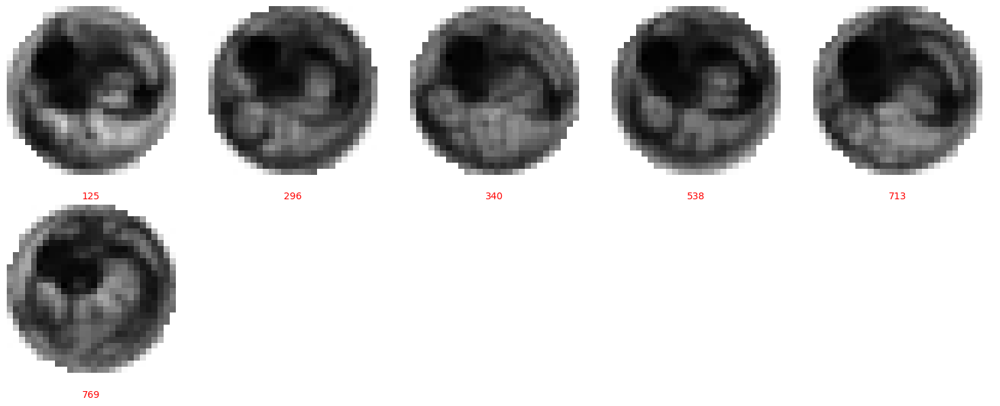

100


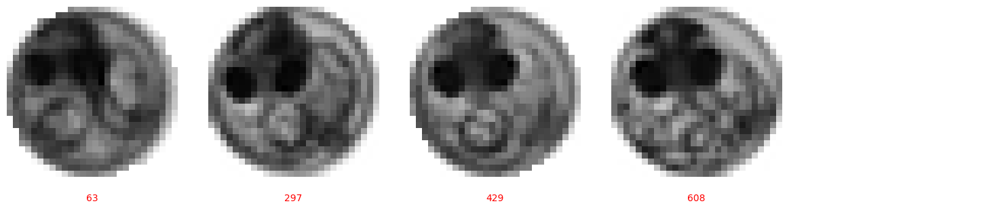

101


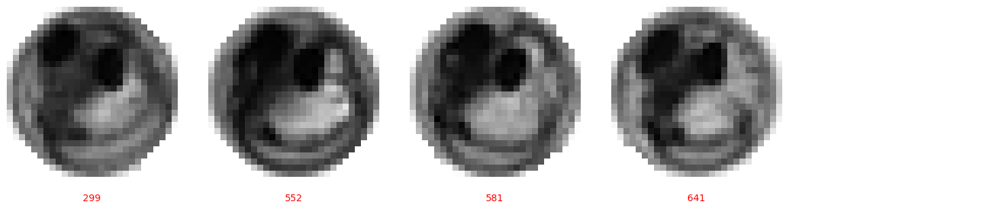

102


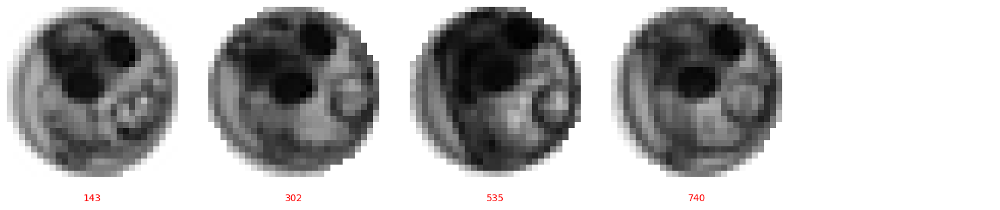

103


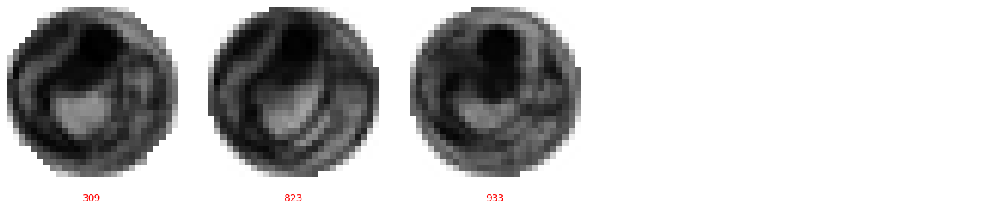

104


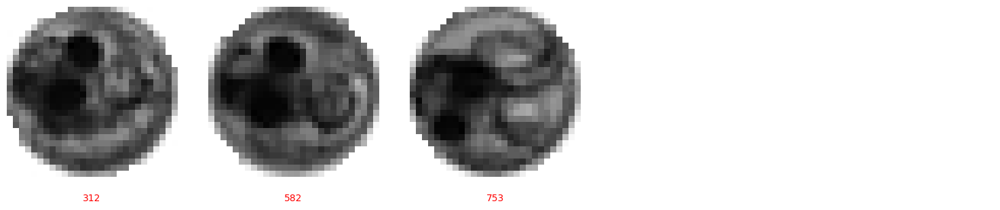

105


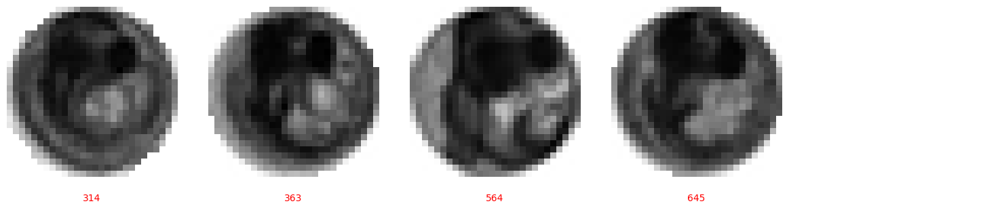

106


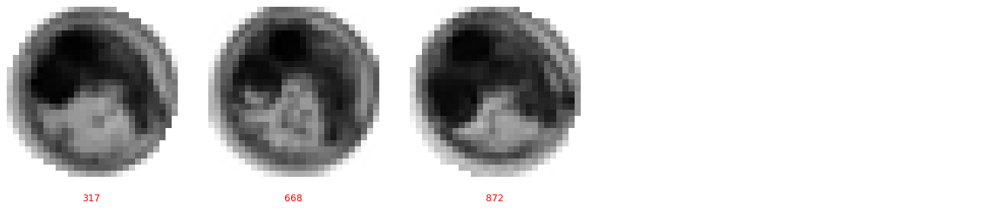

107


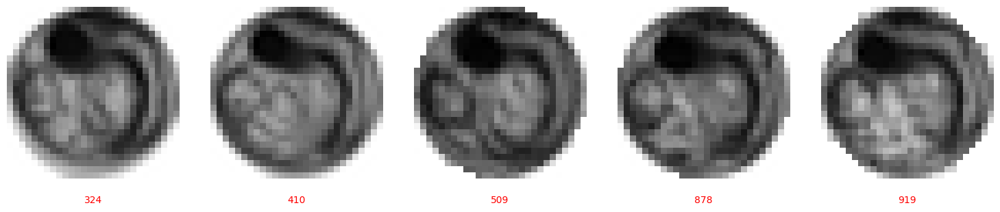

108


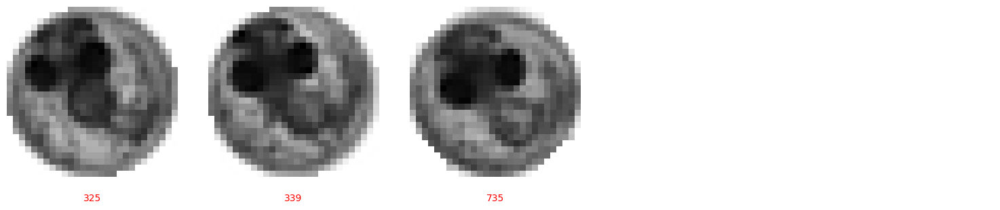

109


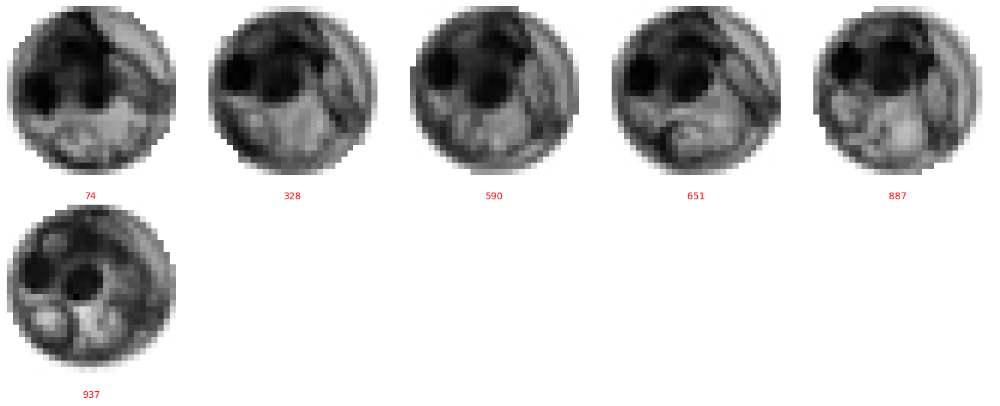

110


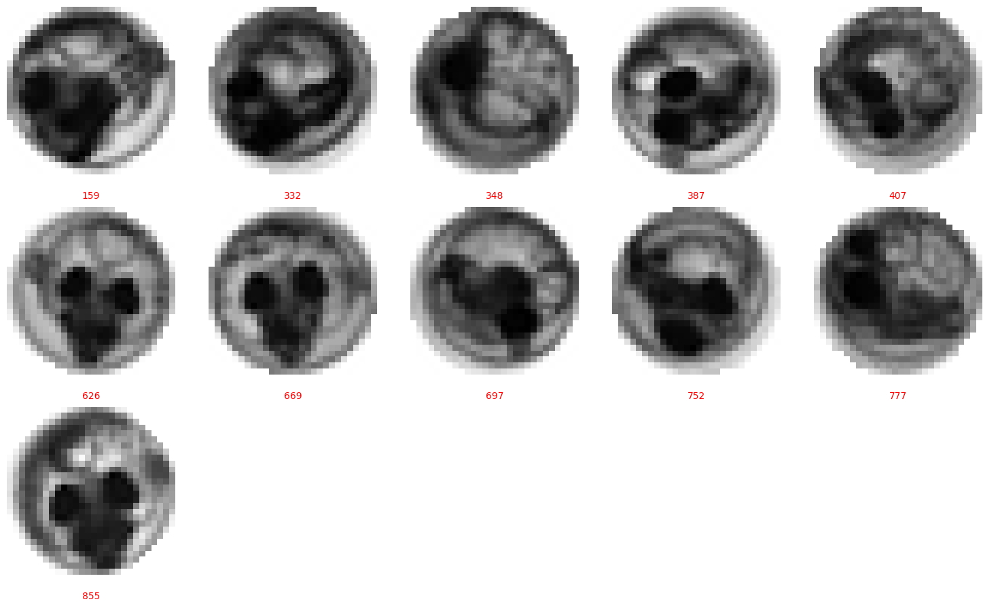

111


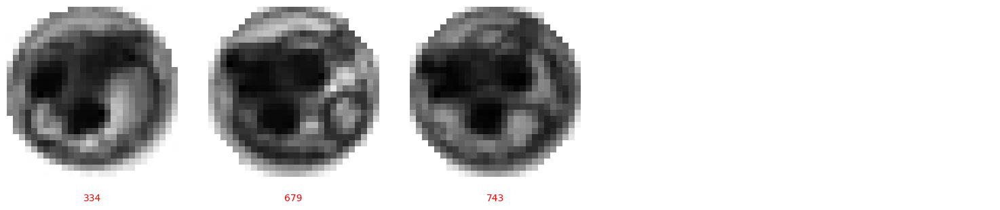

112


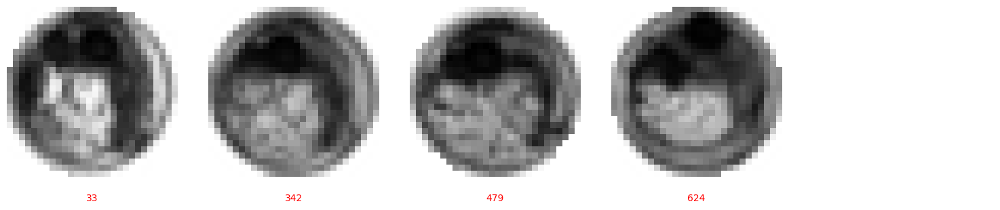

113


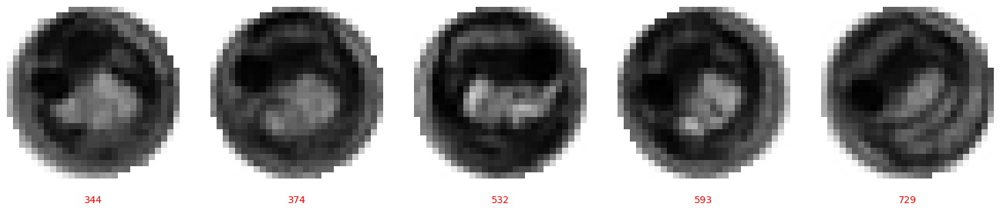

114


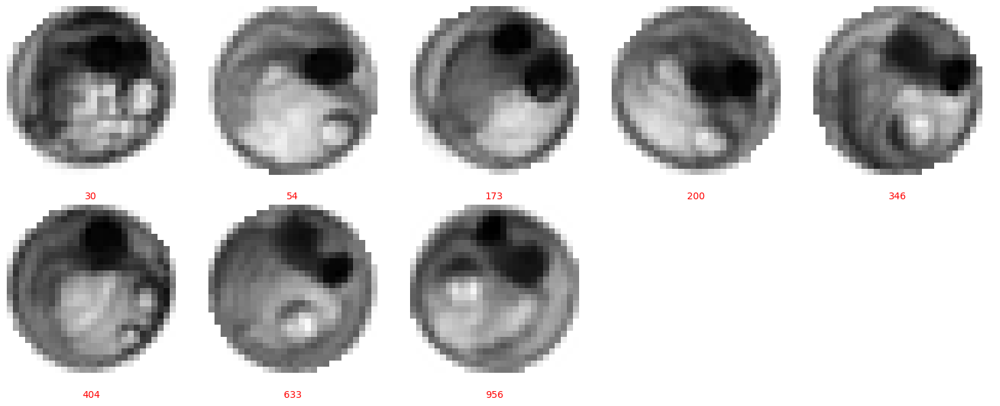

115


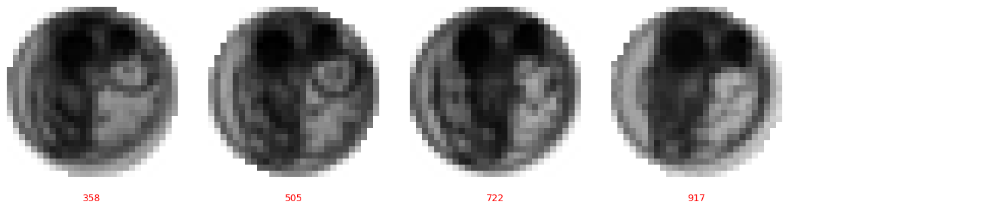

116


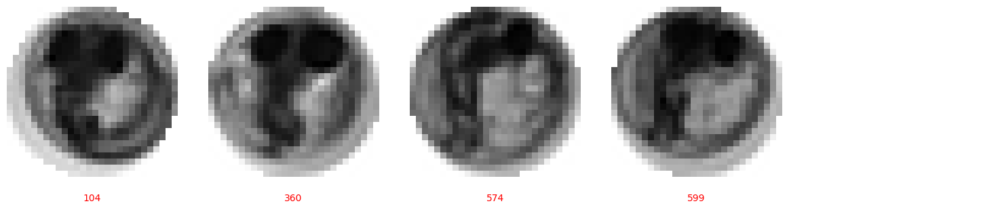

117


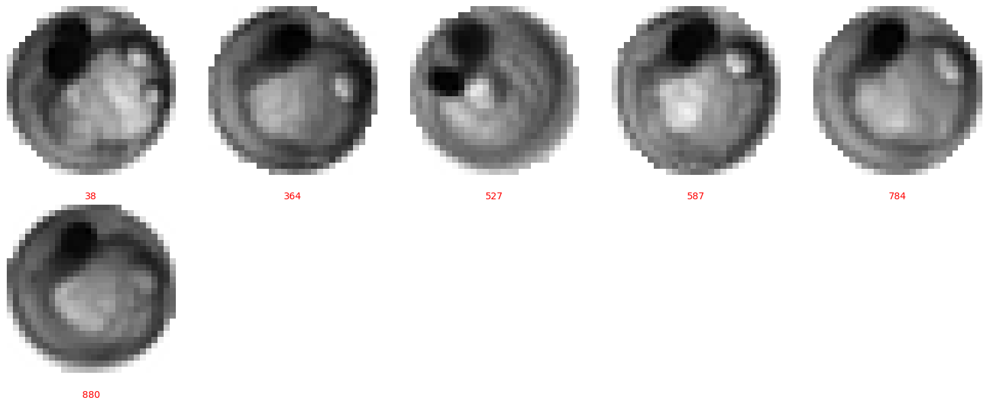

118


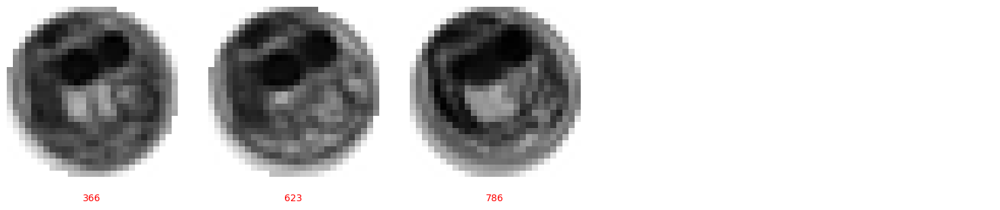

119


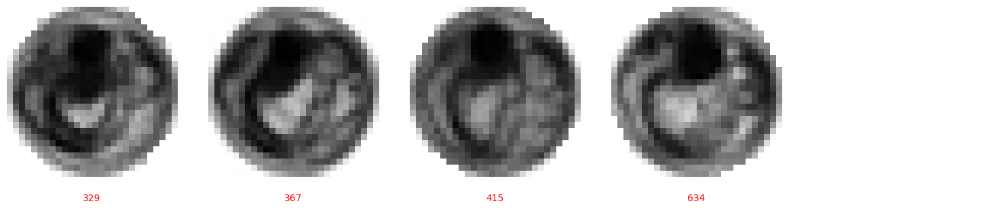

120


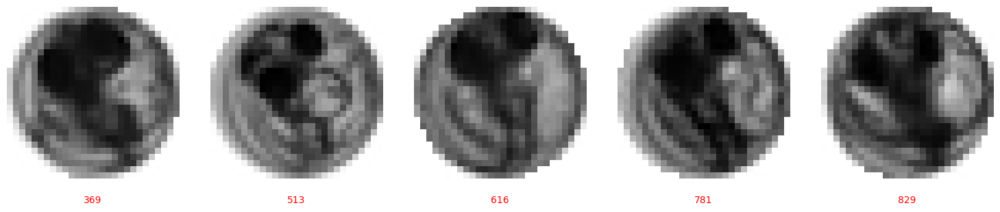

121


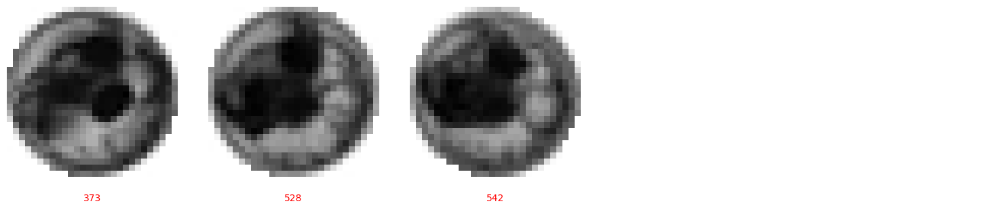

122


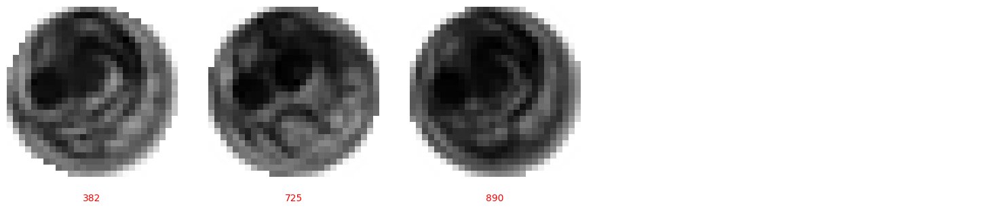

123


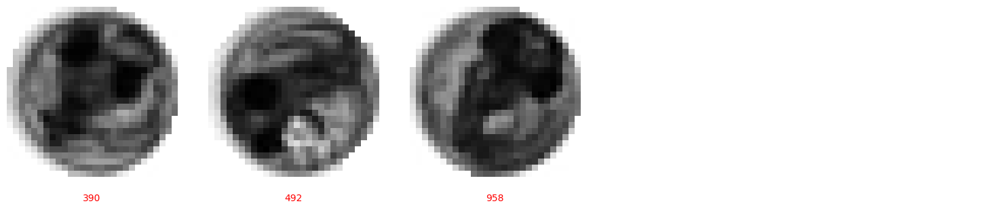

124


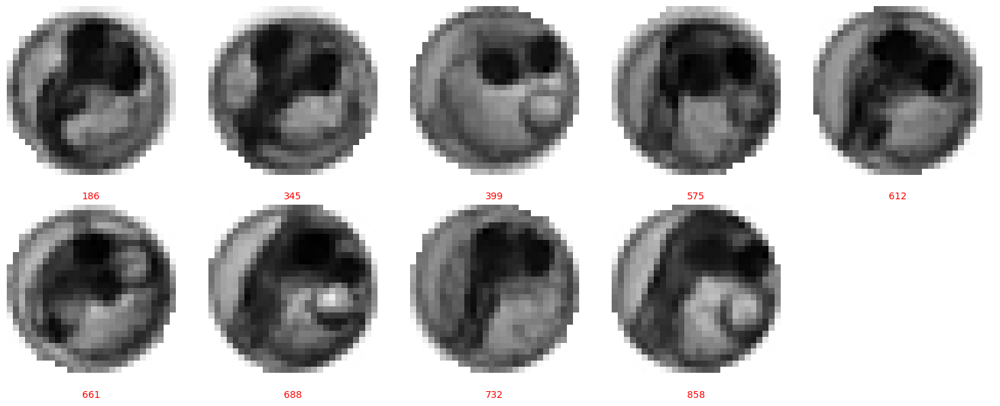

125


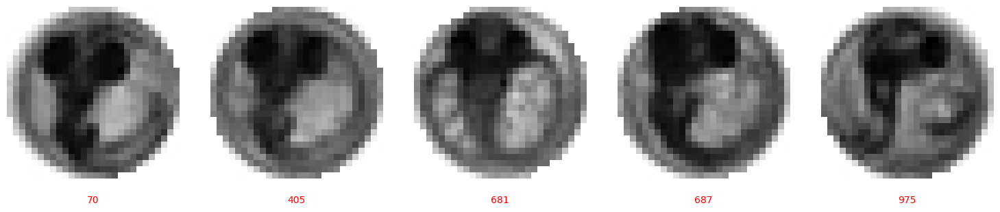

126


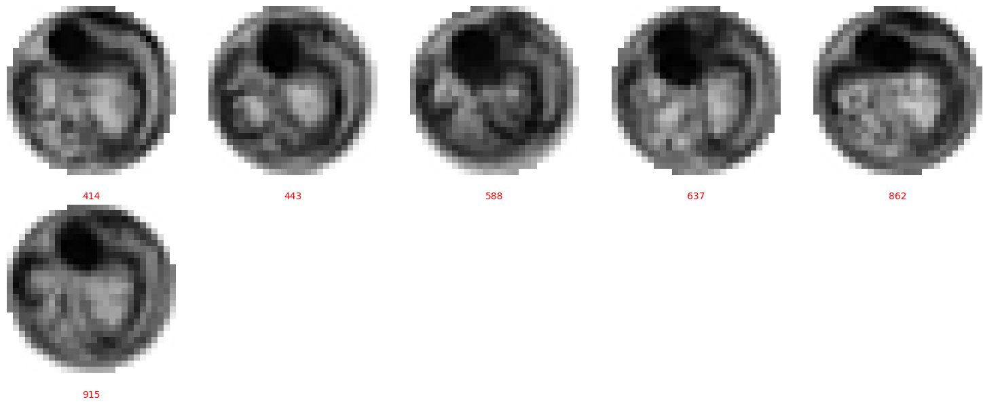

127


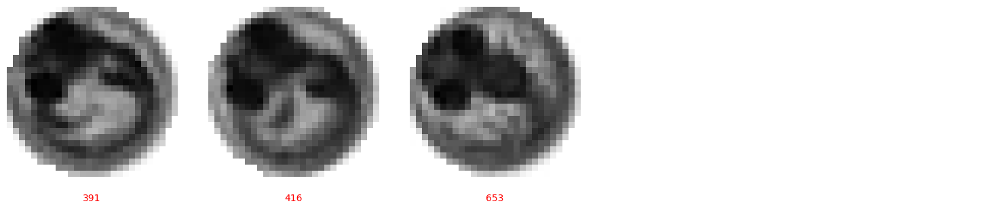

128


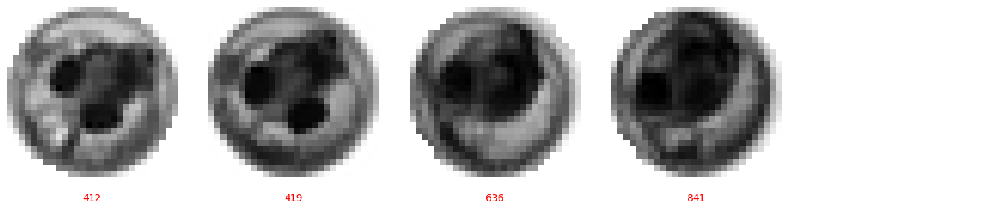

129


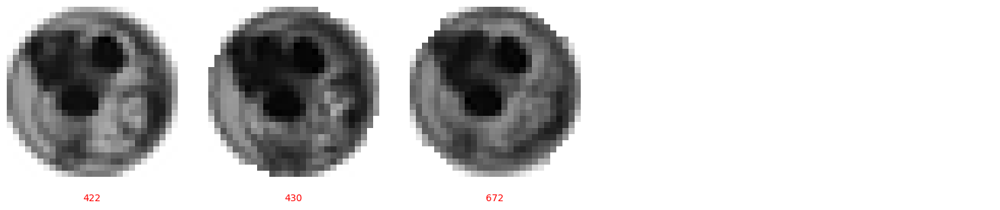

130


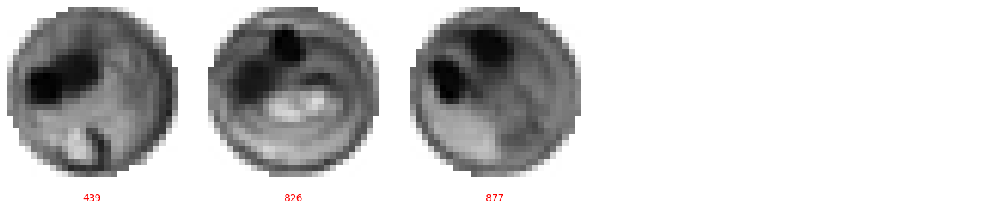

131


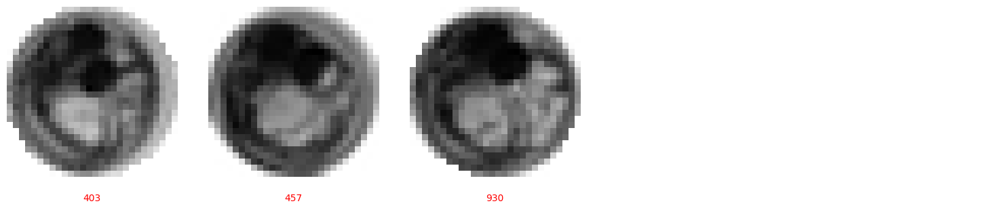

132


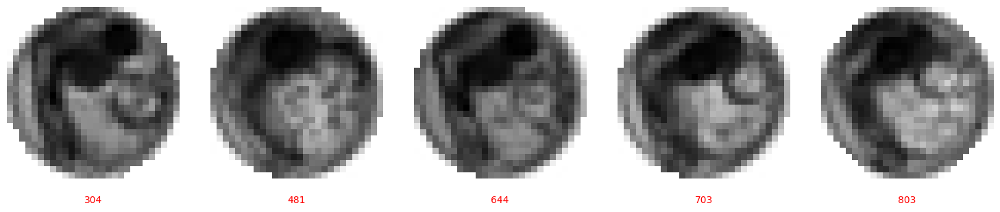

133


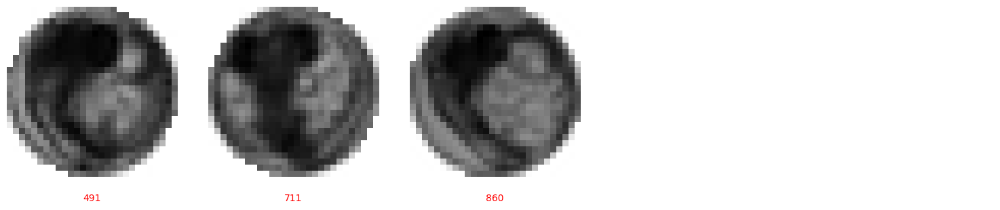

134


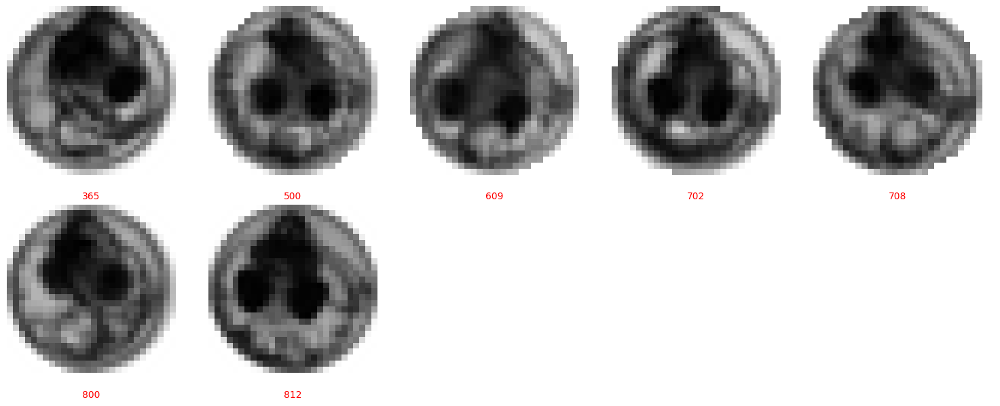

135


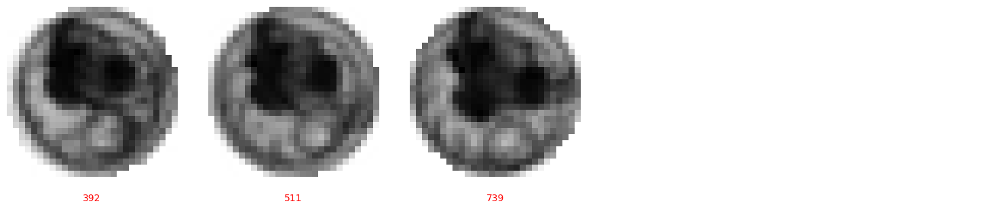

136


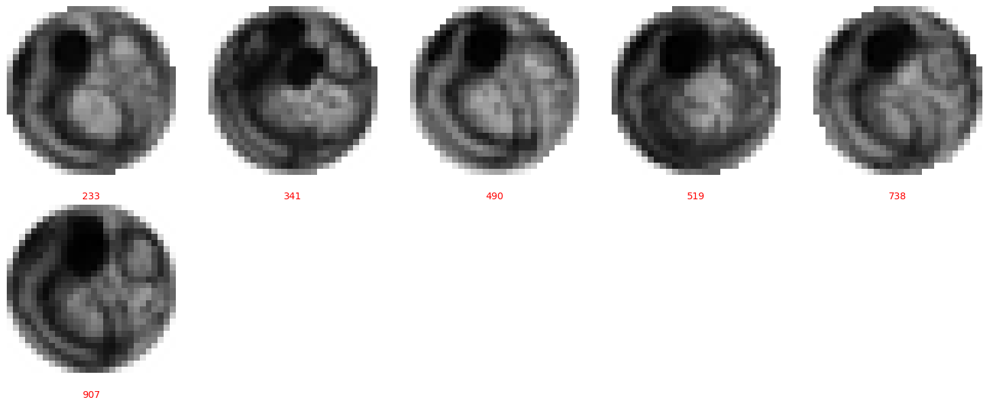

137


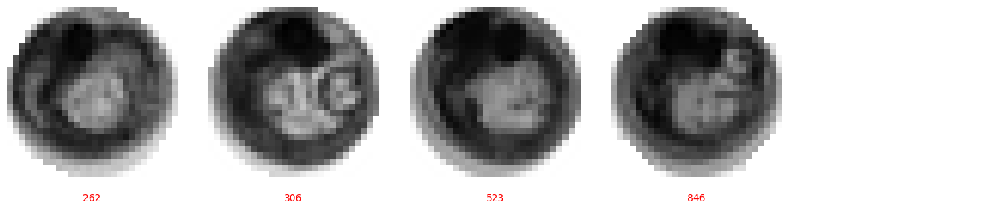

138


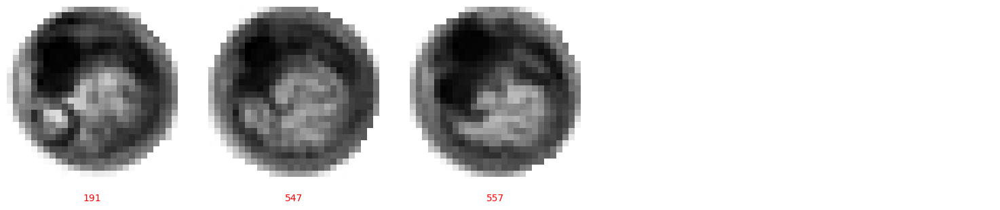

139


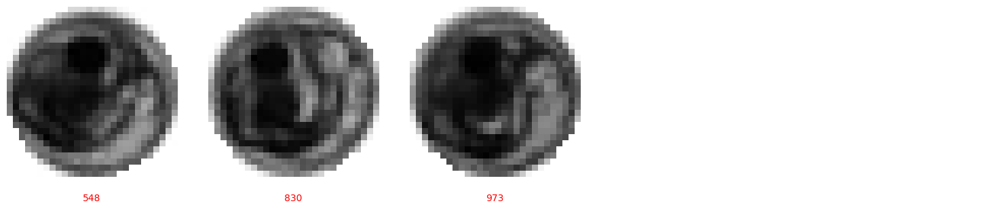

140


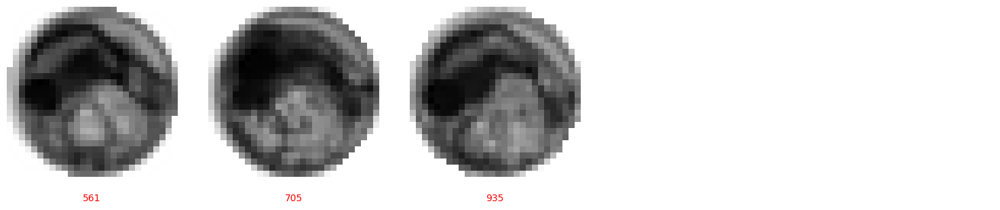

141


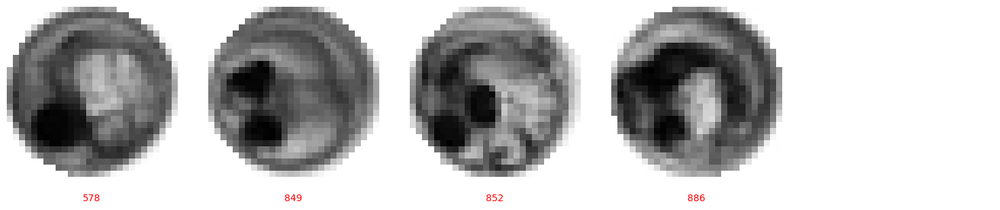

142


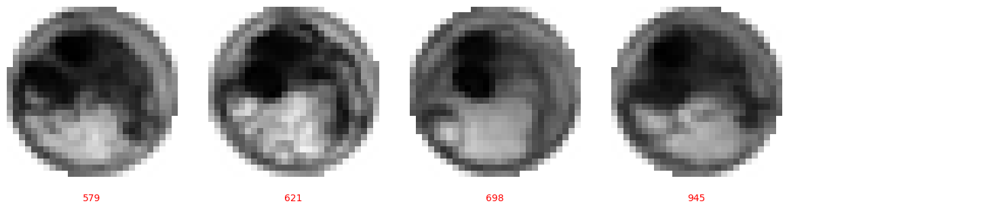

143


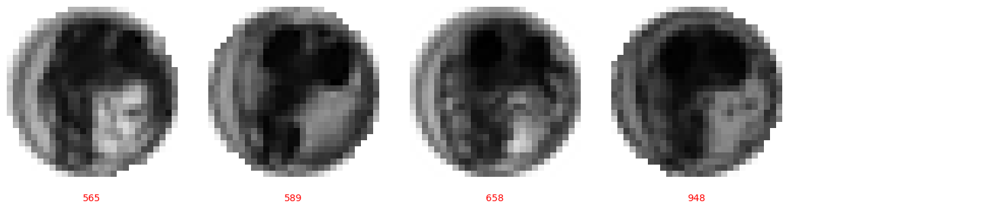

144


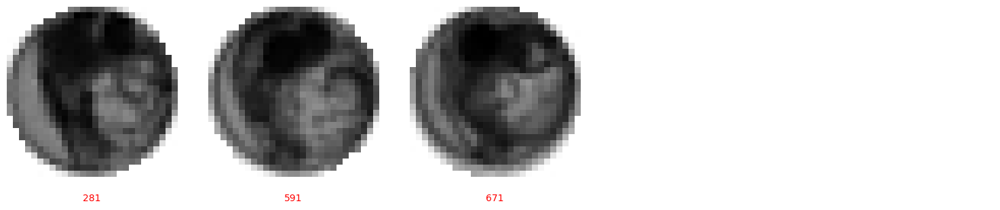

145


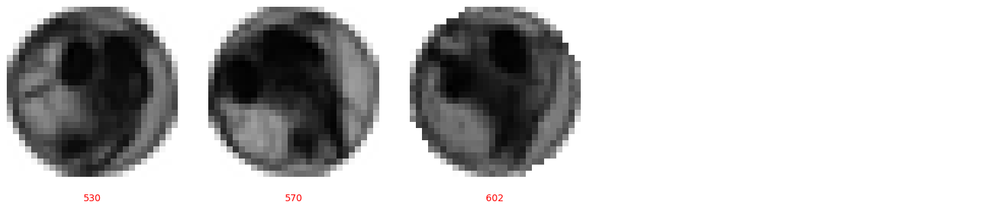

146


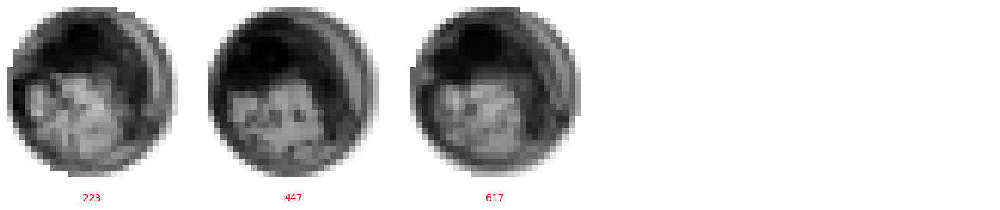

147


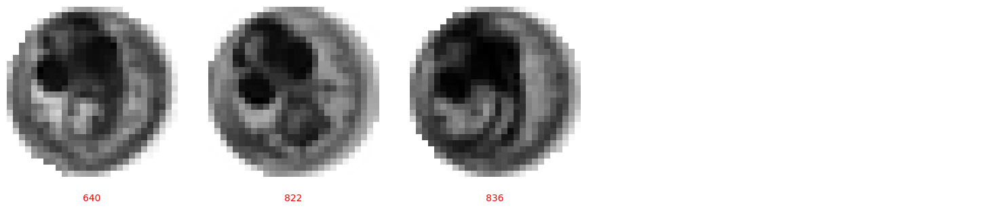

148


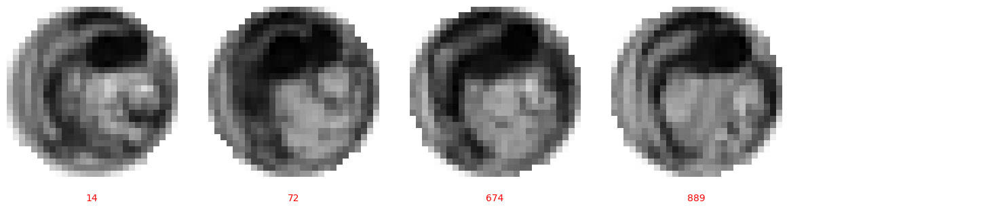

149


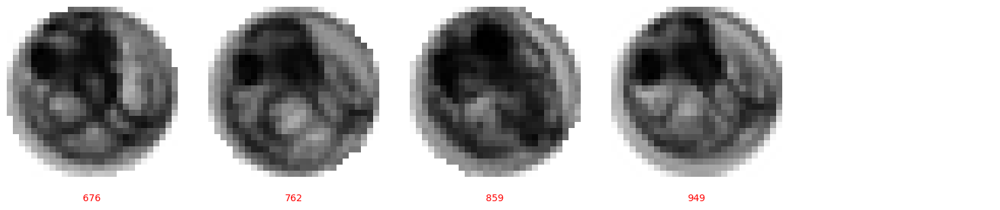

150


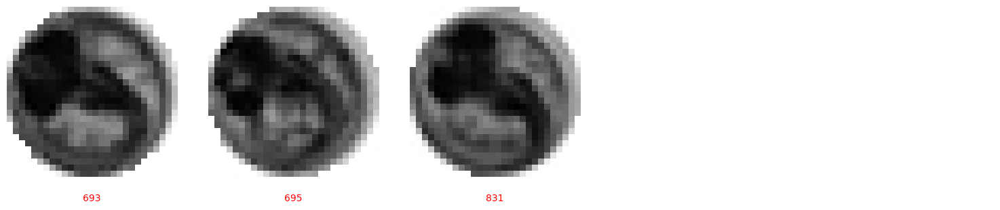

151


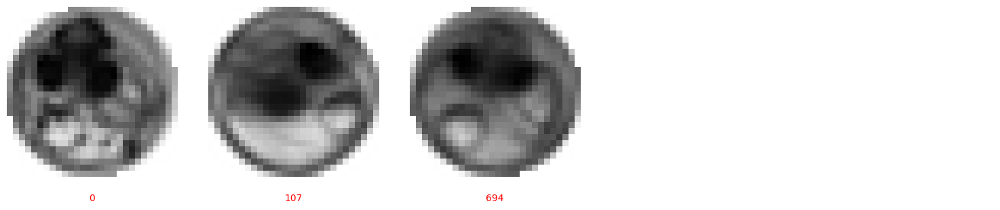

152


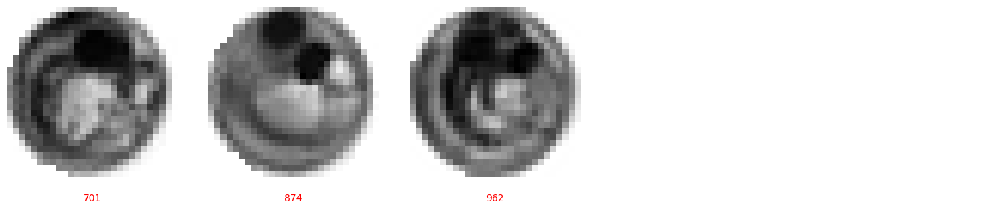

153


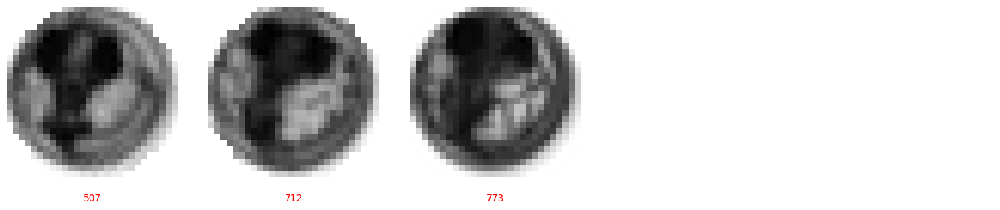

154


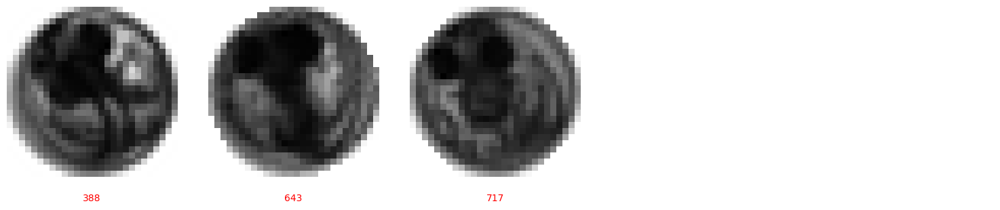

155


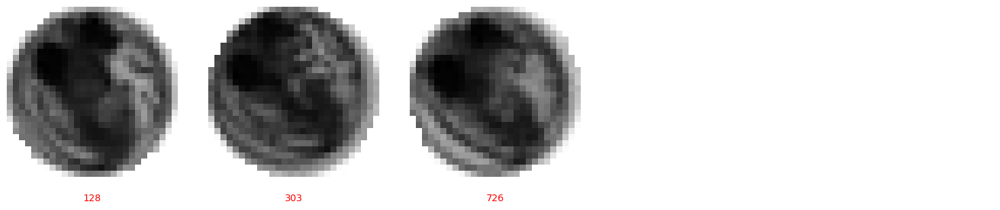

156


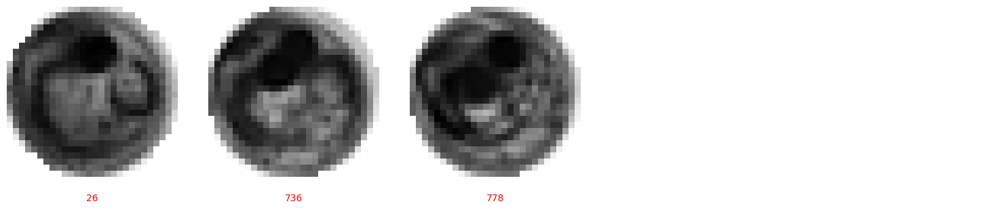

157


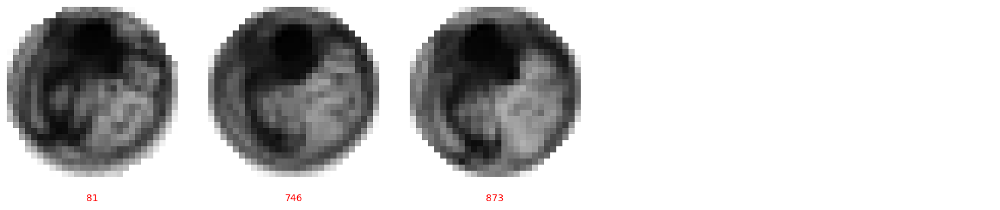

158


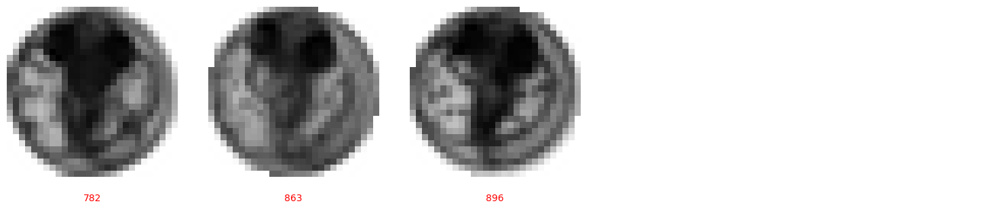

159


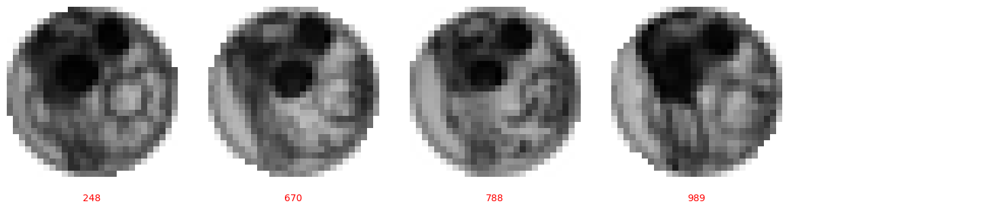

160


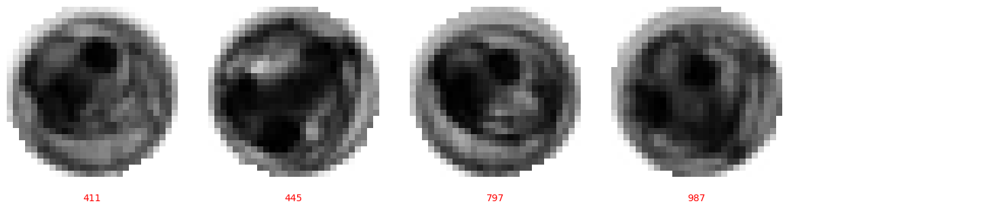

161


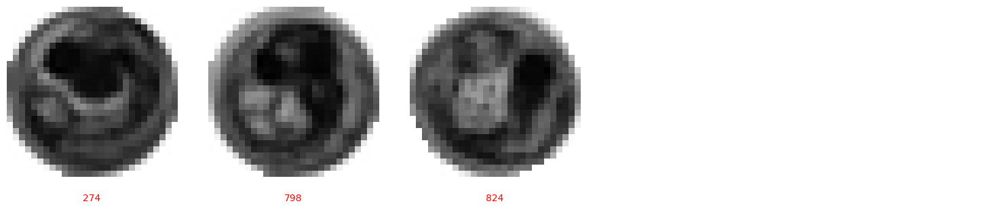

162


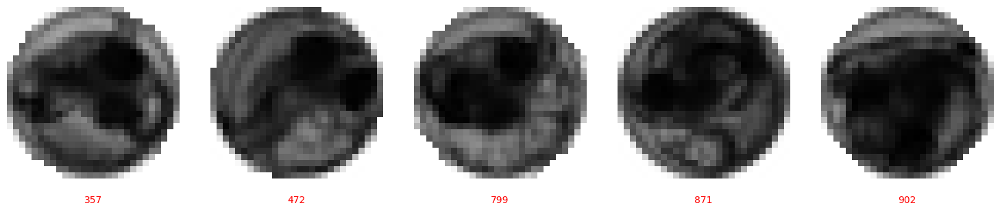

163


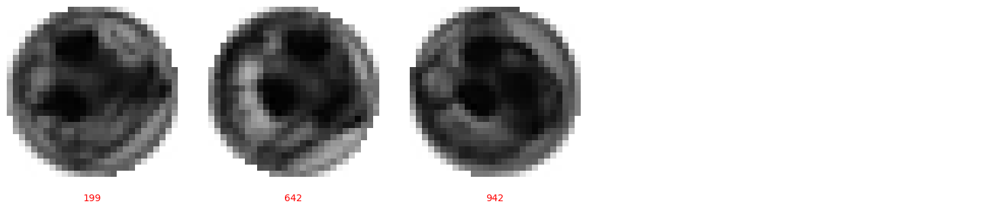

164


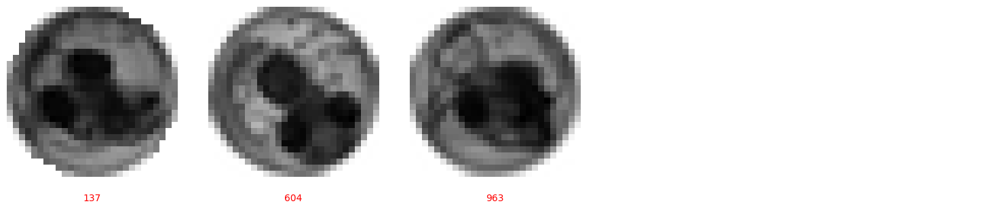

165


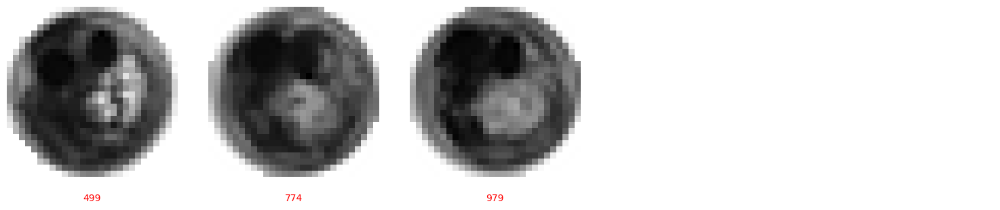

166


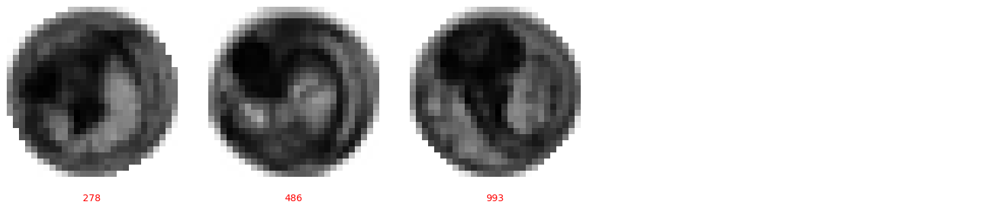

-1


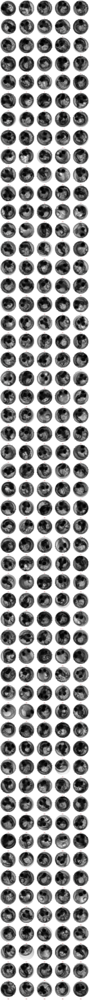

In [868]:
import math
quanti_rotated = []

for lab in set(labels):
    # Suponha que você queira o cluster de rótulo 3
    cluster_label = lab

    print(lab)

    # Encontrar os índices das imagens que pertencem a esse cluster
    cluster_indices = np.where(labels == cluster_label)[0]

    # Selecionar as imagens do tensor original usando os índices encontrados
    selected_images = tensor_images_few[cluster_indices]

    # Definir quantas imagens por linha e calcular o número necessário de linhas
    images_per_row = 5
    num_images = len(selected_images)
    num_rows = math.ceil(num_images / images_per_row)

    # Criar uma figura com subplots
    fig, axes = plt.subplots(num_rows, images_per_row, figsize=(15, 3 * num_rows))

    # Achatar a array de eixos para facilitar o mapeamento da imagem para o subplot
    axes_flat = axes.flatten()

    # Loop para plotar cada imagem no subplot correspondente
    for i, image in enumerate(selected_images):
        ax = axes_flat[i]
        ax.imshow(image.reshape(H, W), cmap='gray')
        ax.axis('off')

        # Obter o índice real no tensor principal e colocá-lo abaixo da imagem
        real_index = cluster_indices[i]
        ax.text(0.5, -0.1, str(real_index), transform=ax.transAxes, ha='center', va='top', fontsize=10, color='red')


    # Se houver menos imagens do que espaços de subplot, esconda os subplots extras
    for j in range(i + 1, len(axes_flat)):
        axes_flat[j].axis('off')

    plt.tight_layout()
    plt.show()




**VAmos ver as metricas de quantificação de similaridade entre clusters:**

**Now let's see how it behaves when the rotation algo os not apllyed previously**

[t-SNE] Computing 22 nearest neighbors...
[t-SNE] Indexed 1000 samples in 0.004s...
[t-SNE] Computed neighbors for 1000 samples in 0.098s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1000
[t-SNE] Mean sigma: 1.114099
[t-SNE] KL divergence after 250 iterations with early exaggeration: 82.925522
[t-SNE] KL divergence after 1300 iterations: 1.444606


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



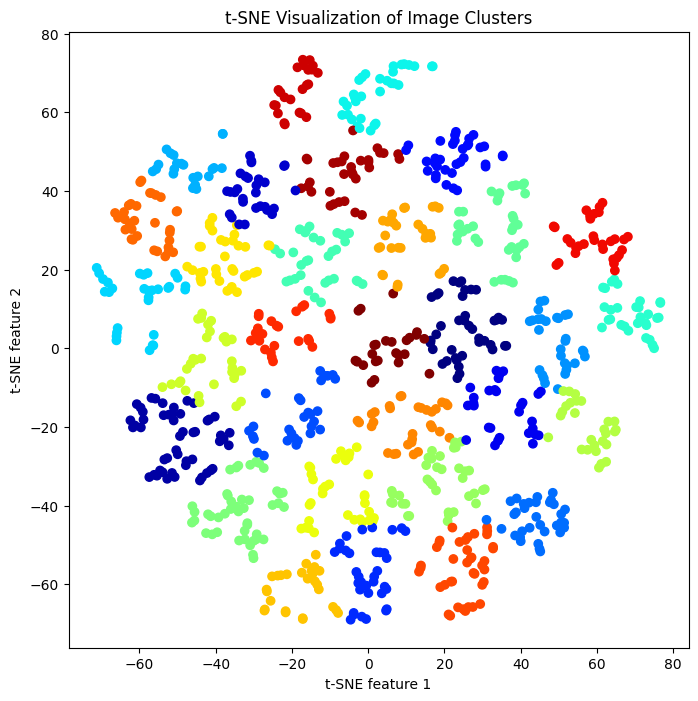

In [869]:
import torch
import numpy as np
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

few_images = tensor_images_resized[1000:2000]

# Supondo que 'tensor_images' seja o seu tensor de imagens em escala de cinza [N, H, W]
# Primeiro, você precisará remodelar o tensor para [N, H*W] para obter um conjunto de dados 2D
N, H, W = few_images.shape
images_reshaped = few_images.reshape(N, H*W)

# Normalizar os dados
images_reshaped = images_reshaped - images_reshaped.min()
images_reshaped = images_reshaped / images_reshaped.max()

# Reduzir a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, verbose=1, perplexity=7, n_iter=1300)
tsne_results = tsne.fit_transform(images_reshaped)

# Aplicar K-means clustering
kmeans = KMeans(n_clusters=31)  # Escolha o número de clusters que você espera encontrar
cluster_labels = kmeans.fit_predict(tsne_results)

# Visualizar os resultados
plt.figure(figsize=(8, 8))
scatter = plt.scatter(tsne_results[:, 0], tsne_results[:, 1], c=cluster_labels, cmap='jet')
plt.title('t-SNE Visualization of Image Clusters')
plt.xlabel('t-SNE feature 1')
plt.ylabel('t-SNE feature 2')

# Definir o colormap
cmap = plt.get_cmap('jet')

**Lets see how images without previous rotation looks like by cluster**


[t-SNE] Computing 22 nearest neighbors...
[t-SNE] Indexed 1000 samples in 0.001s...
[t-SNE] Computed neighbors for 1000 samples in 0.057s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1000
[t-SNE] Mean sigma: 1.114099
[t-SNE] KL divergence after 250 iterations with early exaggeration: 82.924767
[t-SNE] KL divergence after 1300 iterations: 1.444297


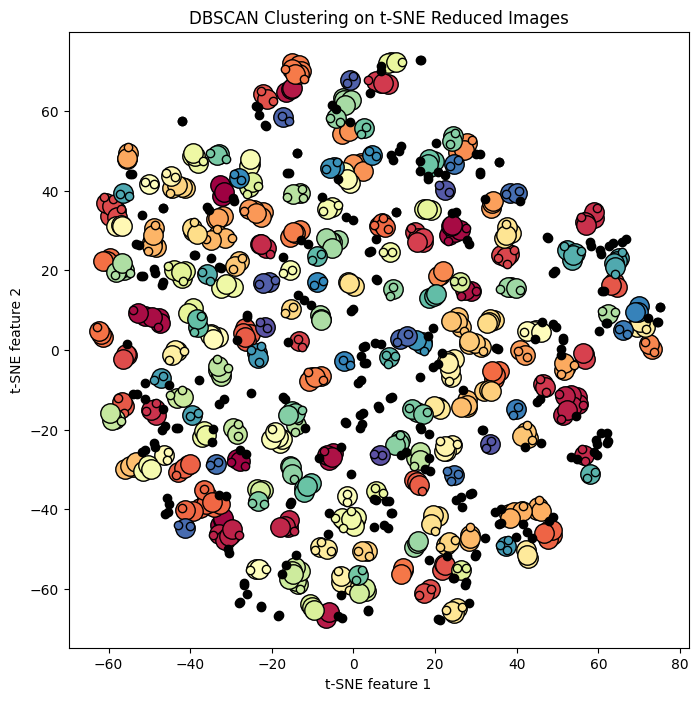

Número estimado de clusters: 176


In [870]:
import torch
import numpy as np
from sklearn.manifold import TSNE
from sklearn.cluster import DBSCAN
import matplotlib.pyplot as plt

# Supondo que 'tensor_de_tensores' seja o seu tensor de imagens em escala de cinza [N, H, W]
tensor_images_few = tensor_images_resized[1000:2000]

# Primeiro, você precisará remodelar o tensor para [N, H*W] para obter um conjunto de dados 2D
N, H, W = tensor_images_few.shape
images_reshaped = tensor_images_few.reshape(N, H*W)

# Normalizar os dados
images_reshaped = images_reshaped - images_reshaped.min()
images_reshaped = images_reshaped / images_reshaped.max()

# Reduzir a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, verbose=1, perplexity=7, n_iter=1300)
tsne_results = tsne.fit_transform(images_reshaped)

# Aplicar DBSCAN clustering
dbscan = DBSCAN(eps=2, min_samples=3)  # Ajuste os parâmetros conforme necessário
dbscan.fit(tsne_results)

# Visualizar os resultados
plt.figure(figsize=(8, 8))

# Cores para os clusters e ruídos
core_samples_mask = np.zeros_like(dbscan.labels_, dtype=bool)
core_samples_mask[dbscan.core_sample_indices_] = True
labels = dbscan.labels_

# Plot
unique_labels = set(labels)
colors = [plt.cm.Spectral(each) for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Pontos de ruído são marcados com preto
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)

    # Plot dos pontos do núcleo
    xy = tsne_results[class_member_mask & core_samples_mask]
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col), markeredgecolor='k', markersize=14)

    # Plot dos pontos de borda
    xy = tsne_results[class_member_mask & ~core_samples_mask]
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col), markeredgecolor='k', markersize=6)

plt.title('DBSCAN Clustering on t-SNE Reduced Images')
plt.xlabel('t-SNE feature 1')
plt.ylabel('t-SNE feature 2')
plt.show()

labels = dbscan.labels_
# Número de clusters é o número de rótulos únicos excluindo o ruído (-1)
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
print(f'Número estimado de clusters: {n_clusters_}')

In [871]:
import plotly.express as px

fig = px.scatter(x=tsne_results[:, 0], y=tsne_results[:, 1], color=labels.astype(str),
                 labels={'color': 'Cluster label'})

# Atualizar o layout do gráfico com os intervalos definidos
fig.update_layout(
    xaxis=dict(range=[-50, 50], autorange=False),
    yaxis=dict(range=[-50, 50], autorange=False, scaleanchor="x", scaleratio=1),
)

fig.show()

In [872]:
import numpy as np

# 'labels' contém os rótulos dos clusters atribuídos pelo DBSCAN, incluindo -1 para ruído
num_noise_points = np.sum(labels == -1)

# Contar o número único de rótulos, excluindo -1
unique_labels = set(labels) - {-1}
num_clusters = len(unique_labels)

# Calcular a proporção de pontos de ruído em relação ao número total de clusters
if num_clusters > 0:  # Evitar divisão por zero
    noise_to_cluster_ratio = num_noise_points / num_clusters
    print(f"Proporção de pontos de ruído por cluster: {noise_to_cluster_ratio:.2f}")
else:
    print("Não há clusters, apenas ruído.")



# 'labels' contém os rótulos dos clusters atribuídos pelo DBSCAN, incluindo -1 para ruído
num_noise_points = np.sum(labels == -1)

# Contar o número total de pontos que não são ruído
num_non_noise_points = np.sum(labels != -1)

# Contar o número único de rótulos, excluindo -1
unique_labels = set(labels) - {-1}
num_clusters = len(unique_labels)

# Calcular o número médio de imagens por cluster, excluindo o cluster de ruído
if num_clusters > 0:  # Evitar divisão por zero
    average_images_per_cluster = num_non_noise_points / num_clusters
    print(f"Número médio de imagens por cluster: {average_images_per_cluster:.2f}")
else:
    print("Não há clusters, apenas ruído.")



Proporção de pontos de ruído por cluster: 1.50
Número médio de imagens por cluster: 4.18


Cluster Label: 0


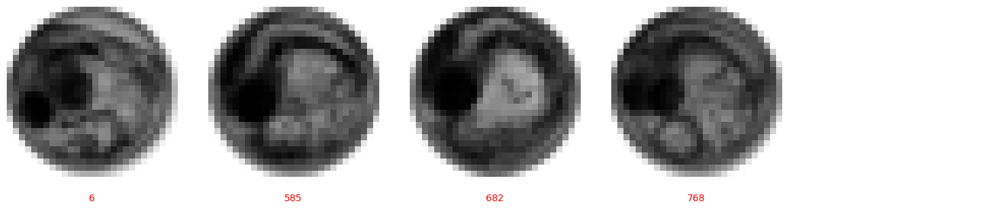

Cluster Label: 1


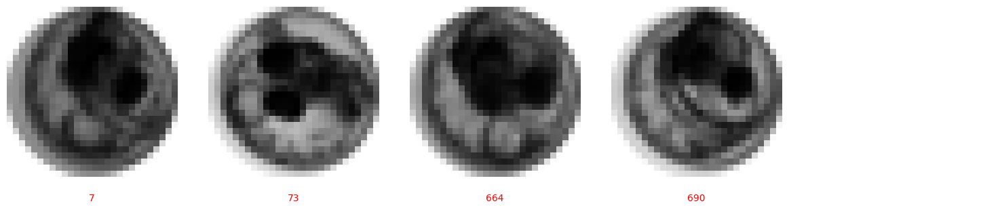

Cluster Label: 2


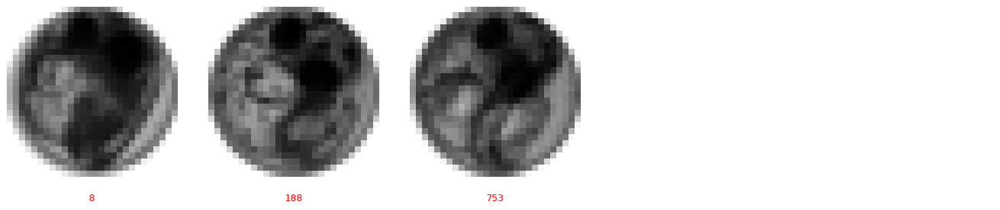

Cluster Label: 3


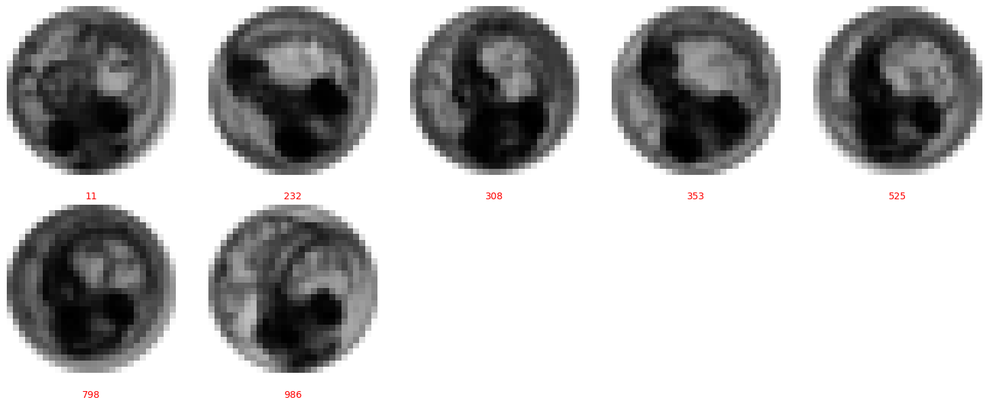

Cluster Label: 4


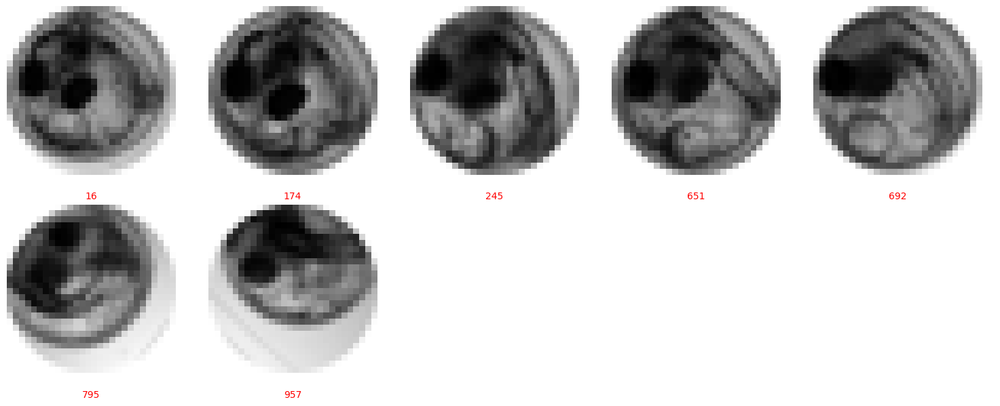

Cluster Label: 5


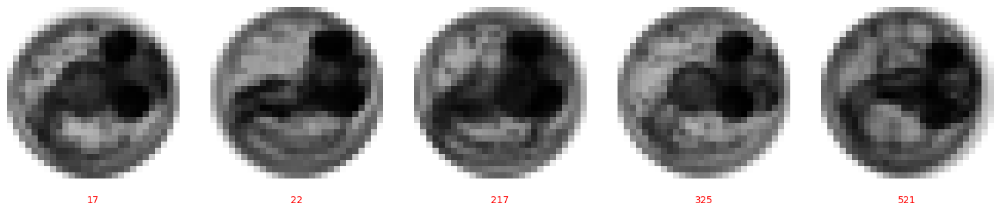

Cluster Label: 6


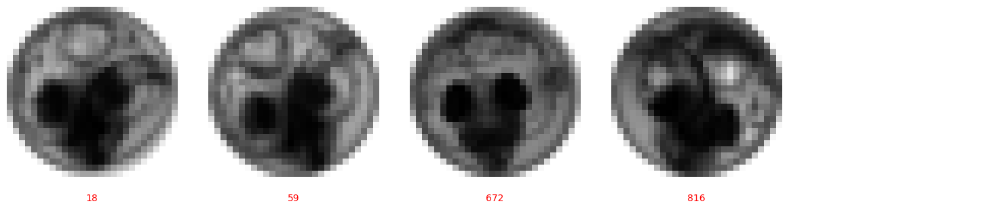

Cluster Label: 7


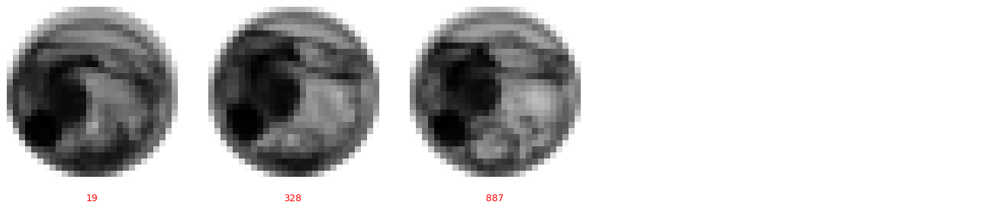

Cluster Label: 8


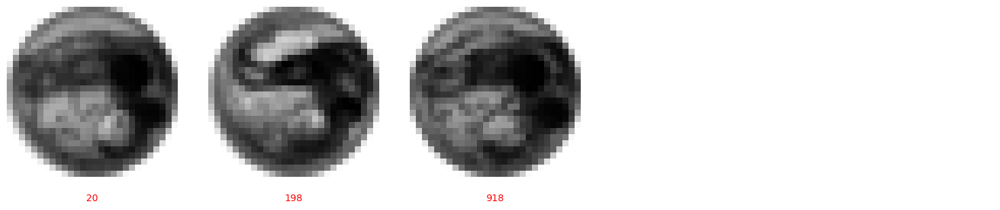

Cluster Label: 9


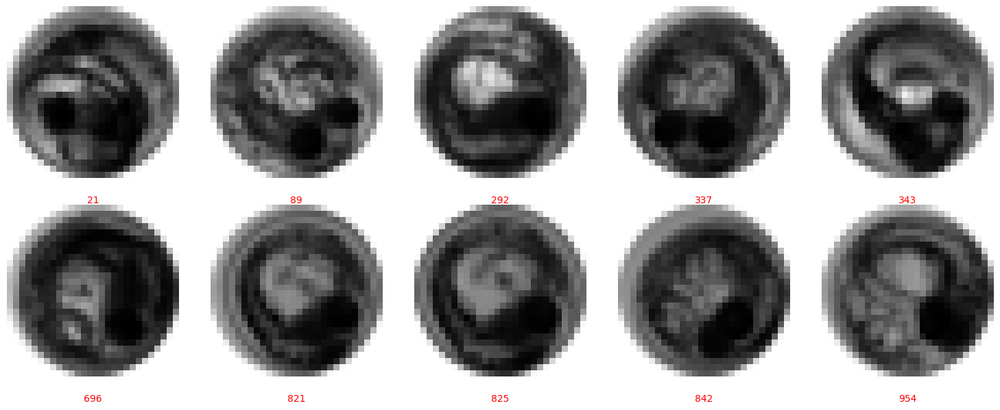

Cluster Label: 10


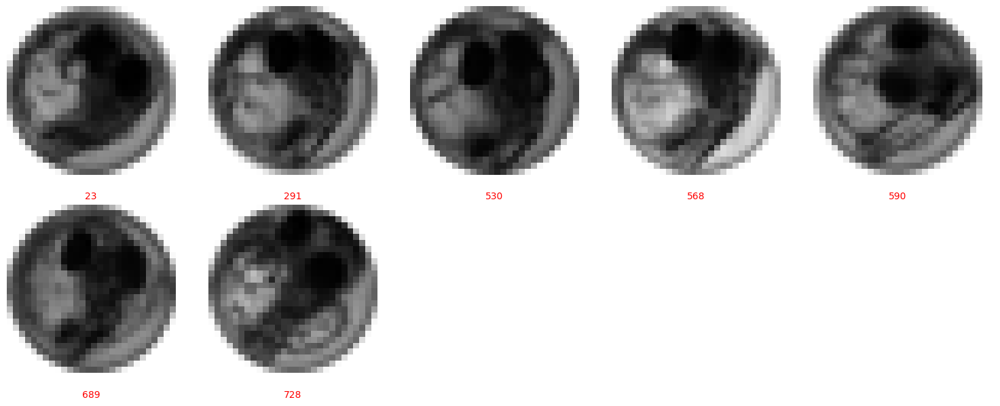

Cluster Label: 11


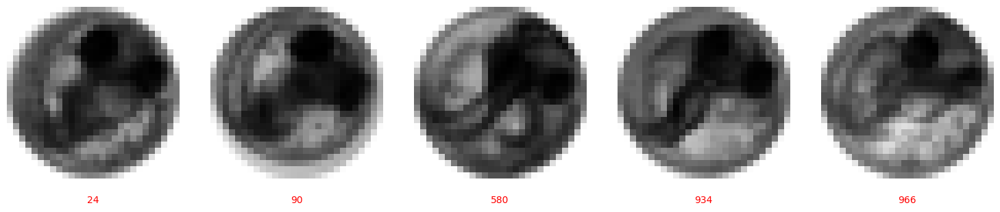

Cluster Label: 12


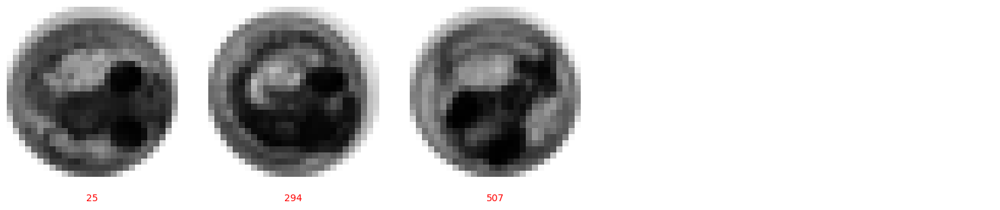

Cluster Label: 13


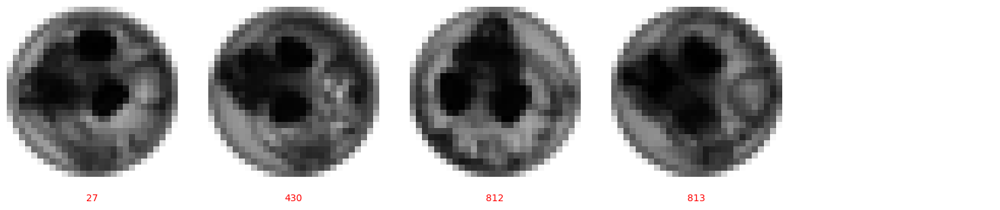

Cluster Label: 14


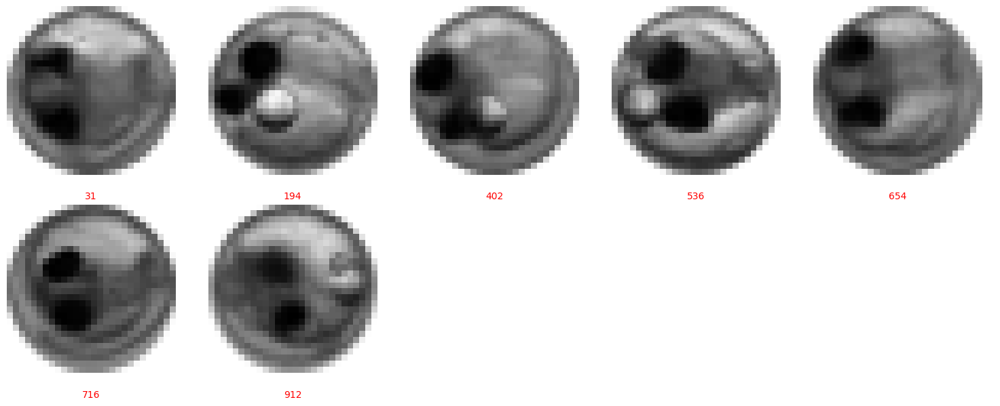

Cluster Label: 15


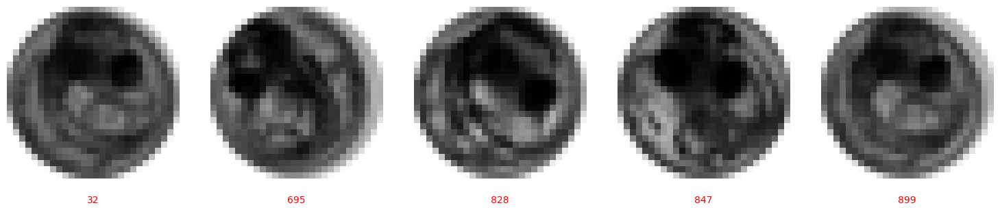

Cluster Label: 16


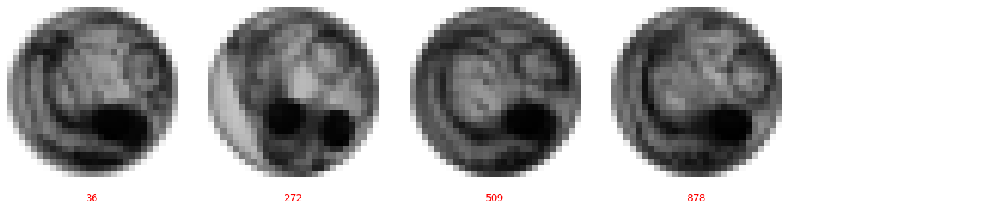

Cluster Label: 17


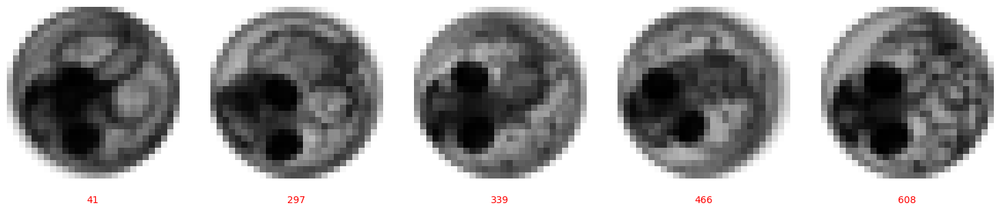

Cluster Label: 18


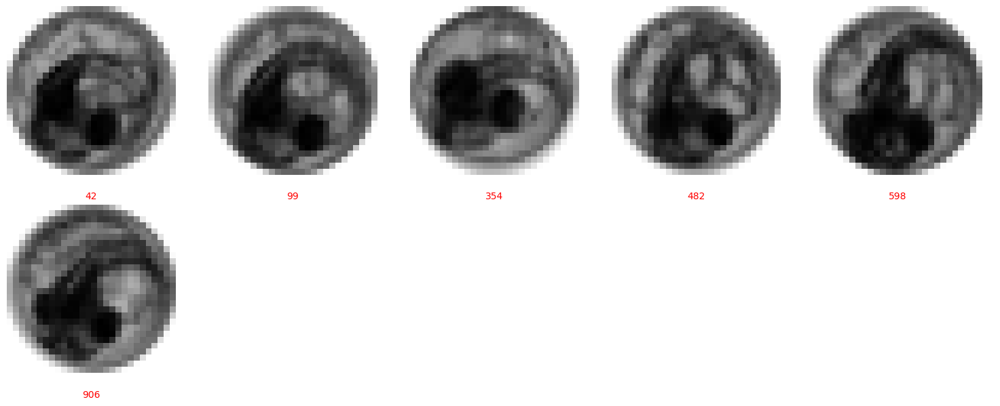

Cluster Label: 19


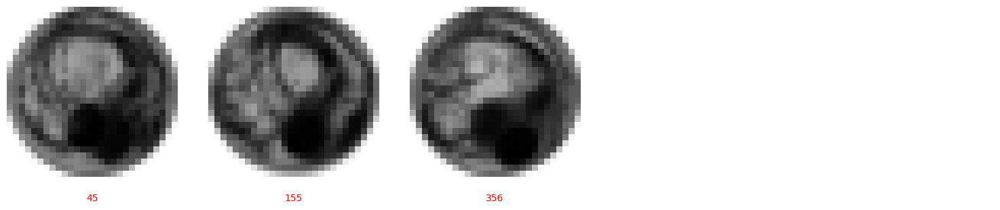

Cluster Label: 20


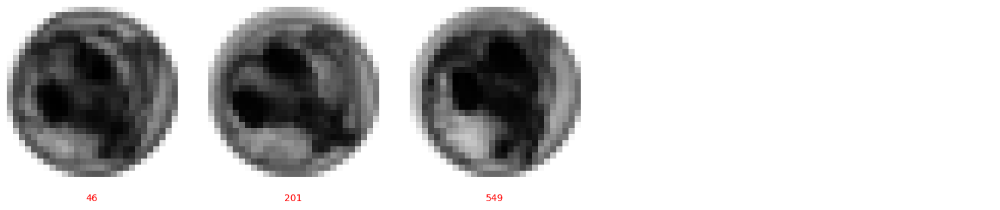

Cluster Label: 21


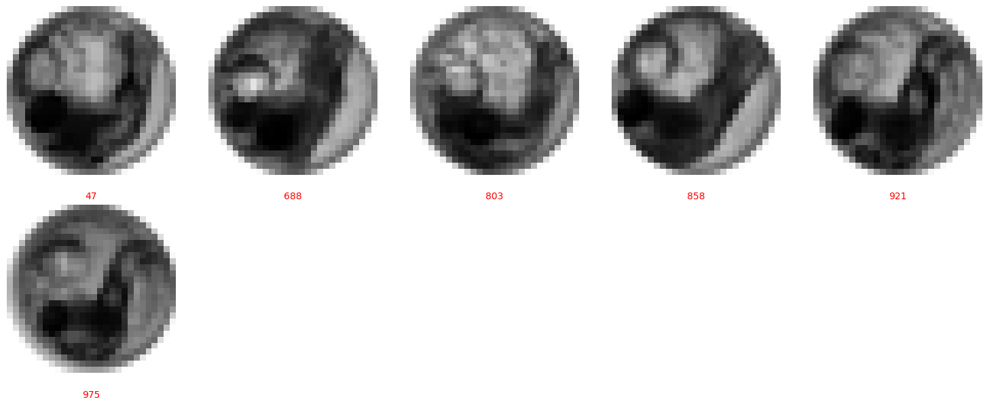

Cluster Label: 22


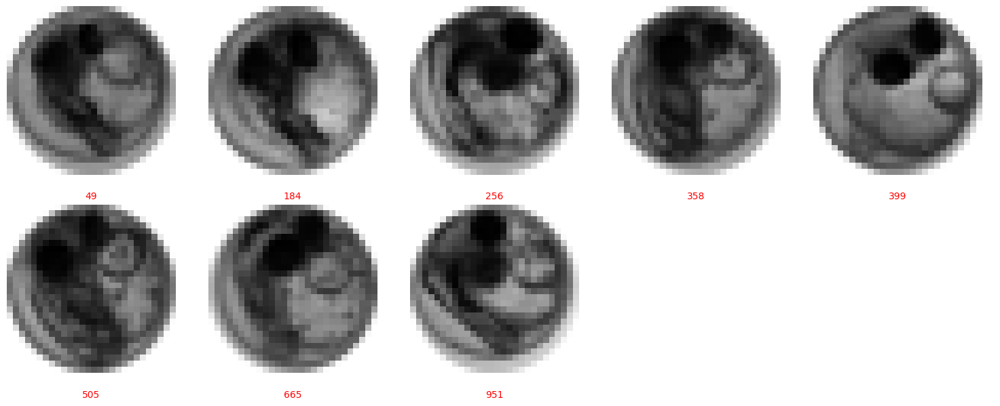

Cluster Label: 23


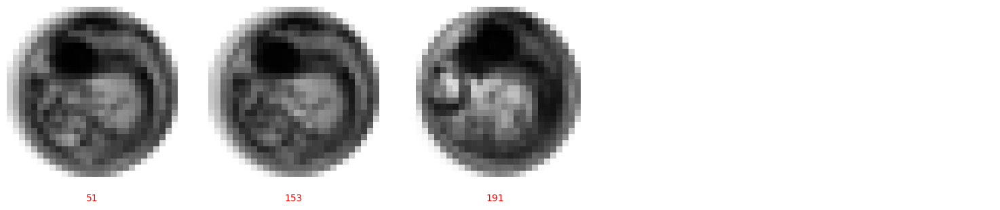

Cluster Label: 24


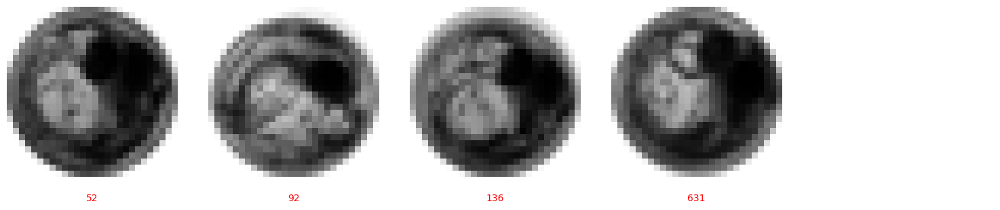

Cluster Label: 25


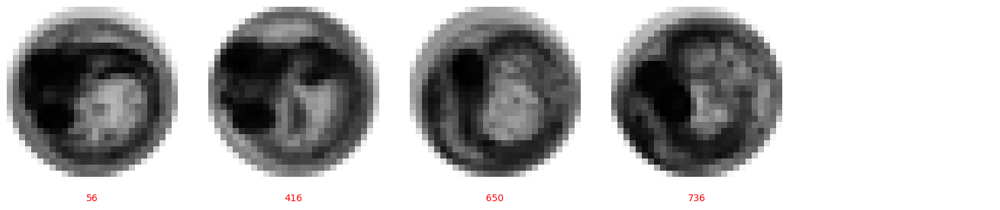

Cluster Label: 26


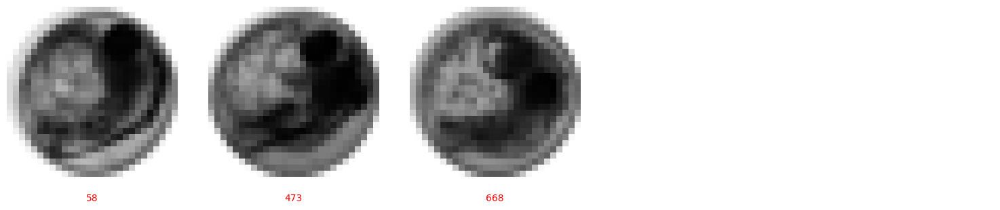

Cluster Label: 27


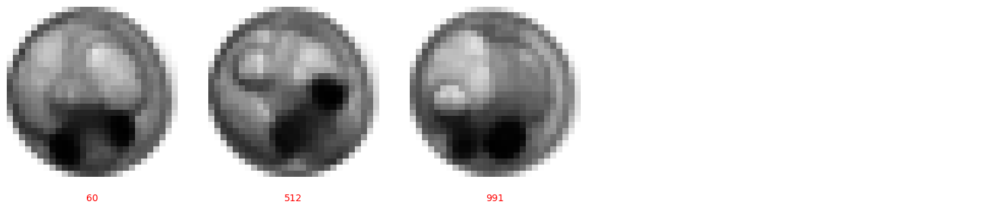

Cluster Label: 28


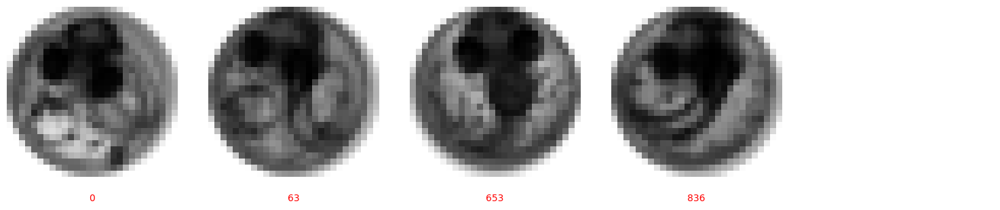

Cluster Label: 29


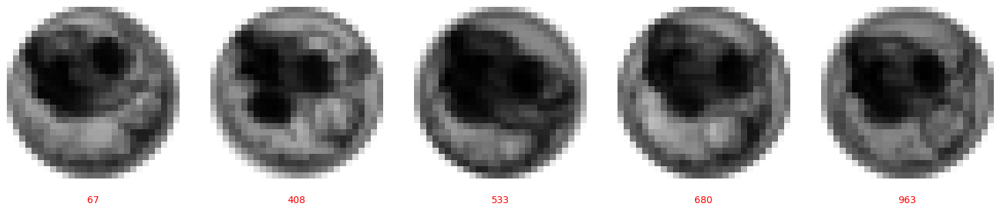

Cluster Label: 30


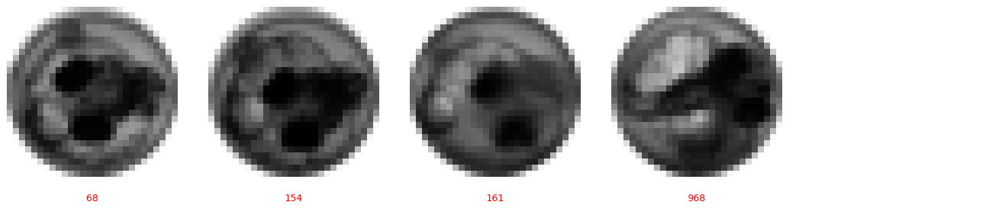

Cluster Label: 31


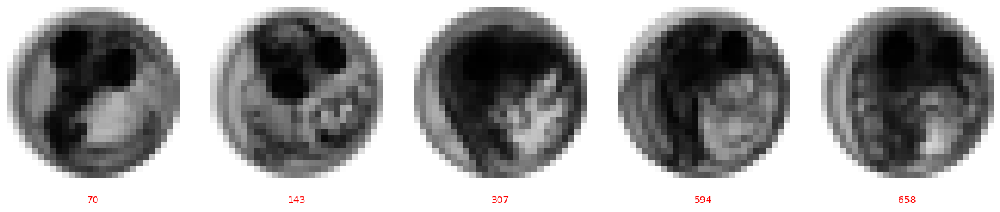

Cluster Label: 32


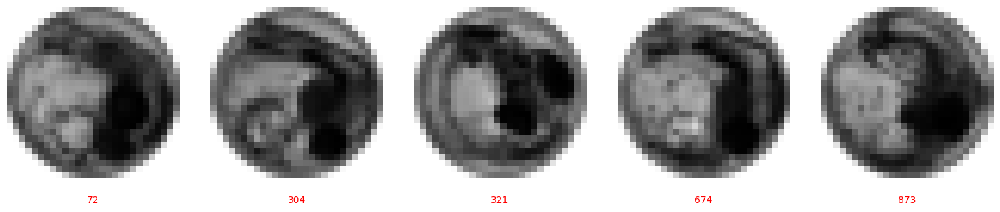

Cluster Label: 33


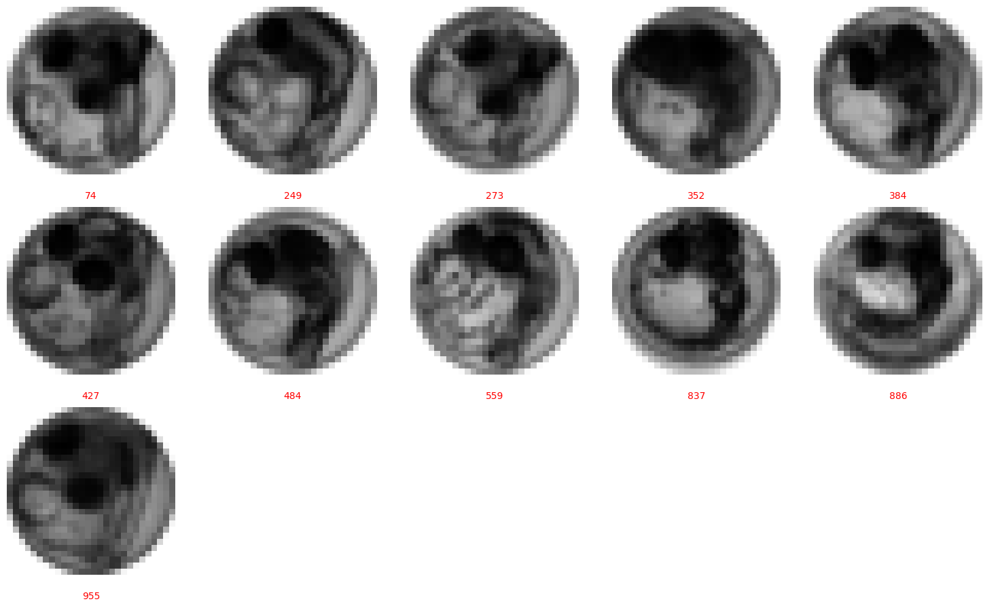

Cluster Label: 34


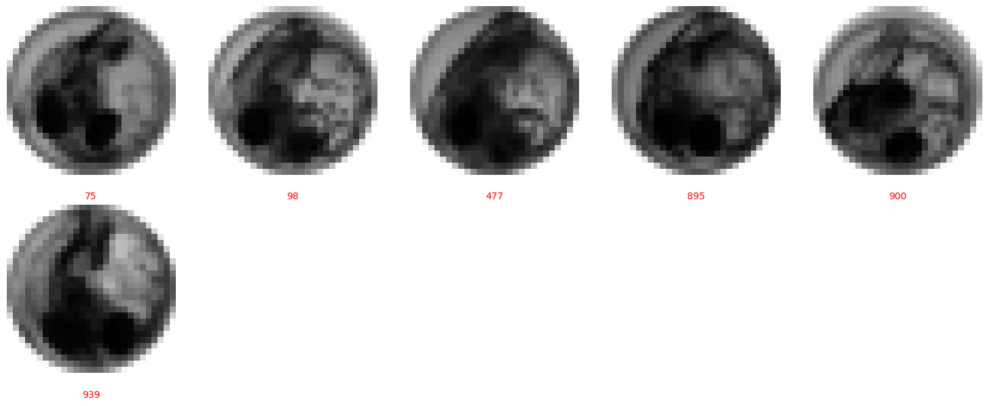

Cluster Label: 35


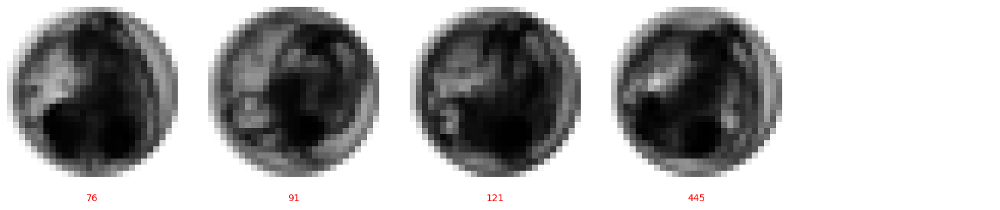

Cluster Label: 36


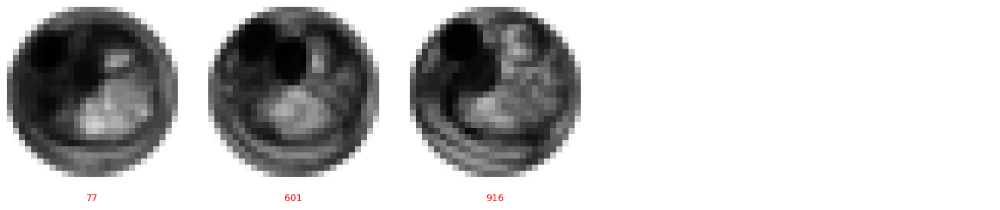

Cluster Label: 37


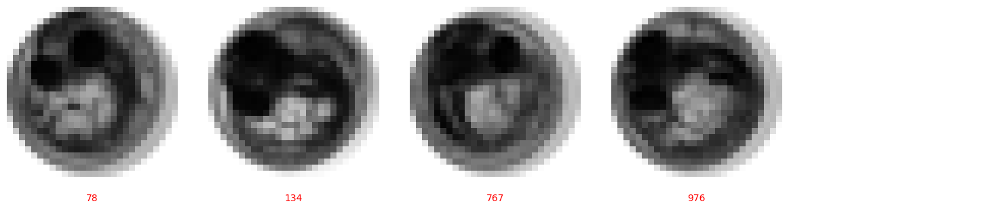

Cluster Label: 38


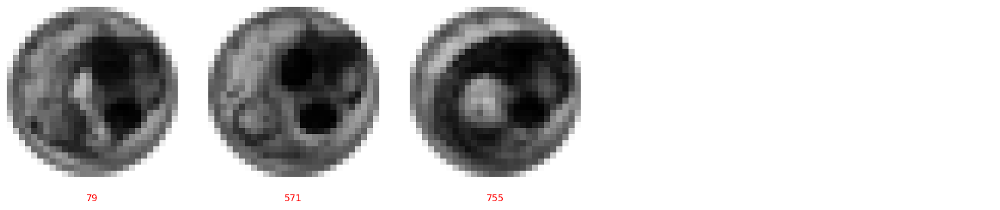

Cluster Label: 39


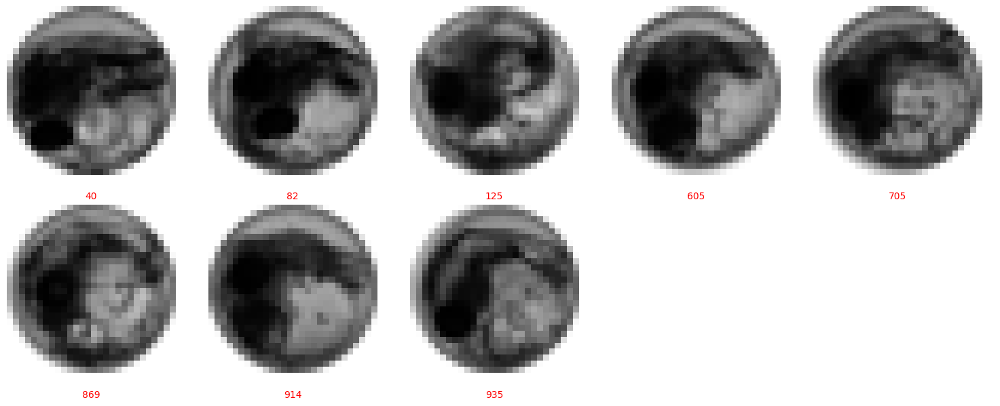

Cluster Label: 40


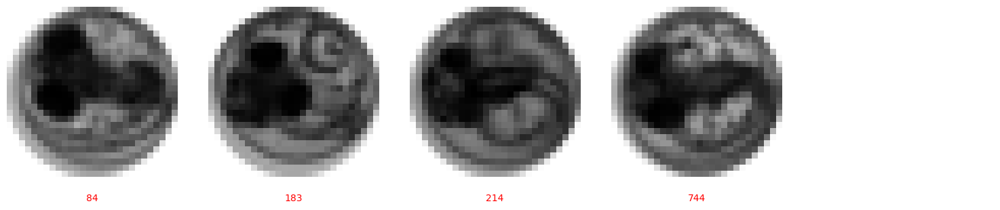

Cluster Label: 41


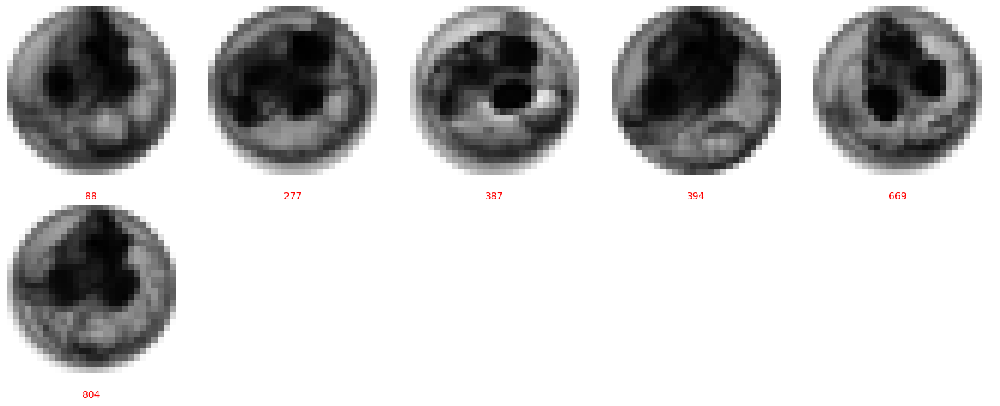

Cluster Label: 42


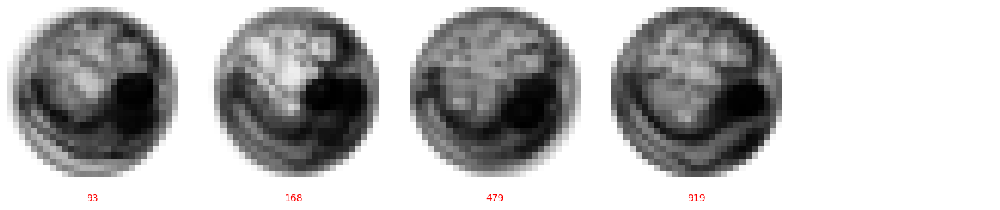

Cluster Label: 43


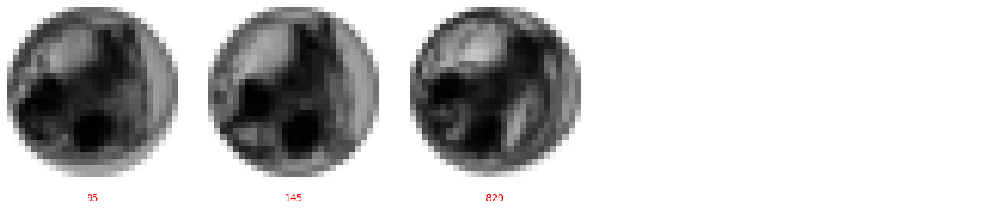

Cluster Label: 44


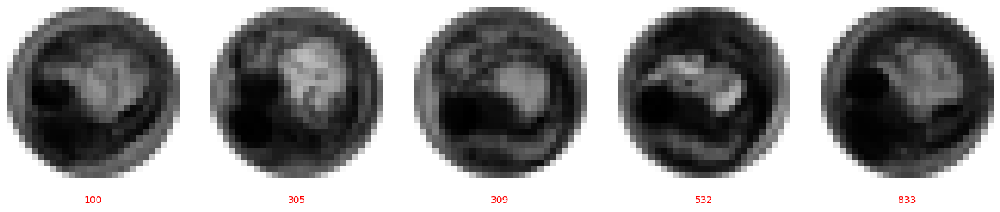

Cluster Label: 45


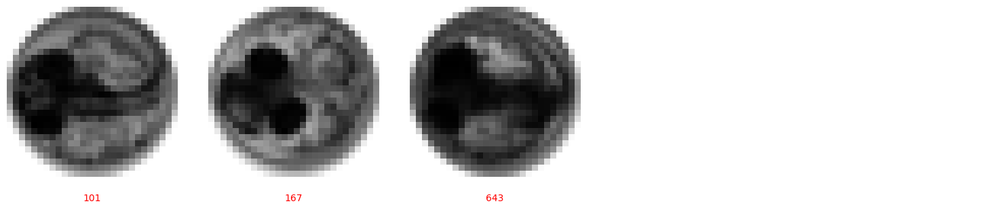

Cluster Label: 46


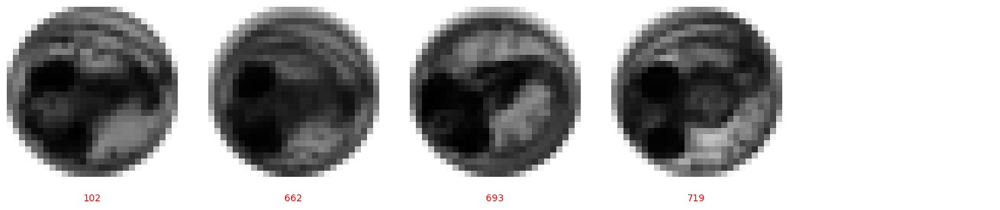

Cluster Label: 47


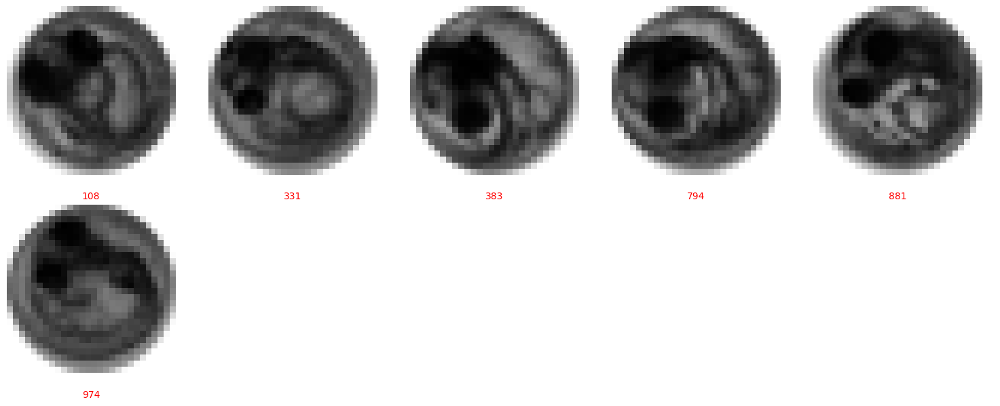

Cluster Label: 48


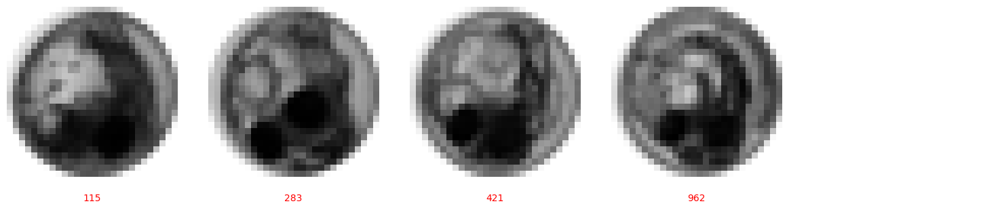

Cluster Label: 49


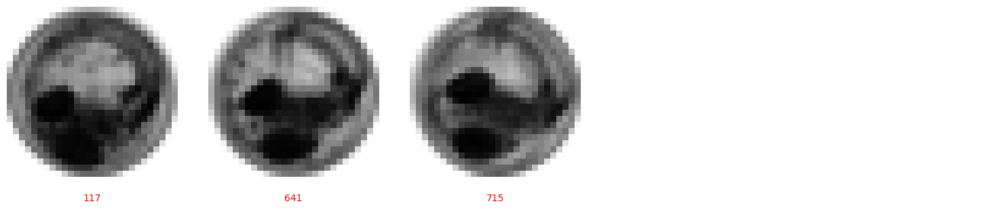

Cluster Label: 50


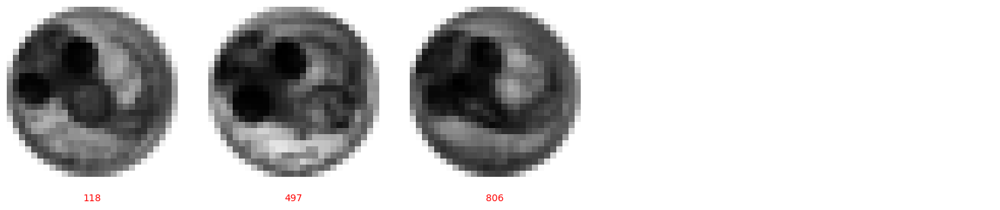

Cluster Label: 51


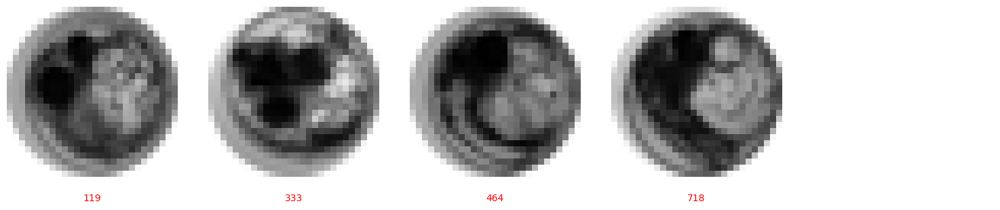

Cluster Label: 52


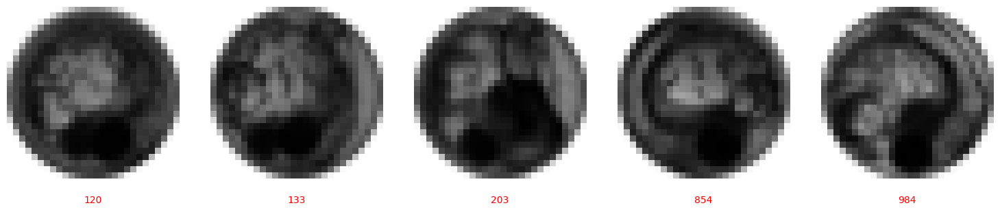

Cluster Label: 53


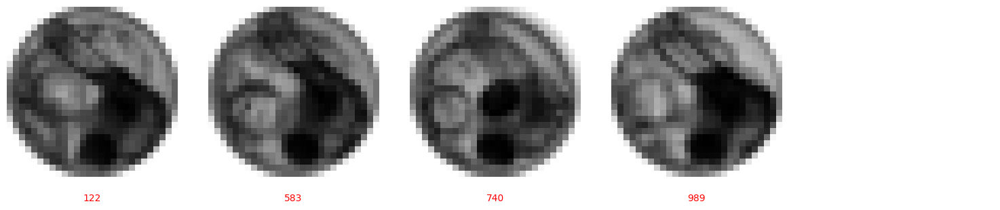

Cluster Label: 54


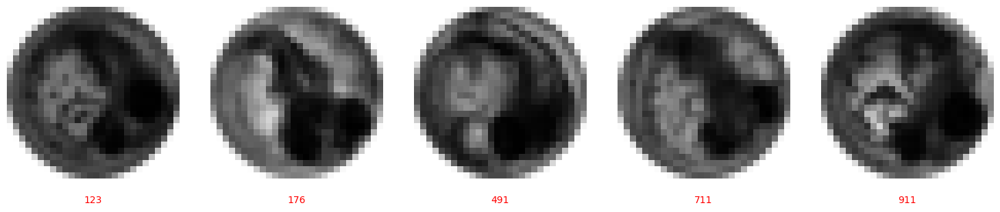

Cluster Label: 55


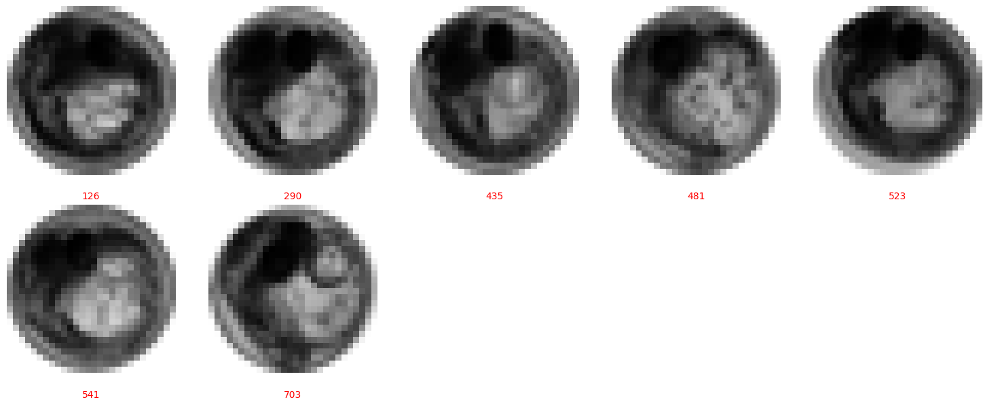

Cluster Label: 56


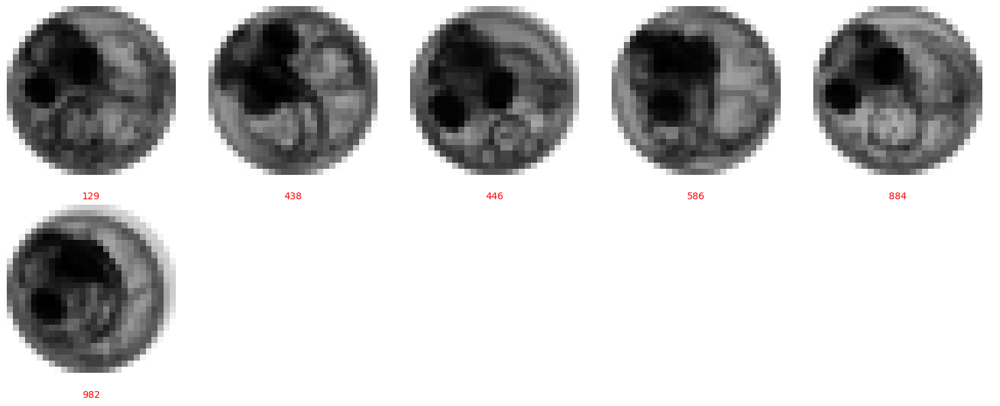

Cluster Label: 57


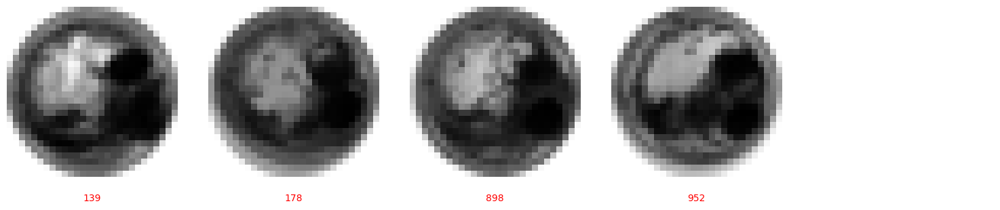

Cluster Label: 58


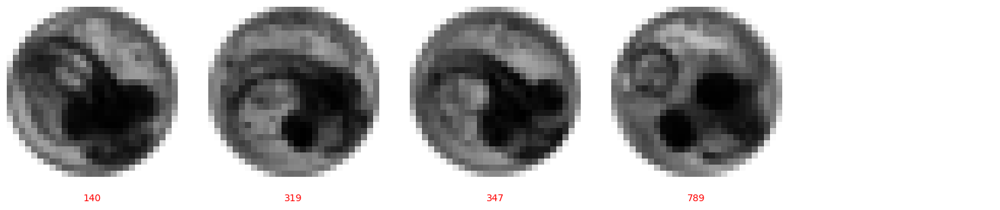

Cluster Label: 59


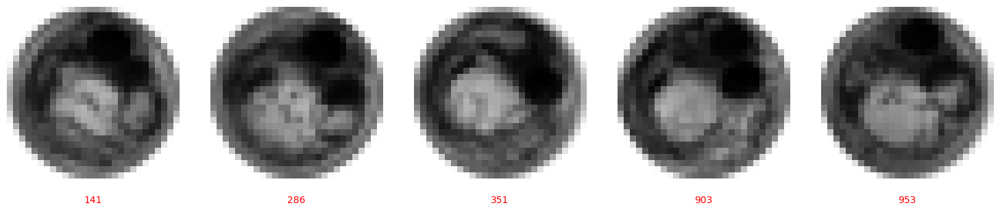

Cluster Label: 60


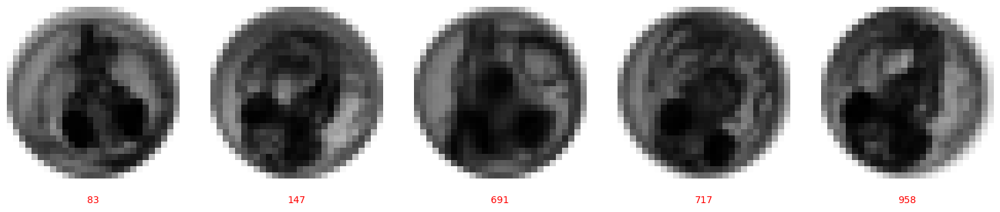

Cluster Label: 61


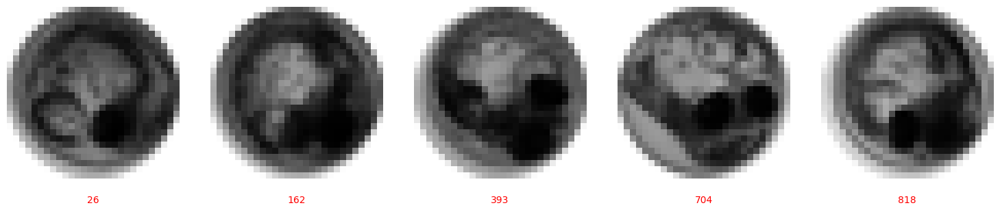

Cluster Label: 62


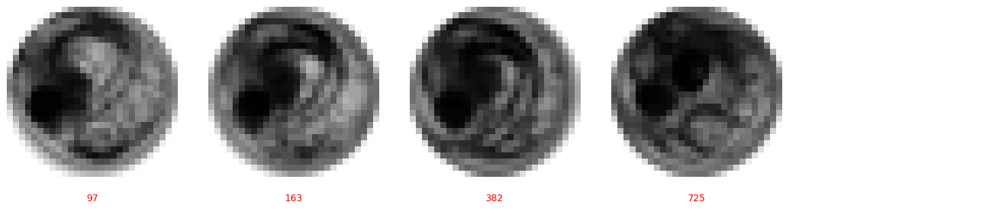

Cluster Label: 63


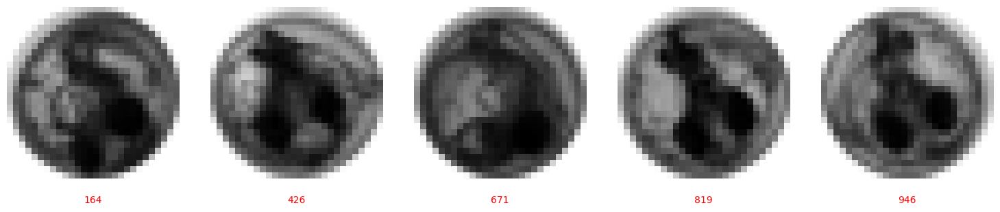

Cluster Label: 64


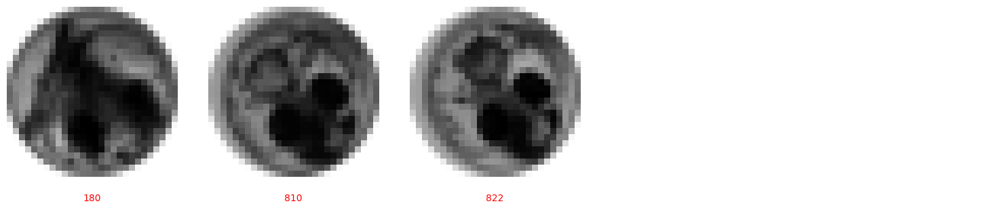

Cluster Label: 65


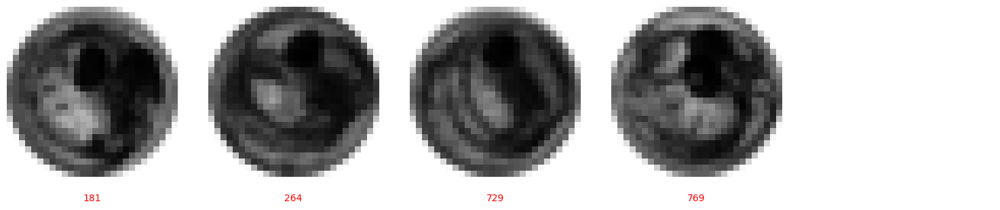

Cluster Label: 66


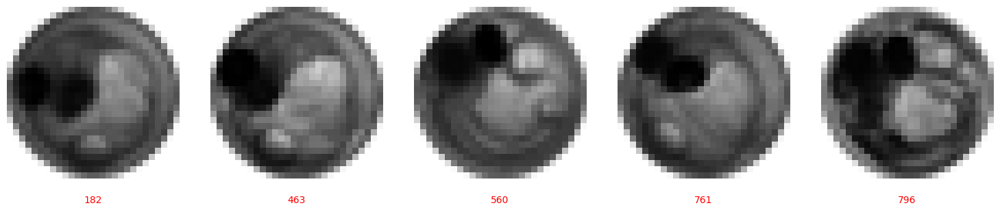

Cluster Label: 67


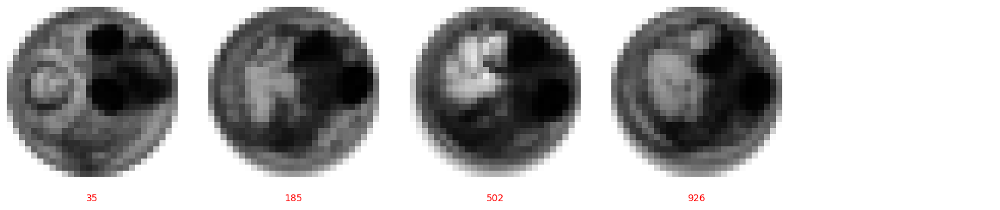

Cluster Label: 68


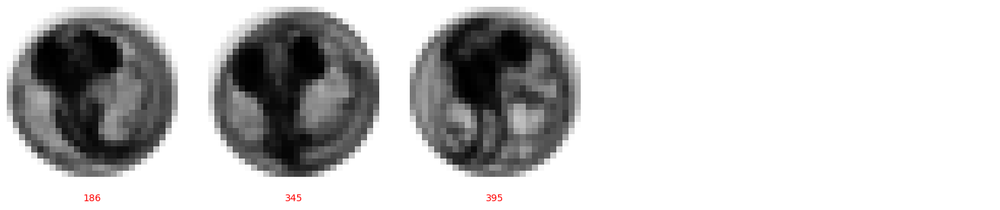

Cluster Label: 69


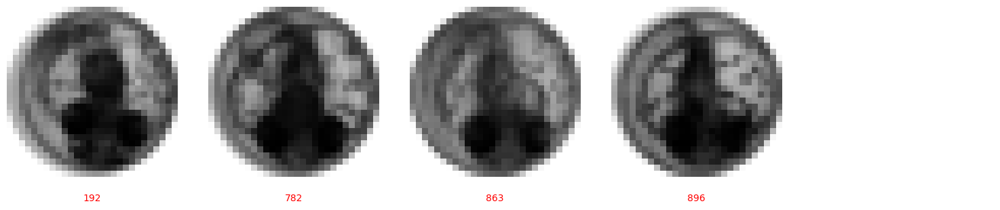

Cluster Label: 70


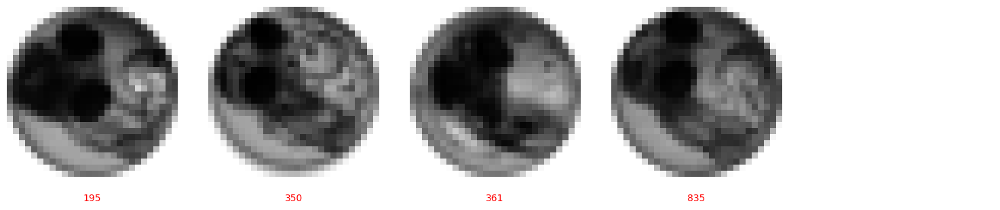

Cluster Label: 71


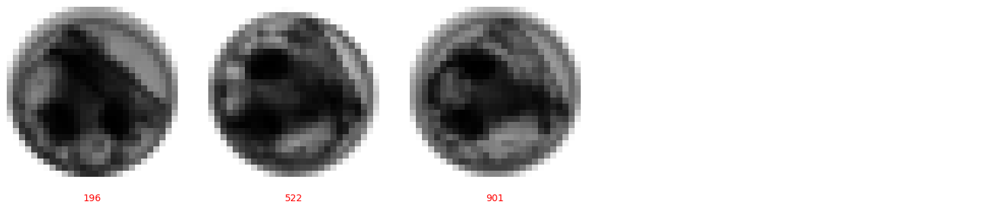

Cluster Label: 72


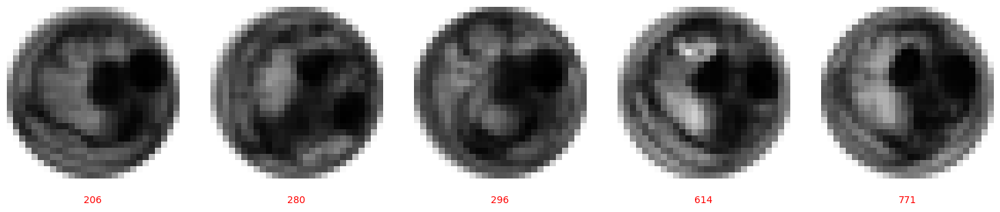

Cluster Label: 73


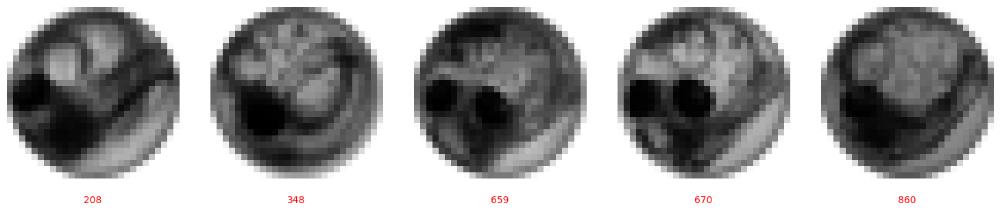

Cluster Label: 74


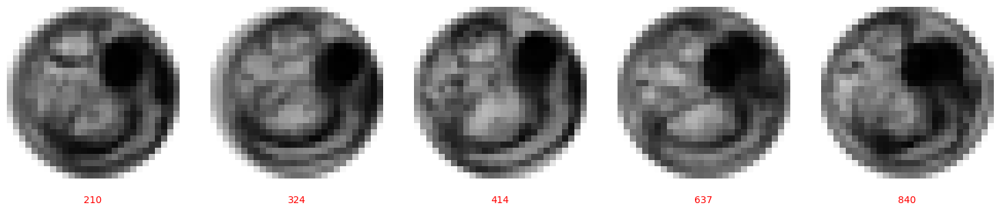

Cluster Label: 75


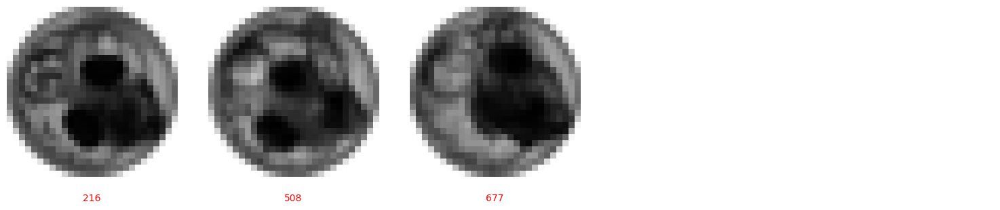

Cluster Label: 76


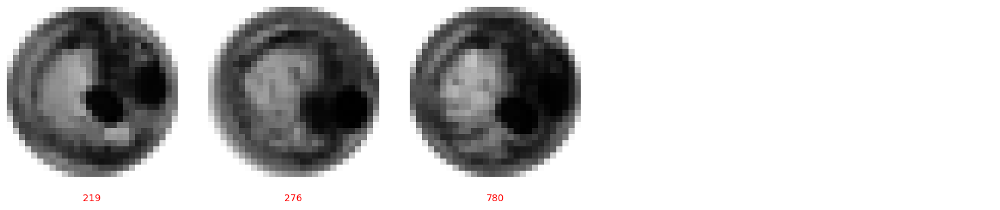

Cluster Label: 77


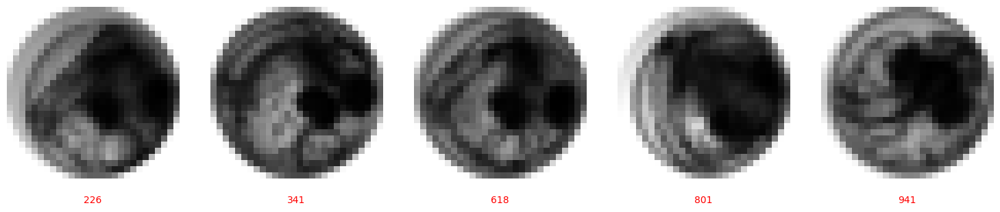

Cluster Label: 78


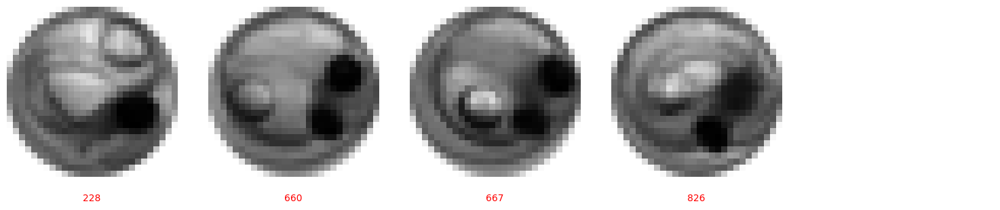

Cluster Label: 79


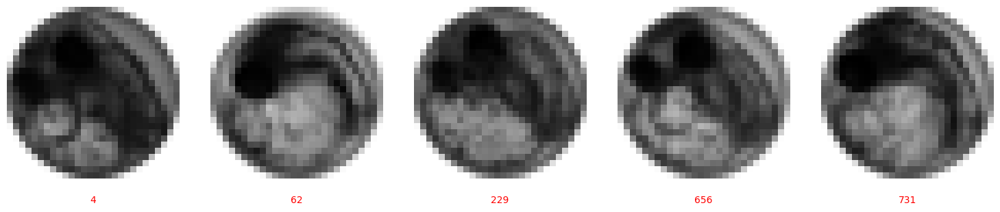

Cluster Label: 80


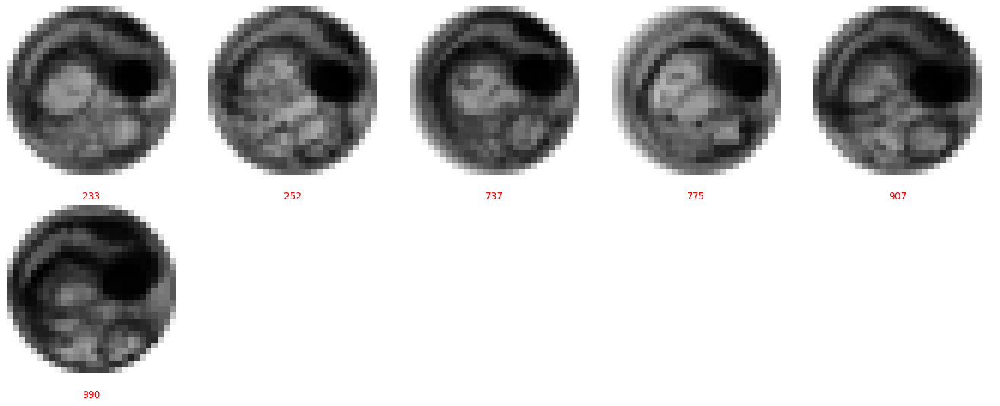

Cluster Label: 81


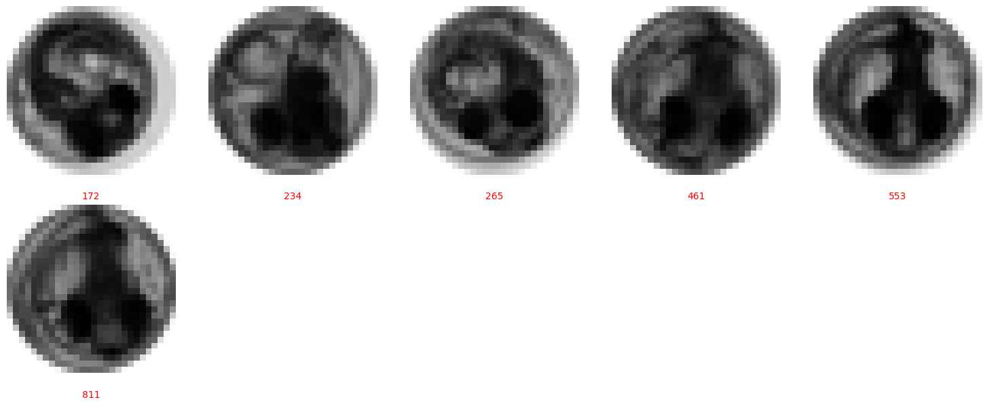

Cluster Label: 82


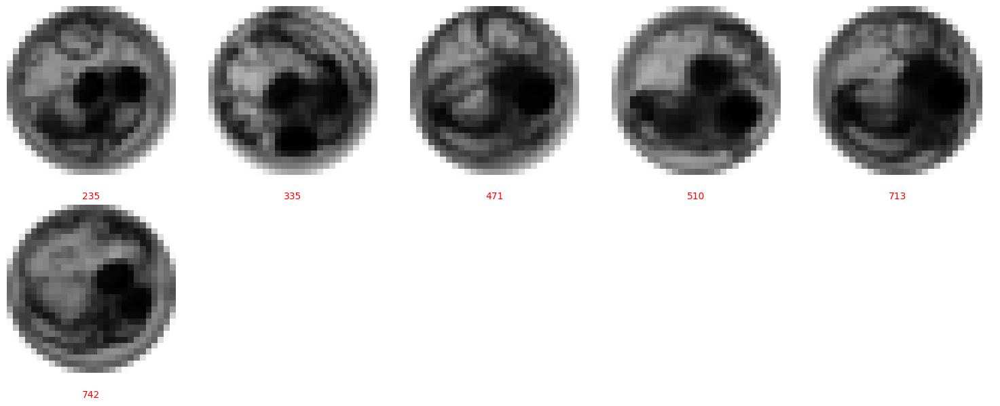

Cluster Label: 83


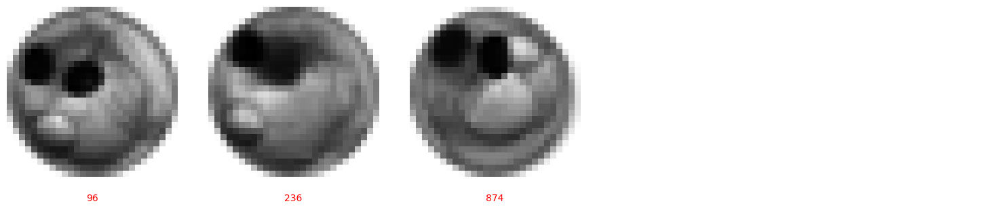

Cluster Label: 84


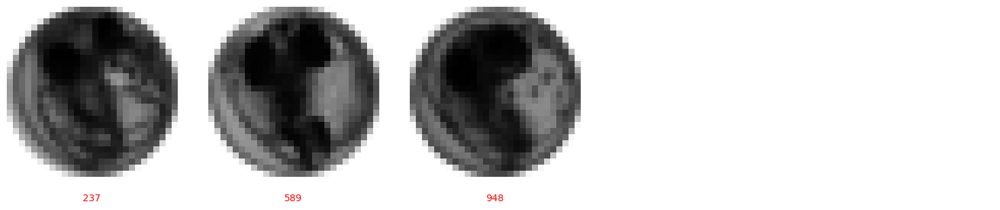

Cluster Label: 85


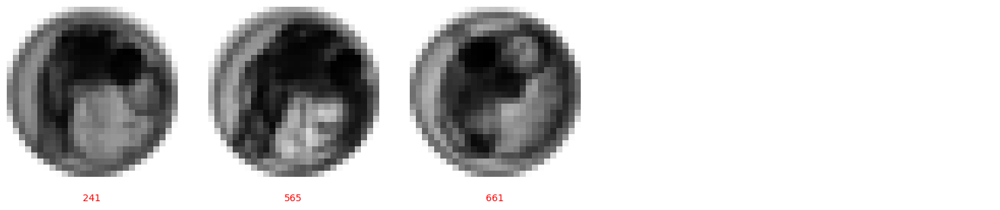

Cluster Label: 86


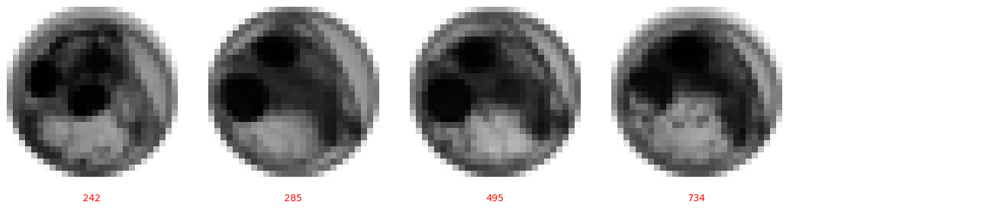

Cluster Label: 87


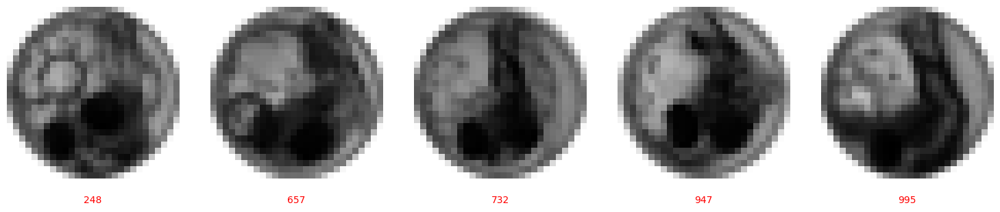

Cluster Label: 88


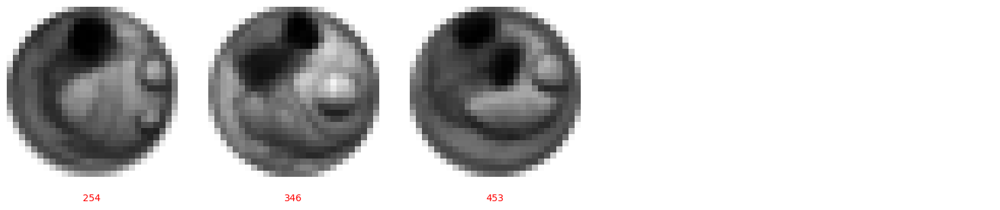

Cluster Label: 89


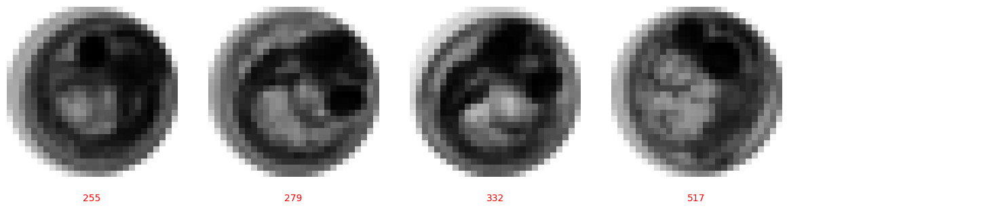

Cluster Label: 90


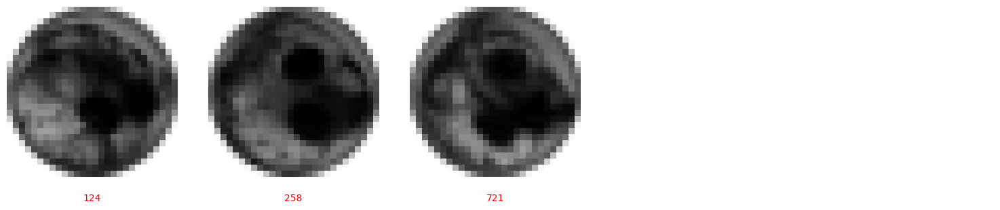

Cluster Label: 91


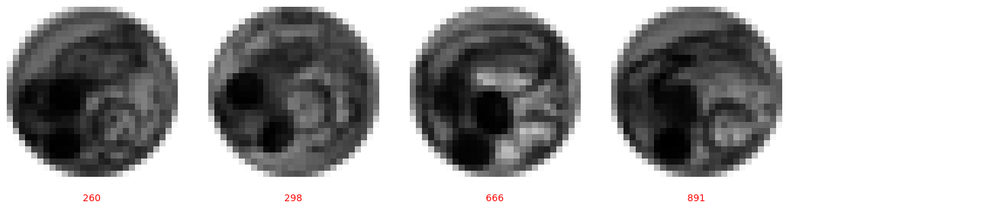

Cluster Label: 92


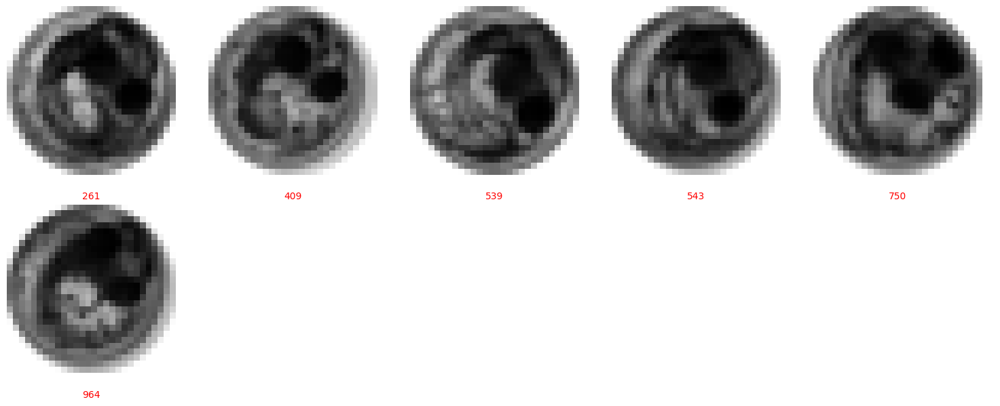

Cluster Label: 93


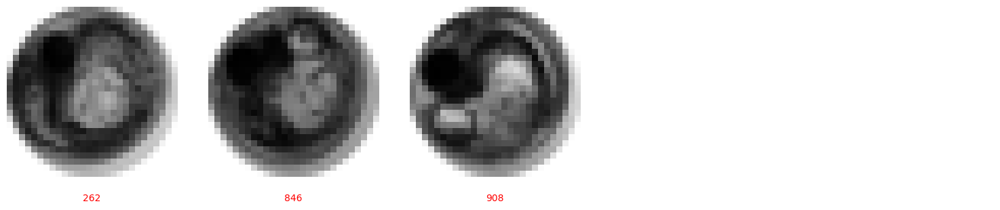

Cluster Label: 94


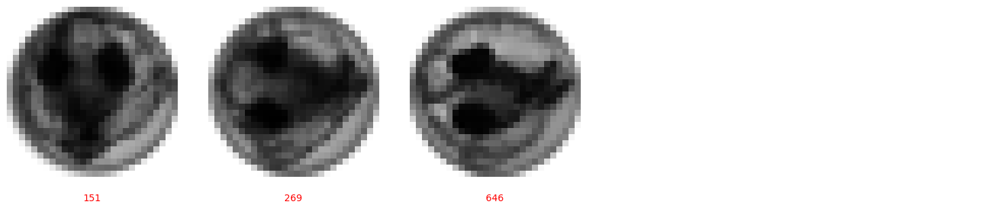

Cluster Label: 95


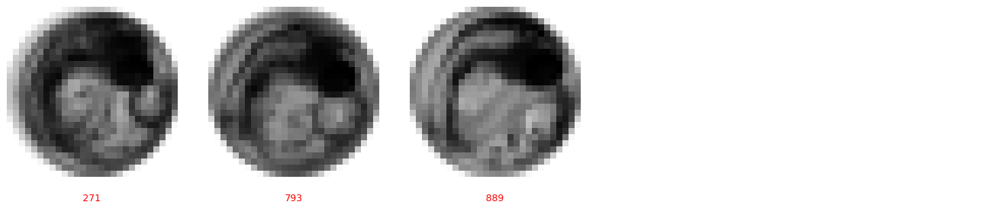

Cluster Label: 96


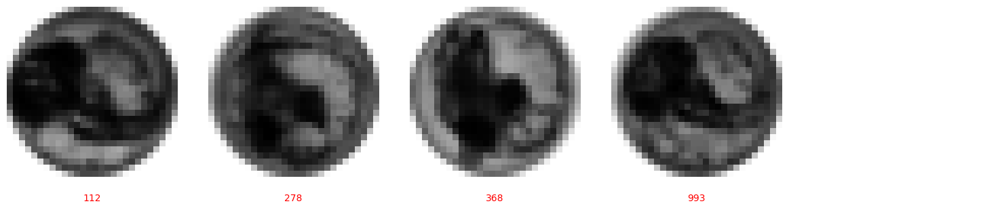

Cluster Label: 97


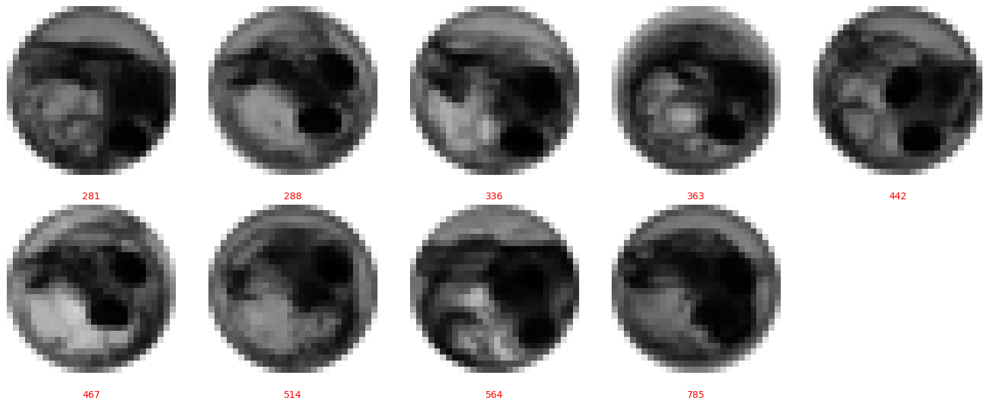

Cluster Label: 98


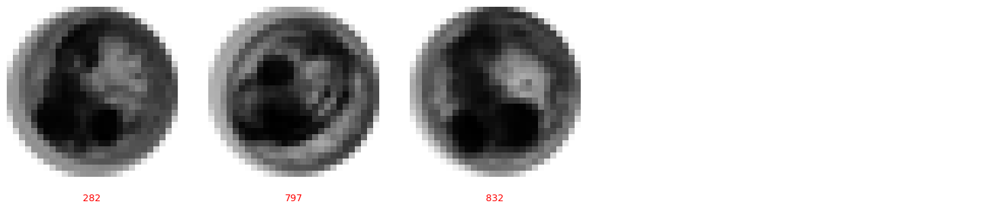

Cluster Label: 99


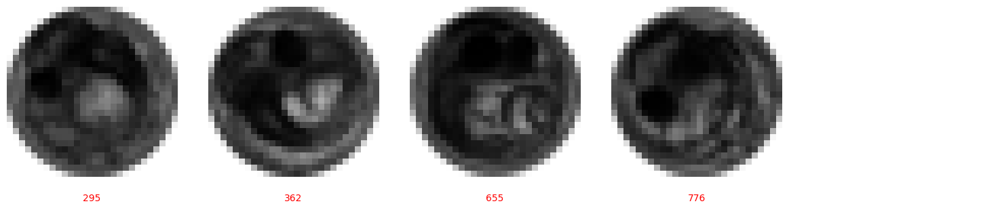

Cluster Label: 100


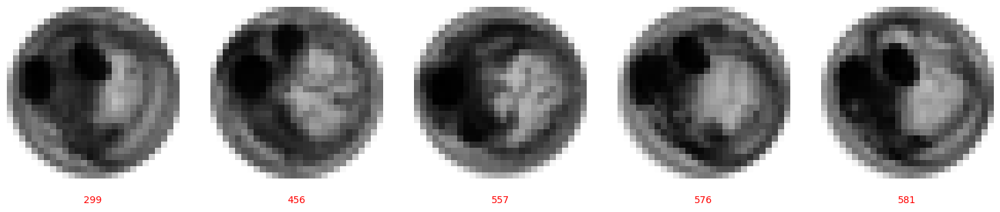

Cluster Label: 101


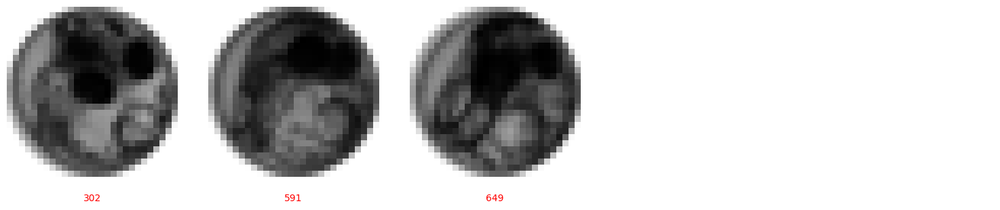

Cluster Label: 102


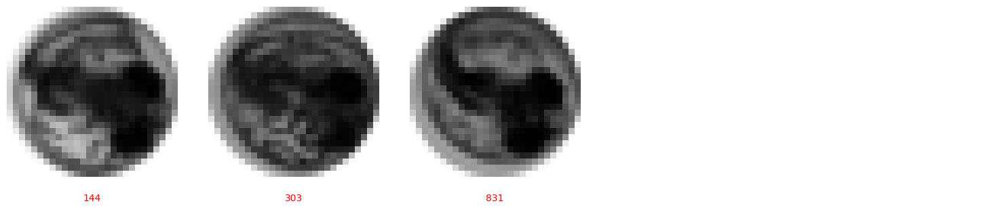

Cluster Label: 103


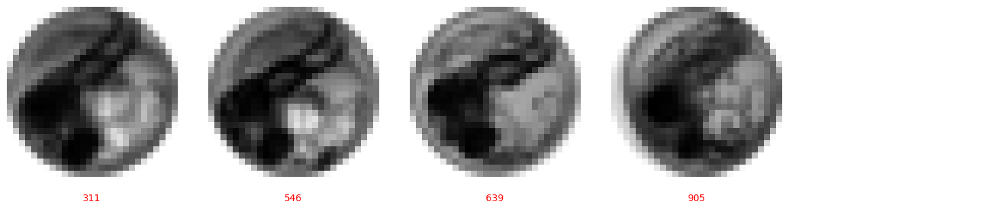

Cluster Label: 104


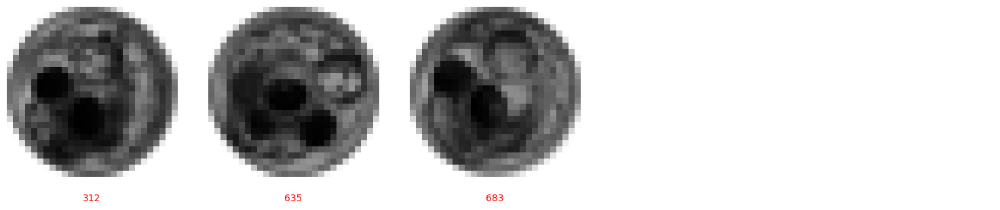

Cluster Label: 105


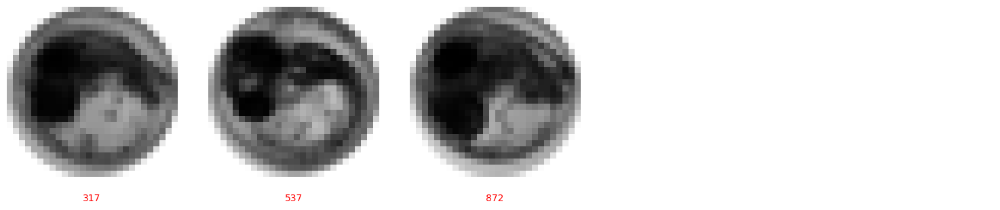

Cluster Label: 106


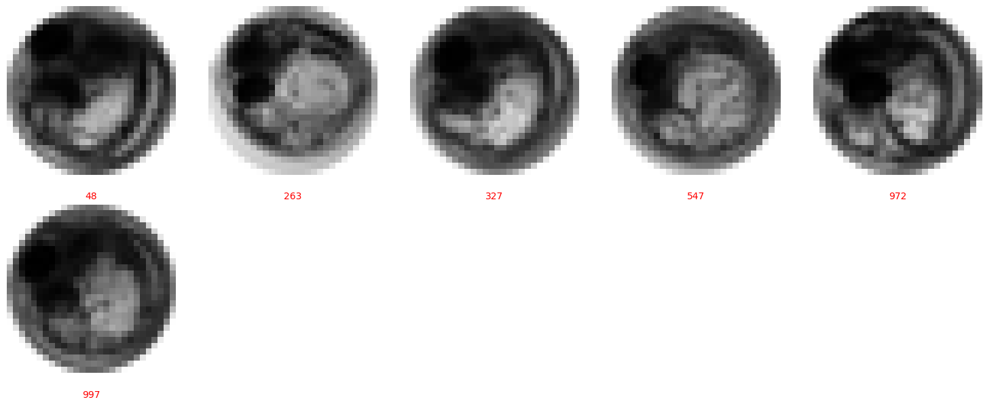

Cluster Label: 107


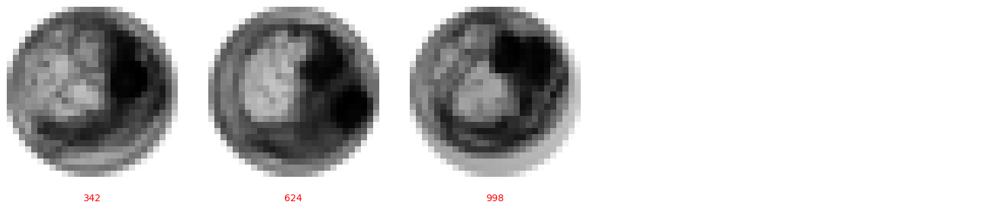

Cluster Label: 108


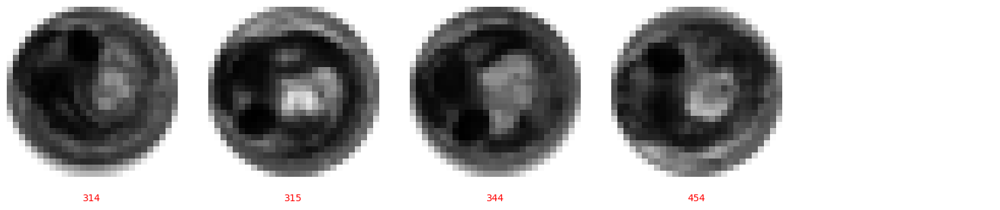

Cluster Label: 109


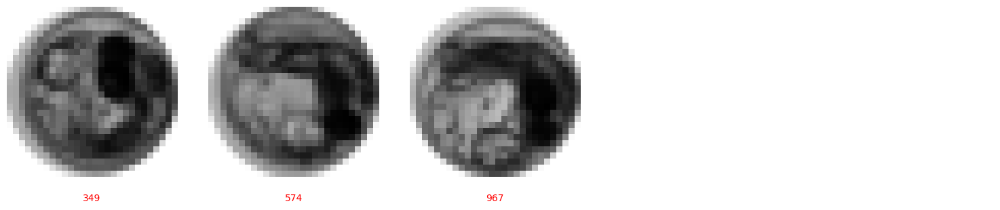

Cluster Label: 110


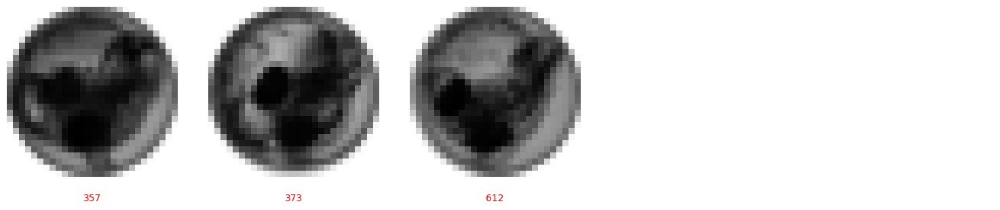

Cluster Label: 111


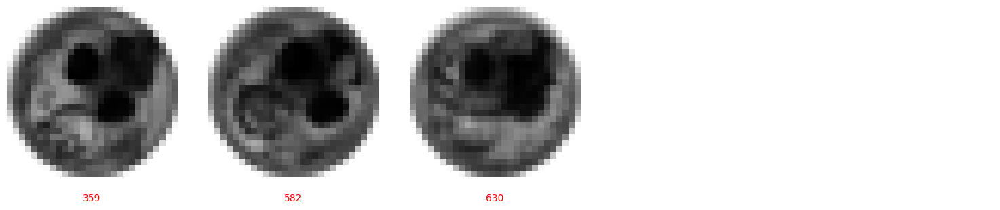

Cluster Label: 112


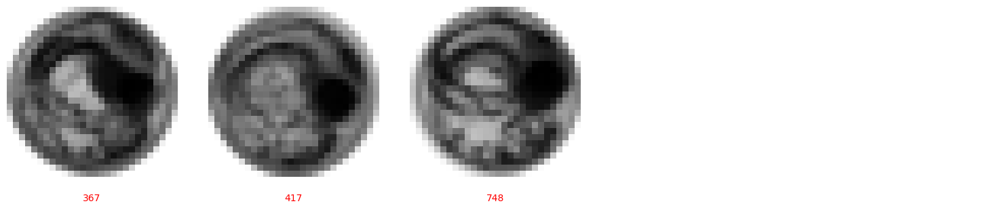

Cluster Label: 113


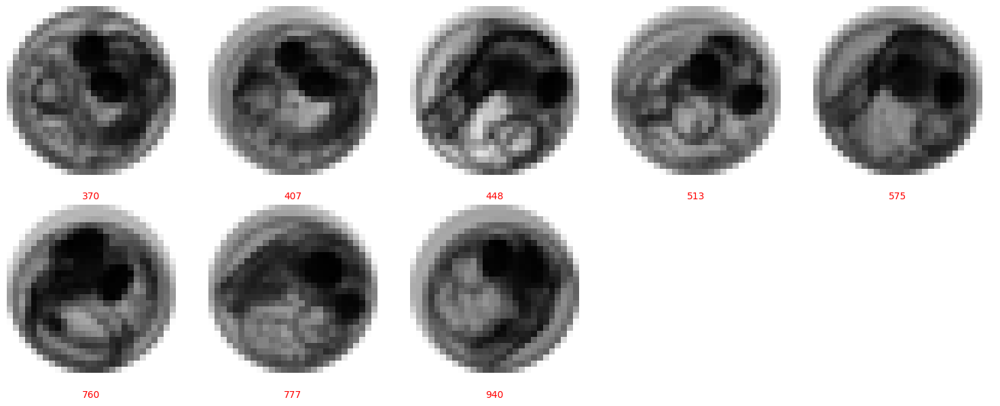

Cluster Label: 114


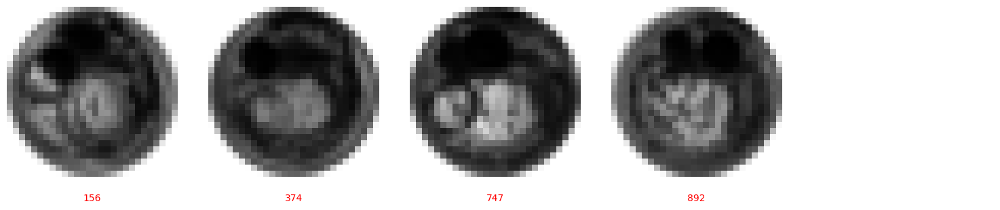

Cluster Label: 115


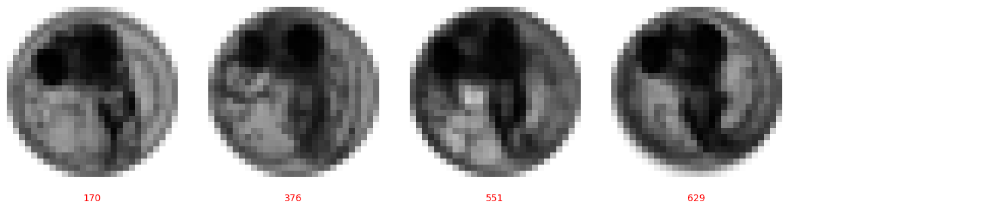

Cluster Label: 116


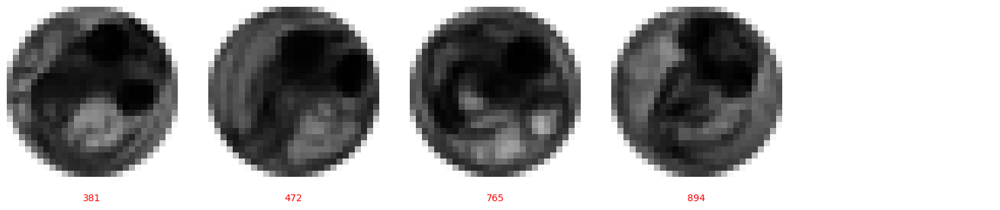

Cluster Label: 117


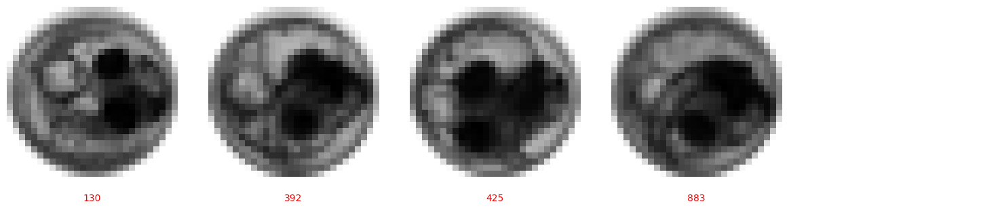

Cluster Label: 118


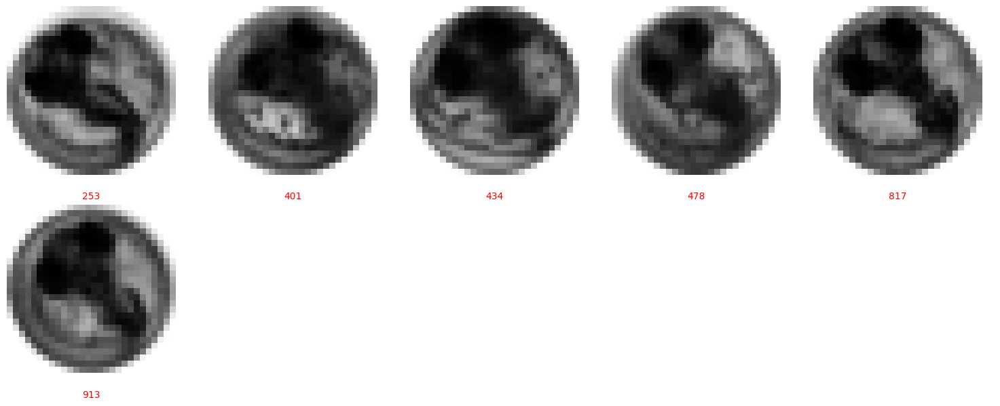

Cluster Label: 119


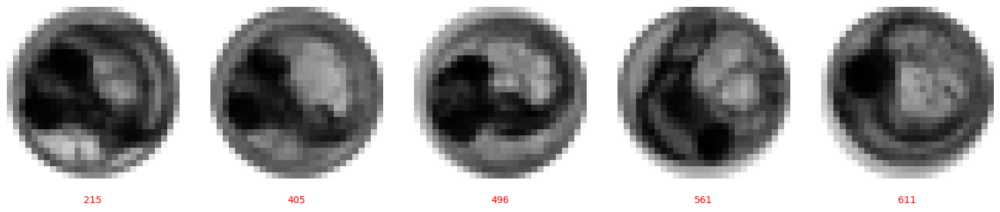

Cluster Label: 120


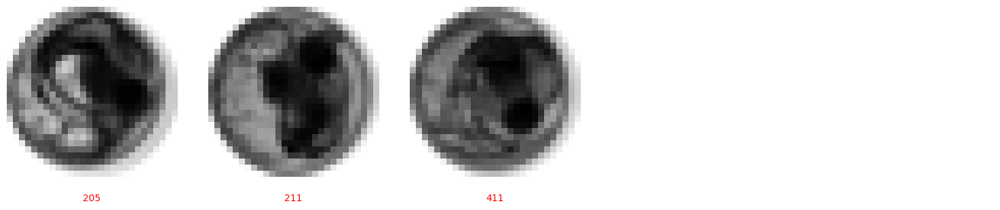

Cluster Label: 121


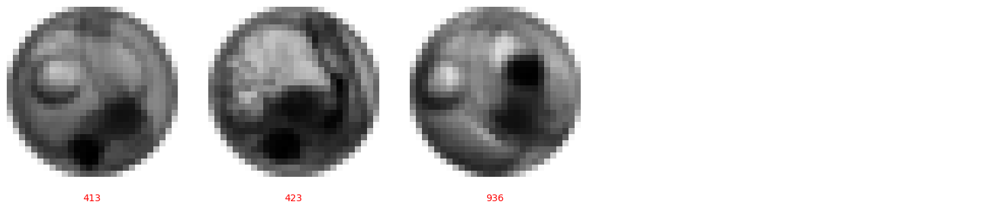

Cluster Label: 122


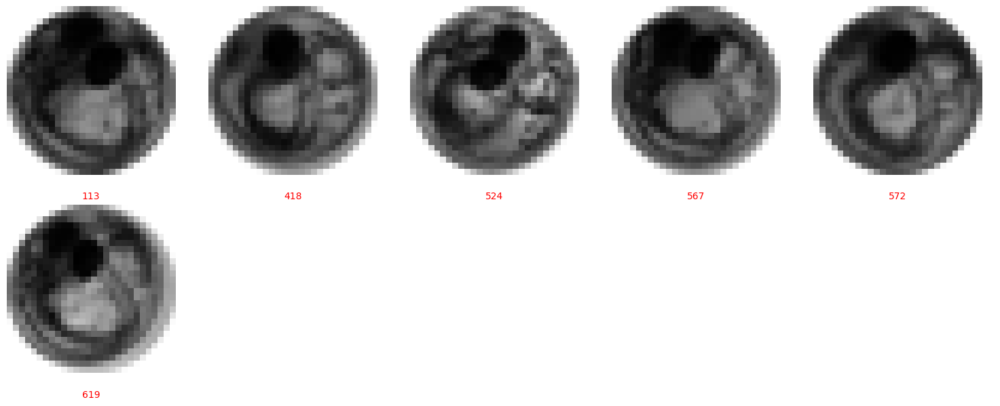

Cluster Label: 123


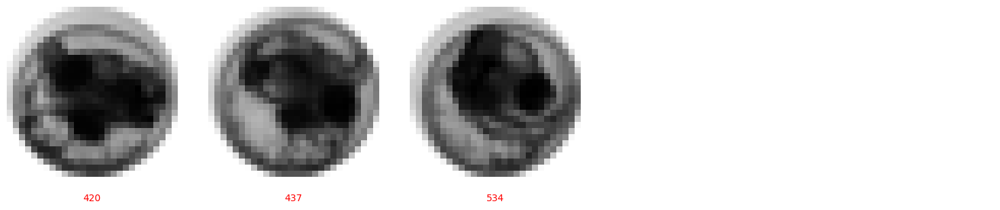

Cluster Label: 124


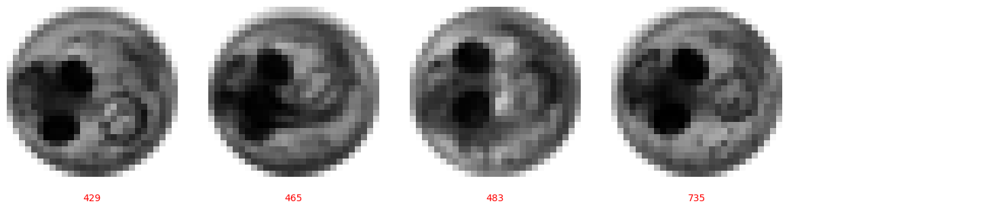

Cluster Label: 125


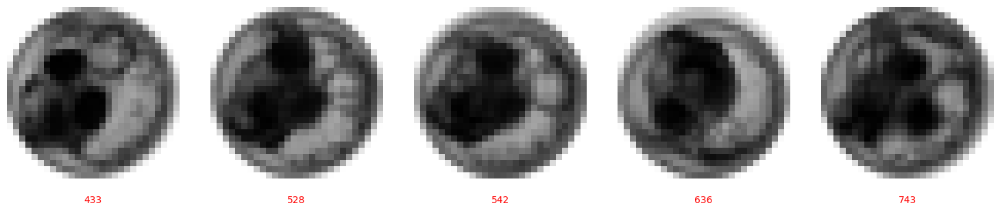

Cluster Label: 126


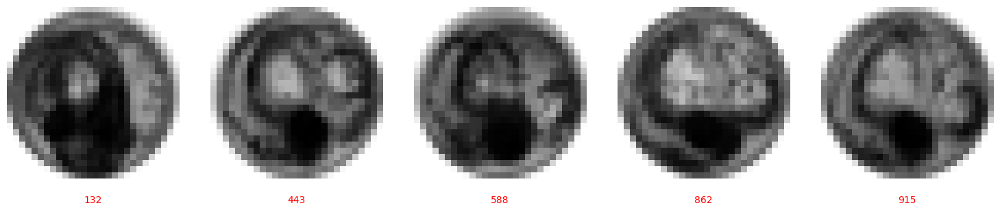

Cluster Label: 127


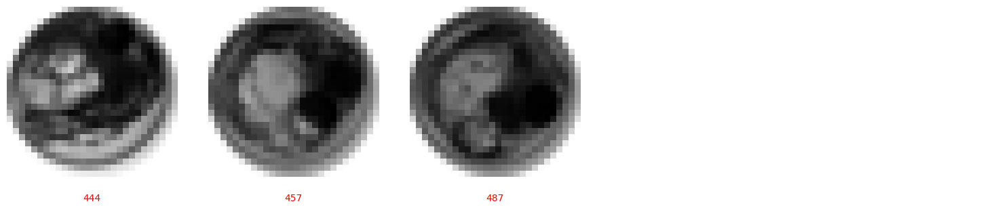

Cluster Label: 128


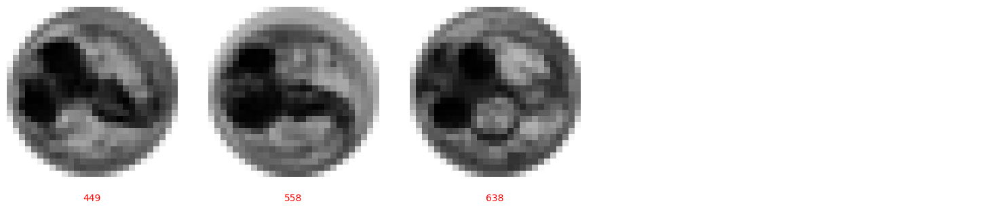

Cluster Label: 129


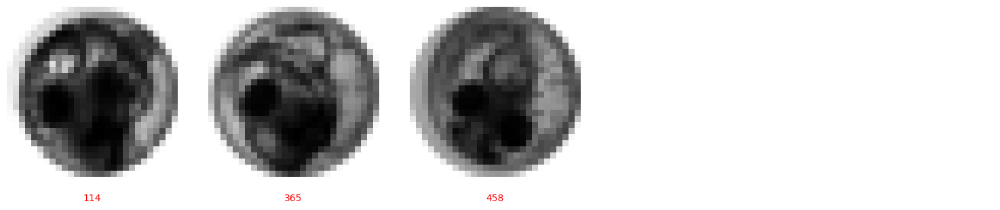

Cluster Label: 130


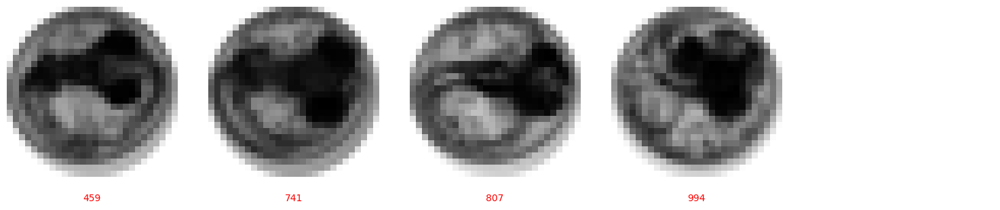

Cluster Label: 131


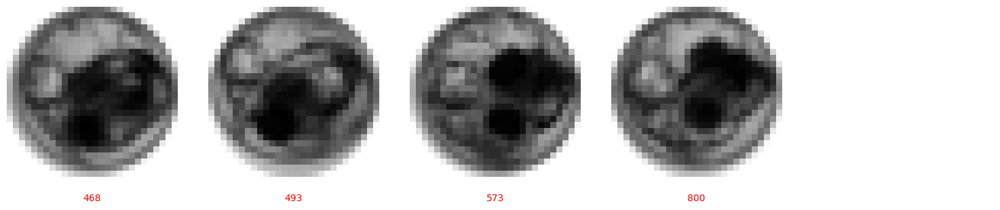

Cluster Label: 132


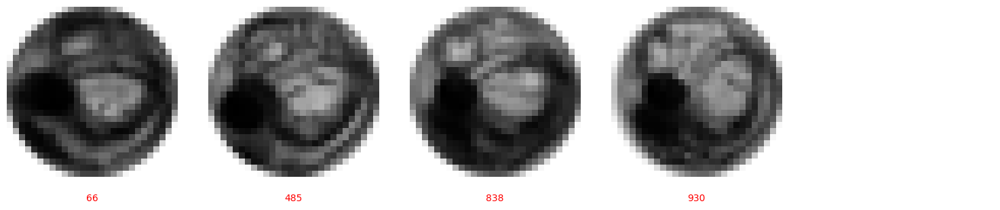

Cluster Label: 133


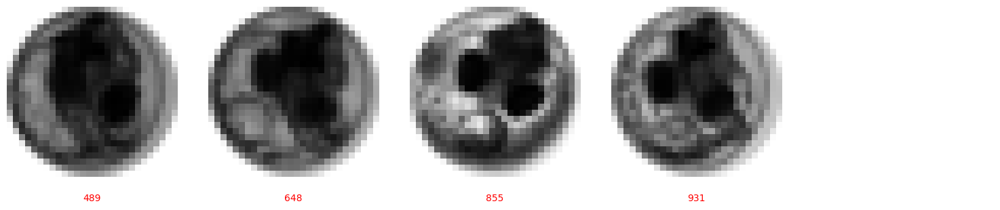

Cluster Label: 134


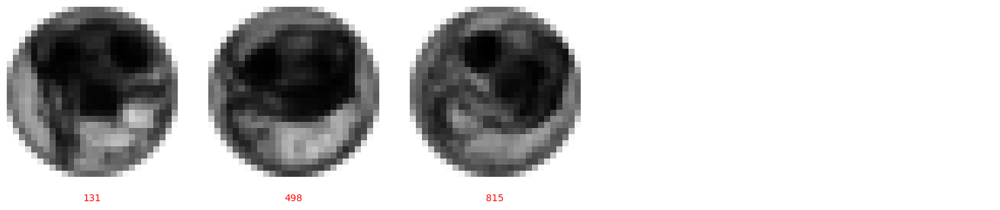

Cluster Label: 135


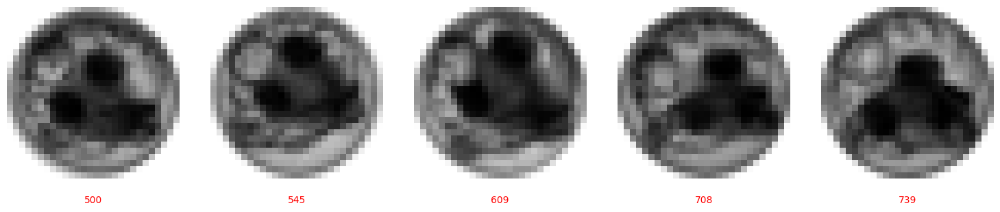

Cluster Label: 136


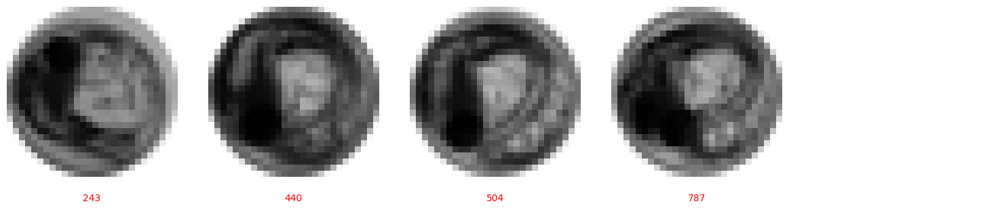

Cluster Label: 137


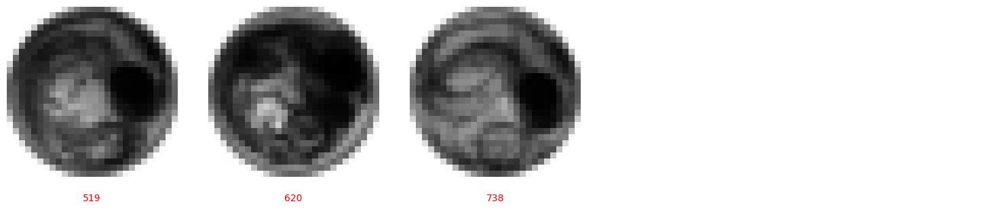

Cluster Label: 138


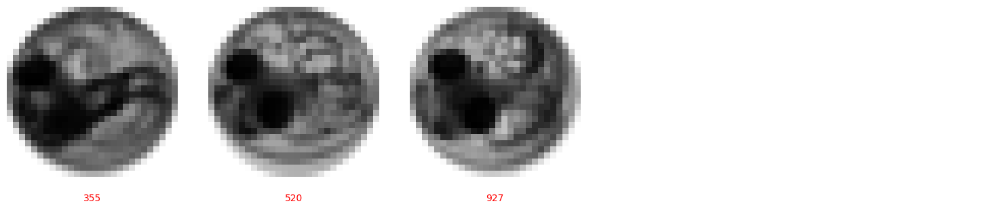

Cluster Label: 139


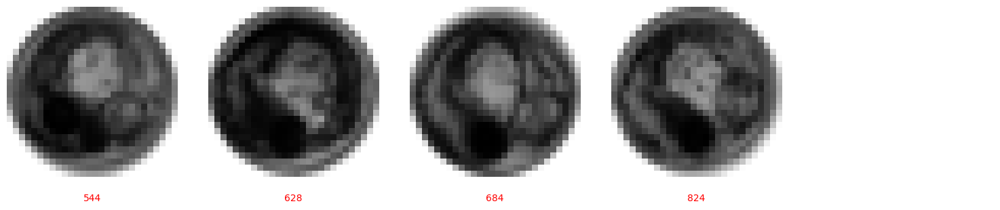

Cluster Label: 140


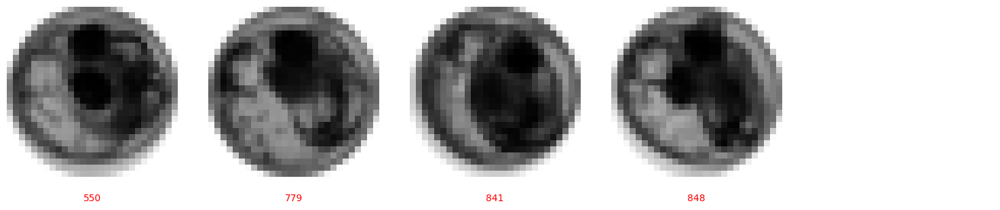

Cluster Label: 141


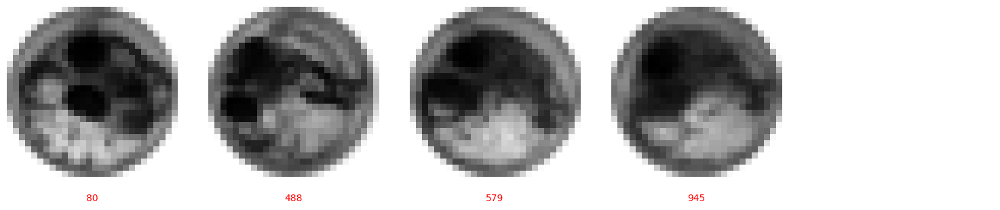

Cluster Label: 142


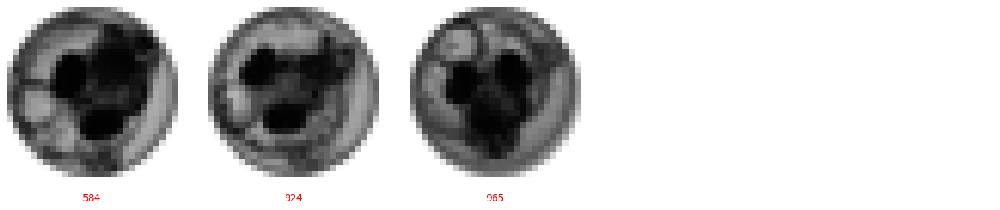

Cluster Label: 143


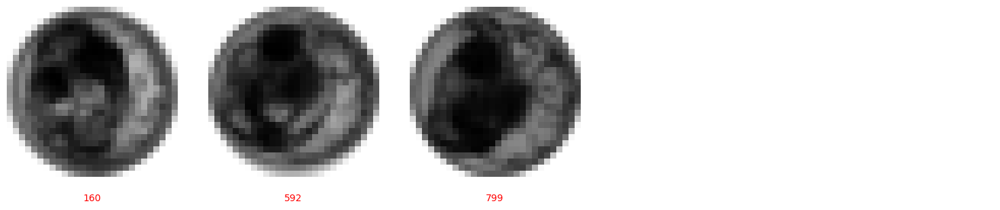

Cluster Label: 144


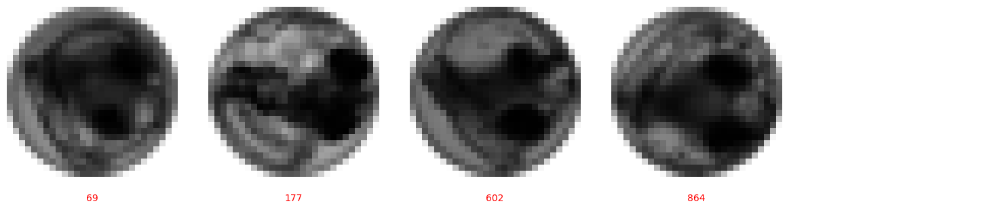

Cluster Label: 145


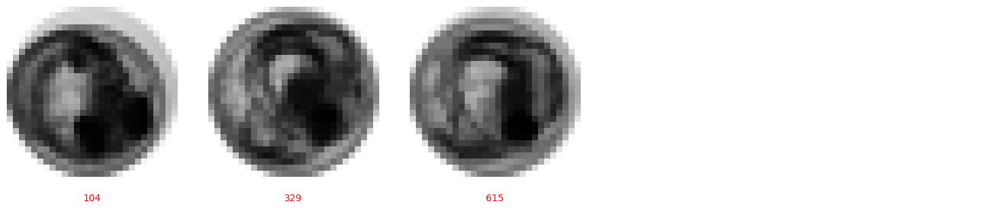

Cluster Label: 146


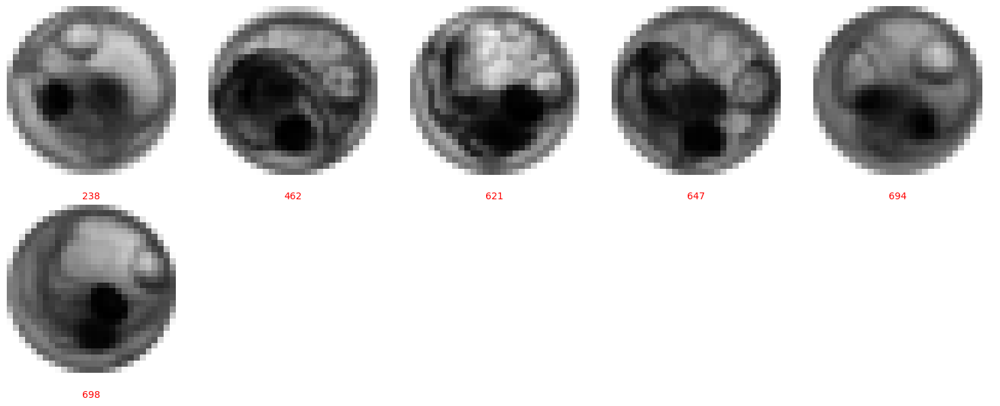

Cluster Label: 147


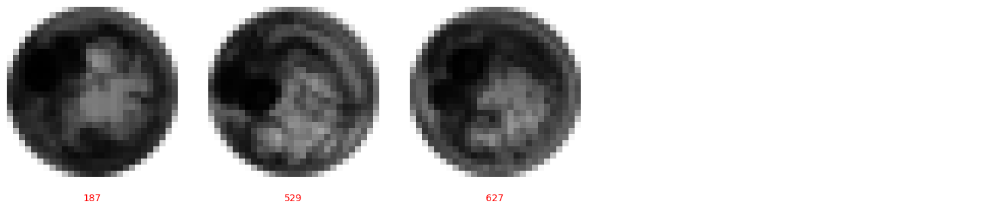

Cluster Label: 148


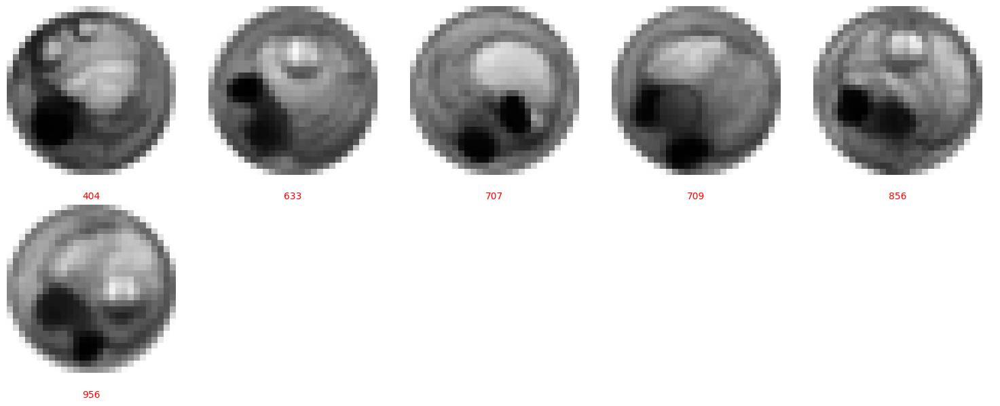

Cluster Label: 149


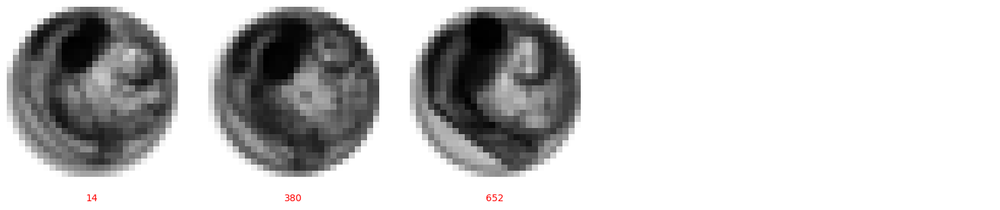

Cluster Label: 150


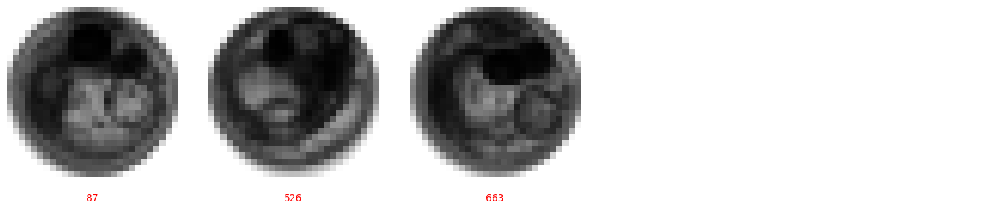

Cluster Label: 151


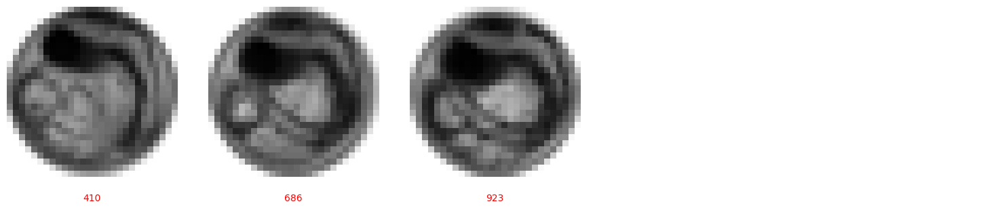

Cluster Label: 152


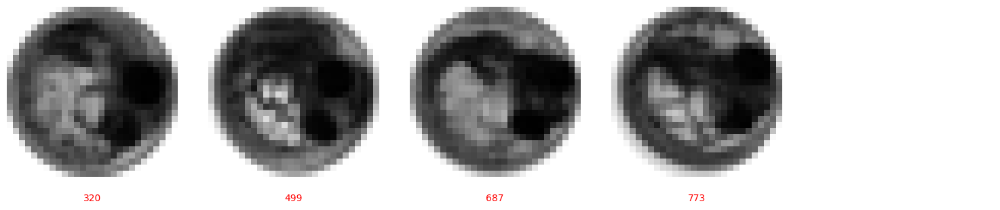

Cluster Label: 153


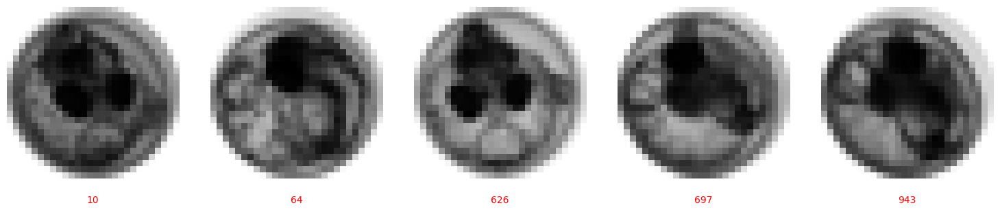

Cluster Label: 154


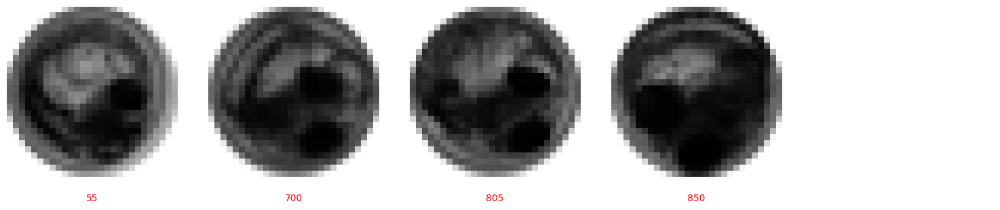

Cluster Label: 155


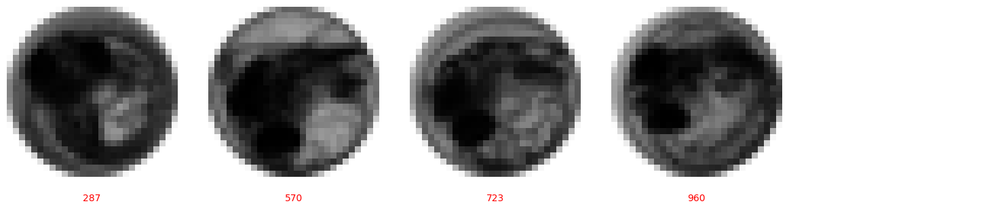

Cluster Label: 156


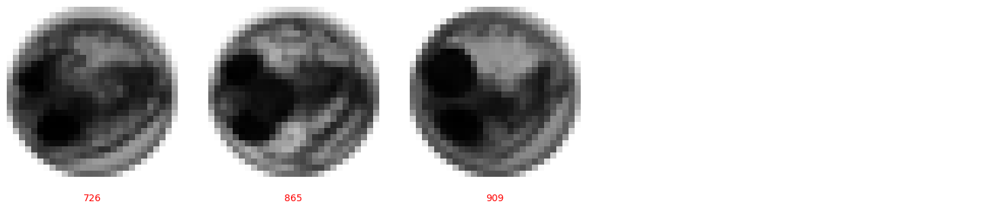

Cluster Label: 157


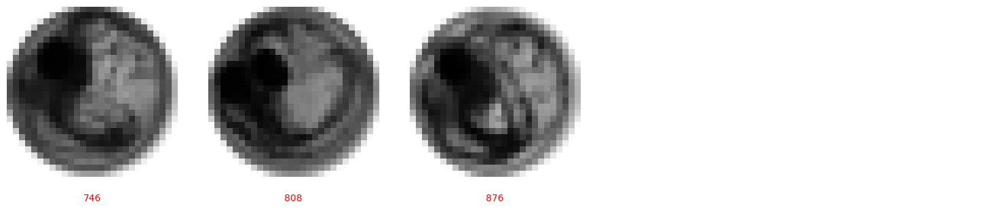

Cluster Label: 158


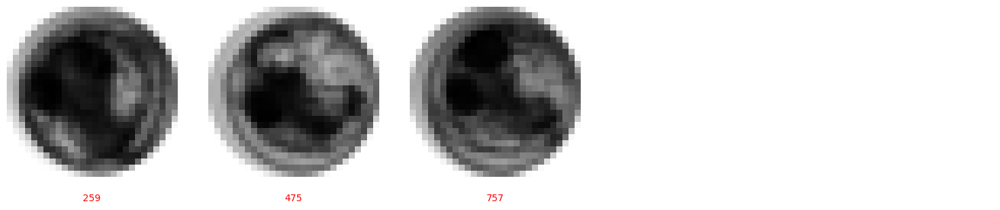

Cluster Label: 159


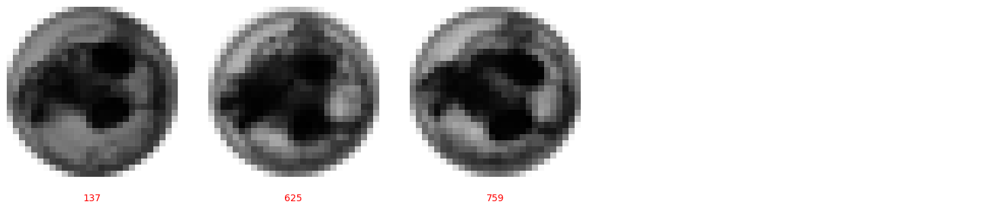

Cluster Label: 160


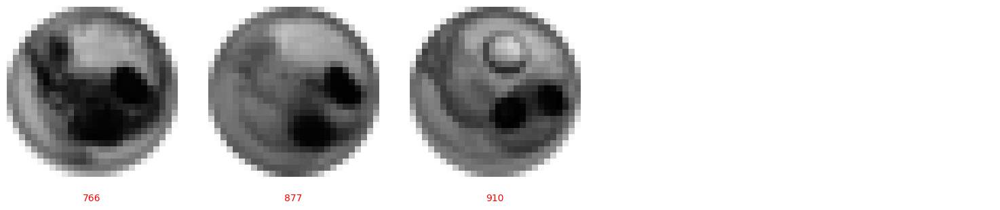

Cluster Label: 161


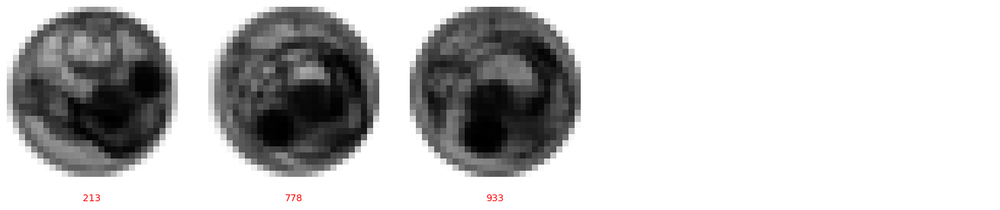

Cluster Label: 162


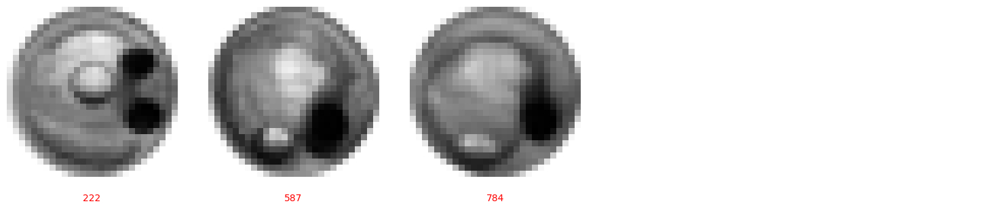

Cluster Label: 163


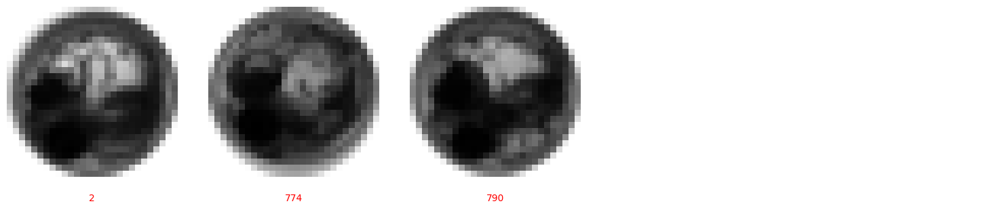

Cluster Label: 164


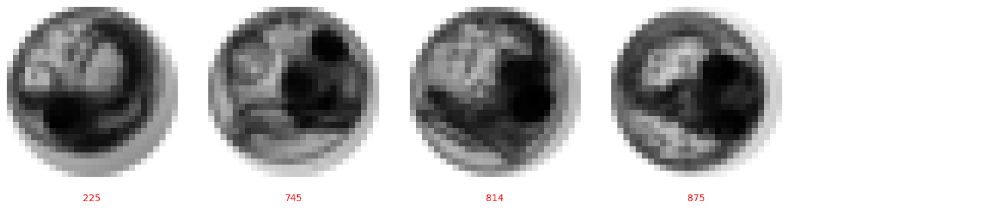

Cluster Label: 165


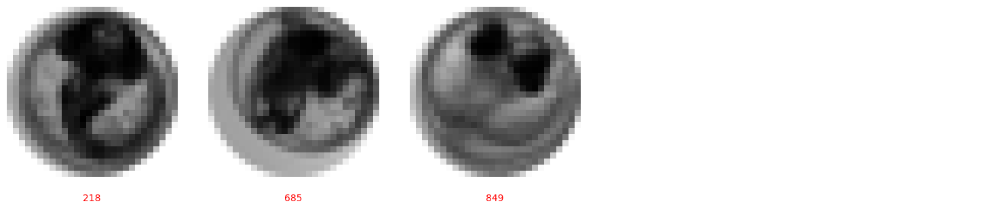

Cluster Label: 166


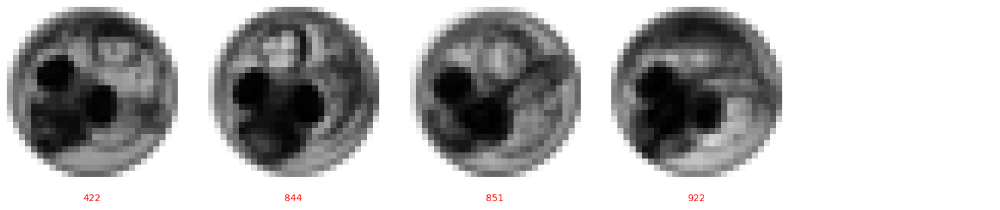

Cluster Label: 167


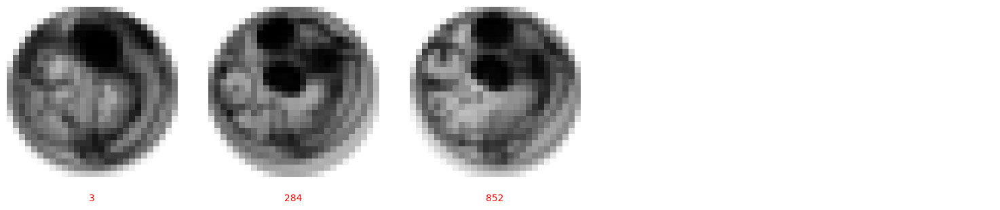

Cluster Label: 168


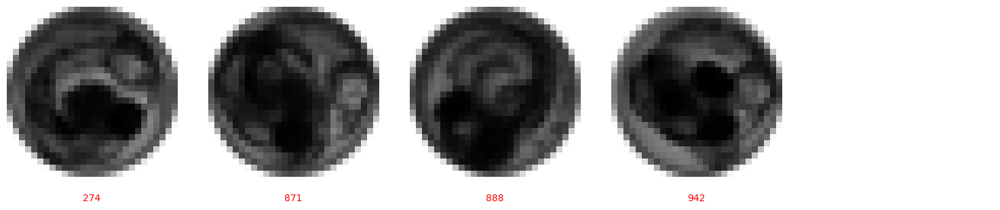

Cluster Label: 169


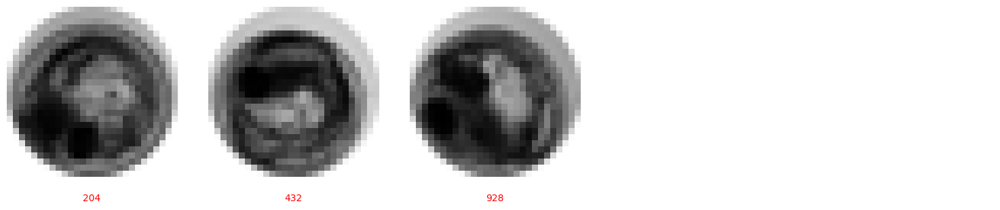

Cluster Label: 170


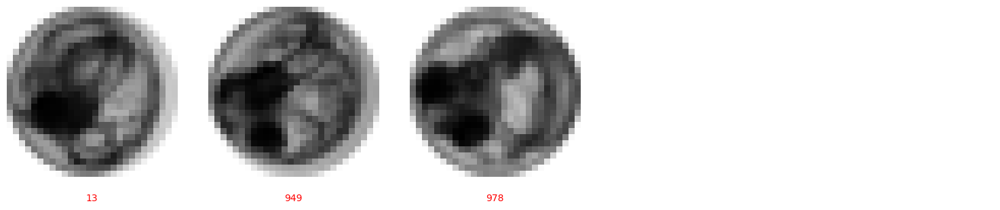

Cluster Label: 171


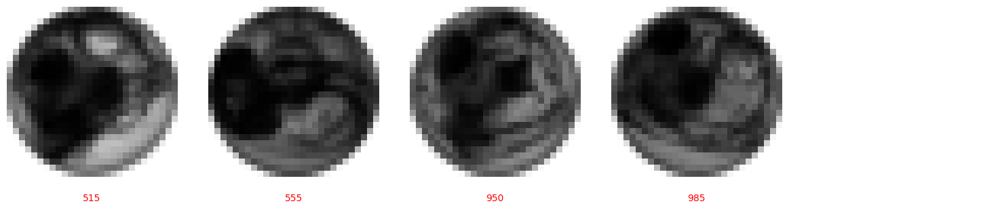

Cluster Label: 172


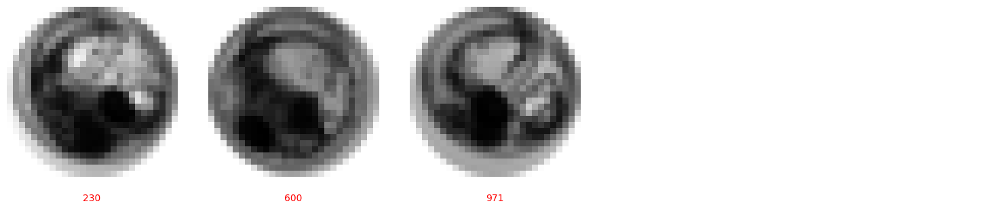

Cluster Label: 173


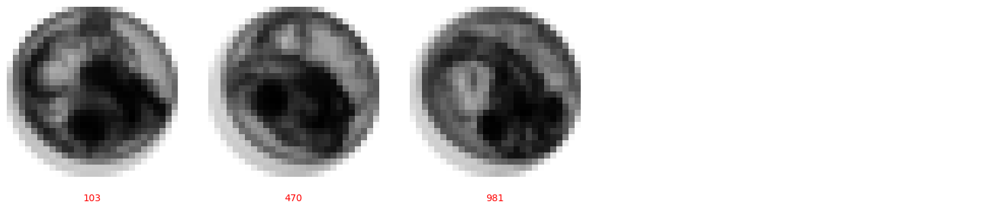

Cluster Label: 174


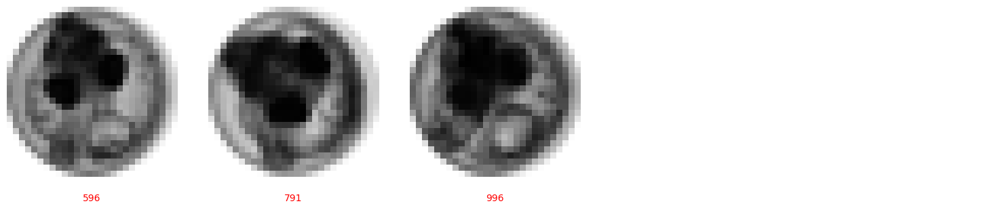

Cluster Label: 175


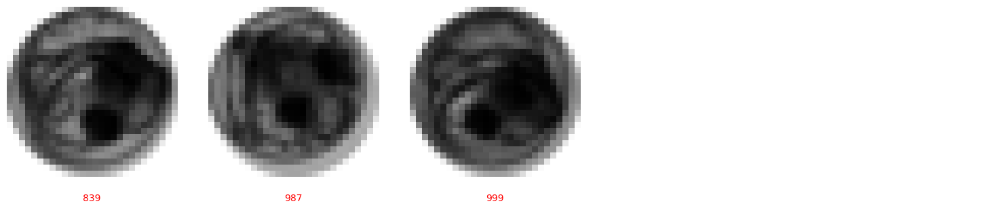

Cluster Label: -1


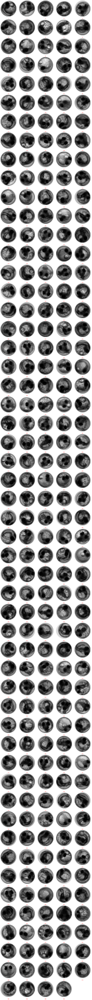

In [873]:
import matplotlib.pyplot as plt
import math

for cluster_label in set(labels):
    print(f"Cluster Label: {cluster_label}")

    # Encontrar os índices das imagens que pertencem a esse cluster
    cluster_indices = np.where(labels == cluster_label)[0]

    # Selecionar as imagens do tensor original usando os índices encontrados
    selected_images = tensor_images_few[cluster_indices]

    # Definir quantas imagens por linha e calcular o número necessário de linhas
    images_per_row = 5
    num_images = len(selected_images)
    num_rows = math.ceil(num_images / images_per_row)

    # Criar uma figura com subplots
    fig, axes = plt.subplots(num_rows, images_per_row, figsize=(15, 3 * num_rows))

    # Achatar a array de eixos para facilitar o mapeamento da imagem para o subplot
    axes_flat = axes.flatten()

    # Loop para plotar cada imagem no subplot correspondente e adicionar o índice
    for idx, (image, ax) in enumerate(zip(selected_images, axes_flat)):
        ax.imshow(image.reshape(H, W), cmap='gray')
        ax.axis('off')
        # Obter o índice real no tensor principal e colocá-lo abaixo da imagem
        real_index = cluster_indices[idx]
        ax.text(0.5, -0.1, str(real_index), transform=ax.transAxes, ha='center', va='top', fontsize=10, color='red')

    # Se houver menos imagens do que espaços de subplot, esconda os subplots extras
    for j in range(idx + 1, len(axes_flat)):
        axes_flat[j].axis('off')

    plt.tight_layout()
    plt.show()




In [874]:
quanti_non_rotated

[4.1695046106974285,
 3.849669933319092,
 3.8653213523683094,
 3.364826226234436,
 3.9709751129150392,
 4.235975617454166,
 4.2067651862189885,
 4.011732037862142,
 3.805865240097046,
 3.9262941201527912,
 3.9789090209537084,
 3.3377378463745115,
 3.7273890177408853,
 3.466623830795288,
 4.129776541392008,
 3.307814431190491,
 4.1322774432954335,
 3.840697503089905,
 3.4470038572947184,
 3.714277310030801,
 3.690893840789795,
 3.555380392074585,
 3.811819110597883,
 3.6044990539550783,
 3.774034023284912,
 3.4503253698349,
 3.6683406697379217,
 3.5767053604125976,
 3.293194055557251,
 3.0957783699035644,
 3.604331874847412,
 3.8098168849945067,
 3.2670644998550413,
 3.9767600854237872,
 3.8465888023376467,
 4.120161342620849,
 3.5506494499388195,
 3.7706713676452637,
 3.479461654027303,
 3.712545466423035,
 4.284987688064575,
 3.8070611476898195,
 3.5942482233047484,
 3.7341600894927978,
 3.579961291381291,
 3.688369035720825,
 3.319520926475525,
 4.0297383785247805,
 4.017052578926086

In [875]:
quanti_rotated

[]

In [876]:
bbbb

NameError: name 'bbbb' is not defined

## **CRVae classes**

In [ ]:
train_loader = init_dataloader(train_data, train_labels, batch_size=100)


In [ ]:
n = 10 # frequency to save weights
in_dim = (28, 28)
# Inicializar a variável que mantém a última época
last_epoch = 0

# Initialize probabilistic VAE model ->
# (coord=0: vanilla VAE
#  coord=1: rotations only
#  coord=2: translations only
#  coord=3: rotations+translations)

crvae = rVAE(in_dim, latent_dim=3, num_classes=10, coord=1, seed=0)
# Initialize SVI trainer
trainer = SVItrainer(crvae)


In [ ]:
import os
import torch

# Caminho para o arquivo de modelo salvo
model_path = '/content/drive/My Drive/model_vae.pth'



# Verificar se o arquivo de modelo salvo existe
if os.path.exists(model_path):
    print("arquivo de treino exists")
    # Carregar o estado salvo
    checkpoint = torch.load(model_path)
    crvae.load_state_dict(checkpoint['model_state_dict'])
    trainer.svi.optim.set_state(checkpoint['optimizer_state_dict'])
    last_epoch = checkpoint['epoch']
    trainer.set_current_epoch(last_epoch)
    print(f"Retomando do treinamento na época {last_epoch}")
else:
    last_epoch = 0
    print("Começando da época 0")

In [ ]:
if os.path.exists(model_path):
  checkpoint = torch.load(model_path)
  last_epoch = checkpoint['epoch']
  print(f"last epoch in file is {last_epoch}")
else:
  last_epoch = 0
  print("starting from epoch 0")
# Train for n epochs:
for e in range(last_epoch + 1, 6000):
    trainer.step(train_loader)
    trainer.print_statistics()
    # Acessar a última perda de treinamento registrada
    current_training_loss = trainer.loss_history["training_loss"][-1]
    writer.add_scalar('Loss/train', current_training_loss, e)
    if (e % n == 0) and (e > 1):  # n é a frequência com que você quer salvar
      print("saving model")
      torch.save({
          'epoch': e,
          'model_state_dict': cvae.state_dict(),
          'optimizer_state_dict': trainer.svi.optim.get_state(),
          'loss': current_training_loss,
          # Salve qualquer outra coisa que você precise
      }, '/content/drive/My Drive/model_vae.pth')

writer.close()

In [ ]:
z_mean, z_sd = crvae.encode(train_data)
for i in range(0, 10):
  print(i)
  crvae.random_samples_from_latent(z_mean, z_sd, 20, train_labels, target_label=None, cmap='gray', label=i)
  print("_______________________________________________________________________")

In [ ]:
z_mean, z_sd = cvae.encode(train_data)

fig = plt.figure(figsize=(15, 6))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(z_mean[:, 0], z_mean[:, 1], z_mean[:, 2], c=train_labels, cmap='jet', s=1)
ax.set_xlabel("$z_1$", fontsize=14)
ax.set_ylabel("$z_2$", fontsize=14)
ax.set_zlabel("$z_3$", fontsize=14)

cbar = fig.colorbar(scatter, ax=ax, shrink=0.8)
cbar.set_label("Train labels", fontsize=14)
cbar.ax.tick_params(labelsize=10)

# Ajuste automaticamente os limites dos eixos para se adequarem aos pontos
ax.auto_scale_xyz(z_mean[:, 0], z_mean[:, 1], z_mean[:, 2])

plt.show()

In [ ]:
import plotly.express as px

z_mean, z_sd = cvae.encode(train_data)

# Suponha que z_mean tenha 3 dimensões: z_mean[:, 0], z_mean[:, 1], z_mean[:, 2]
# Vamos usar as dimensões 0, 1 e 2 para o gráfico 3D

fig = px.scatter_3d(x=z_mean[:, 0], y=z_mean[:, 1], z=z_mean[:, 2], color=train_labels, opacity=0.7, size_max=5)
fig.update_layout(scene=dict(aspectmode="cube"))
fig.update_layout(scene=dict(xaxis_title="$z_1$", yaxis_title="$z_2$", zaxis_title="$z_3$"))
fig.show()
